In [3]:
import os
os.chdir('mmpose')

In [4]:
!python tools/misc/publish_model.py \
        work_dirs/rtmpose-s-Dog_hip_center/epoch_200.pth \
        checkpoint/center_epoch_100.pth

07/14 23:38:16 - mmengine - INFO - Key `message_hub` will be removed because it is not in save_keys. If you want to keep it, please set --save-keys.
07/14 23:38:16 - mmengine - INFO - Key `optimizer` will be removed because it is not in save_keys. If you want to keep it, please set --save-keys.
07/14 23:38:16 - mmengine - INFO - Key `param_schedulers` will be removed because it is not in save_keys. If you want to keep it, please set --save-keys.
07/14 23:38:16 - mmengine - INFO - Key `ema_state_dict` will be removed because it is not in save_keys. If you want to keep it, please set --save-keys.


In [5]:
!python tools/misc/publish_model.py \
        work_dirs/rtmpose-s-Dog_hip_head/epoch_200.pth \
        checkpoint/head_epoch_200.pth

07/14 23:38:18 - mmengine - INFO - Key `message_hub` will be removed because it is not in save_keys. If you want to keep it, please set --save-keys.
07/14 23:38:18 - mmengine - INFO - Key `optimizer` will be removed because it is not in save_keys. If you want to keep it, please set --save-keys.
07/14 23:38:18 - mmengine - INFO - Key `param_schedulers` will be removed because it is not in save_keys. If you want to keep it, please set --save-keys.
07/14 23:38:18 - mmengine - INFO - Key `ema_state_dict` will be removed because it is not in save_keys. If you want to keep it, please set --save-keys.


In [2]:
import cv2
import numpy as np
from PIL import Image

import matplotlib.pyplot as plt
%matplotlib inline
import scipy
import pandas as pd

import torch

import mmcv
from mmcv import imread
import mmengine
from mmengine.registry import init_default_scope

from mmpose.apis import inference_topdown
from mmpose.apis import init_model as init_pose_estimator
from mmpose.evaluation.functional import nms
from mmpose.registry import VISUALIZERS
from mmpose.structures import merge_data_samples
import matplotlib.patches as patches

from mmdet.apis import inference_detector, init_detector



In [3]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print('device', device)

device cuda:0


In [4]:
# rtmdet
detector = init_detector(
    '/home/featurize/work/mmdetection/data/rtmdet_dog_hip_center.py',
    
    '/home/featurize/work/mmdetection/checkpoint/rtmdet_dog_hip_center_175-fb9c4177.pth',
    device=device
)

Loads checkpoint by local backend from path: /home/featurize/work/mmdetection/checkpoint/rtmdet_dog_hip_center_175-fb9c4177.pth


In [ ]:
# RTMDet 
#detector = init_detector(
#    'data/rtmdet_tiny_triangle.py',
#    'checkpoint/rtmdet_tiny_triangle_epoch_200_202305120847-3cd02a8f.pth',
#    device=device
#)

In [5]:
pose_estimator = init_pose_estimator(
    '/home/featurize/work/mmpose/data/rtmpose-s-Dog_hip_center.py',
    '/home/featurize/work/mmpose/checkpoint/center_epoch_100-e250c000_20240714.pth',
    device=device,
    cfg_options={'model': {'test_cfg': {'output_heatmaps': False}}}
)

Loads checkpoint by local backend from path: /home/featurize/work/mmpose/checkpoint/center_epoch_100-e250c000_20240714.pth


In [6]:
# Rtm_det 
detector2 = init_detector(
    '/home/featurize/work/mmdetection/data/rtmdet_dog_hip_head.py',
    
    '/home/featurize/work/mmdetection/checkpoint/rtmdet_dog_hip_head_150-1b40494c.pth',
    device=device
)

07/19 01:04:55 - mmengine - WARNING - The current default scope "mmpose" is not "mmdet", `init_default_scope` will force set the currentdefault scope to "mmdet".
Loads checkpoint by local backend from path: /home/featurize/work/mmdetection/checkpoint/rtmdet_dog_hip_head_150-1b40494c.pth


In [7]:
pose_estimator2 = init_pose_estimator(
    '/home/featurize/work/mmpose/data/rtmpose-s-Dog_hip_head.py',
    '/home/featurize/work/mmpose/checkpoint/head_epoch_200-7001b5a6_20240714.pth',
    device=device,
    cfg_options={'model': {'test_cfg': {'output_heatmaps': False}}}
)

07/19 01:04:56 - mmengine - WARNING - The current default scope "mmdet" is not "mmpose", `init_default_scope` will force set the currentdefault scope to "mmpose".
Loads checkpoint by local backend from path: /home/featurize/work/mmpose/checkpoint/head_epoch_200-7001b5a6_20240714.pth


Processing /home/featurize/work/Dataset2/data/Testing/Images/340563.jpeg
center: [[[221 130]]

 [[525 166]]]
head: [[[517 139]]

 [[241 109]]]


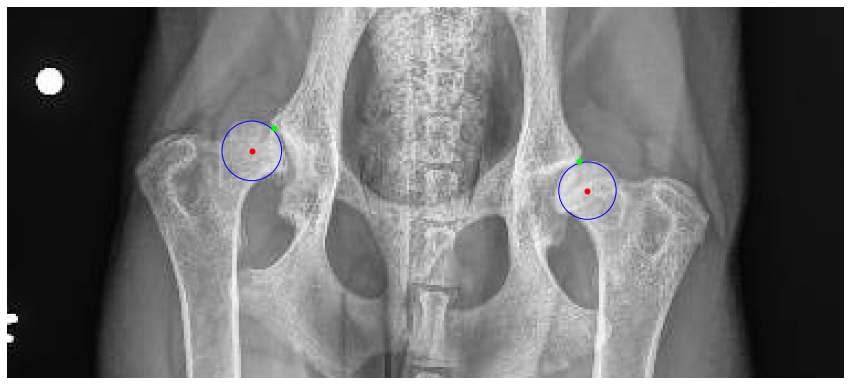

Processing /home/featurize/work/Dataset2/data/Testing/Images/359971.jpeg
center: [[[480 107]]]
head: [[[458 112]]

 [[182 104]]]


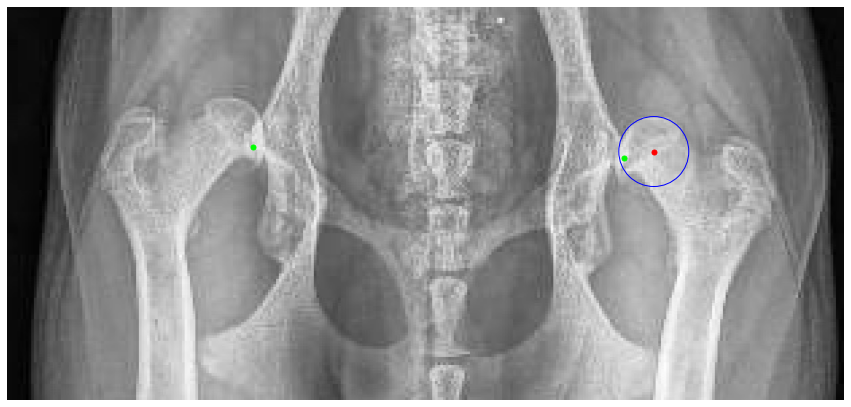

Processing /home/featurize/work/Dataset2/data/Testing/Images/328949.jpeg
center: [[[696 193]]

 [[317 171]]]
head: [[[342 141]]

 [[683 153]]]


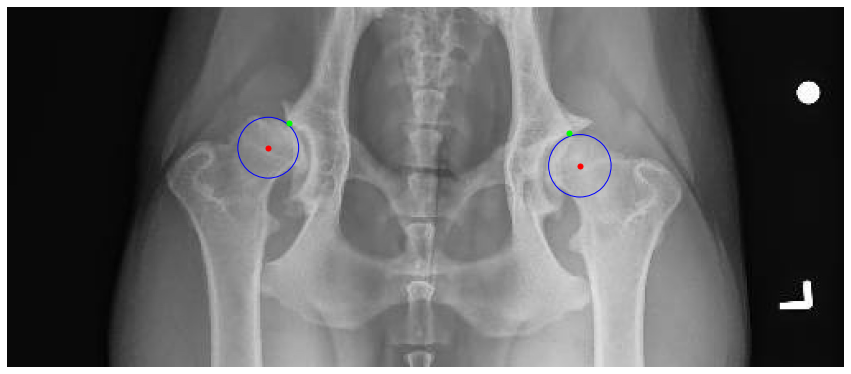

Processing /home/featurize/work/Dataset2/data/Testing/Images/348742.jpeg
center: [[[436 152]]

 [[203 143]]]
head: [[[448 124]]

 [[197 113]]]


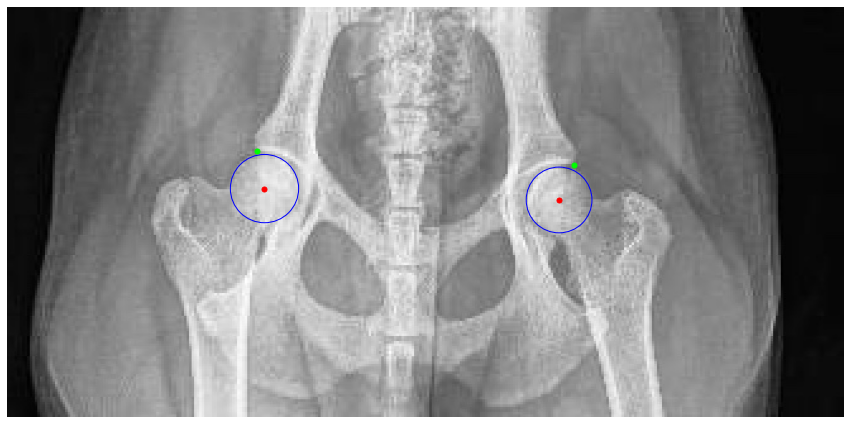

Processing /home/featurize/work/Dataset2/data/Testing/Images/355767.jpeg
center: [[[604 157]]

 [[295 150]]]
head: [[[616 120]]

 [[286 110]]]


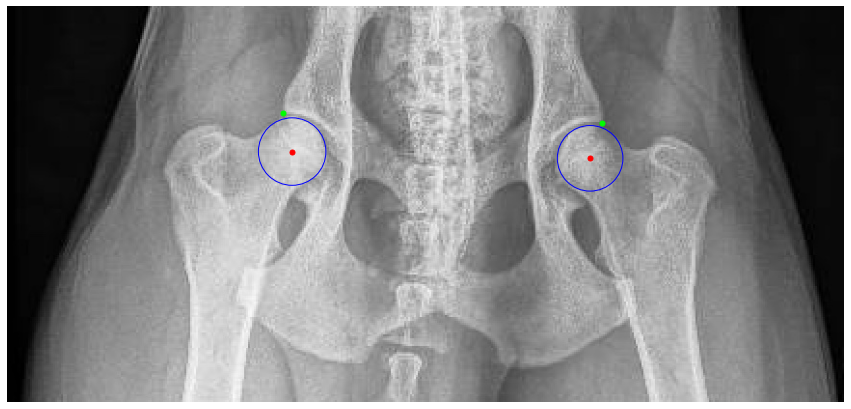

Processing /home/featurize/work/Dataset2/data/Testing/Images/353517.jpeg
center: [[[192 126]]

 [[451 118]]]
head: [[[182  96]]

 [[453  86]]]


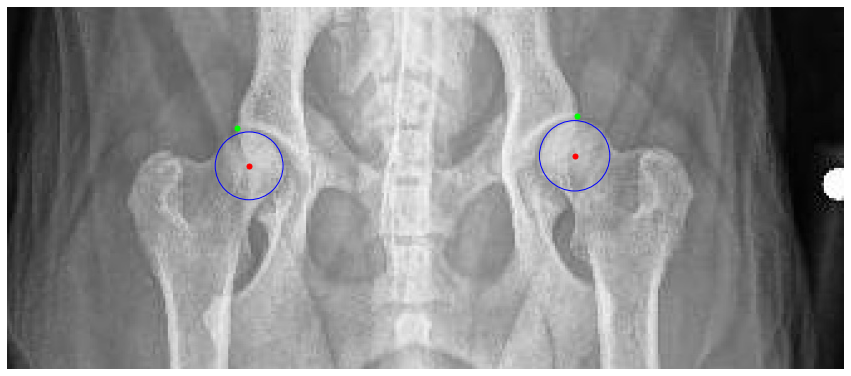

Processing /home/featurize/work/Dataset2/data/Testing/Images/355524.jpeg
center: [[[485 153]]

 [[172 151]]]
head: [[[477 115]]

 [[182 115]]]


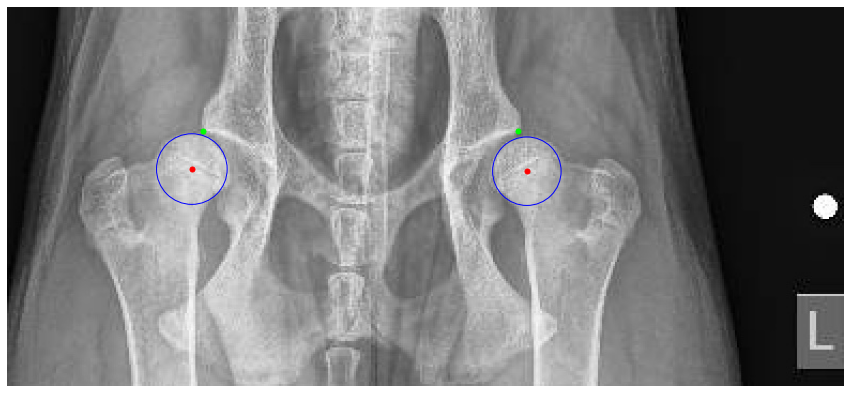

Processing /home/featurize/work/Dataset2/data/Testing/Images/358587.jpeg
center: [[[398  88]]

 [[178  96]]]
head: [[[171  69]]

 [[405  62]]]


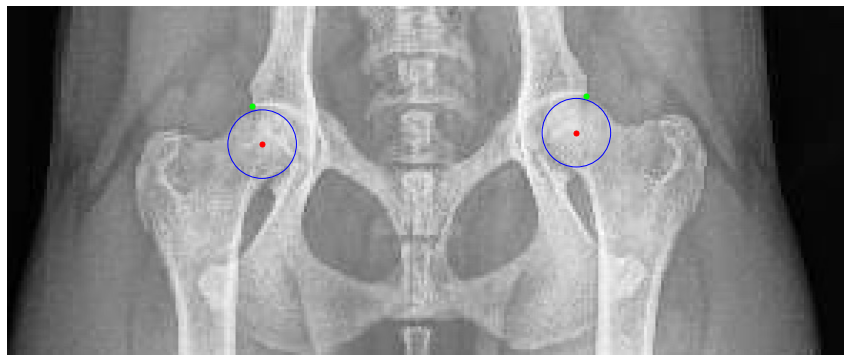

Processing /home/featurize/work/Dataset2/data/Testing/Images/355223.jpeg
center: [[[372 145]]

 [[615 145]]]
head: [[[621 121]]

 [[364 119]]]


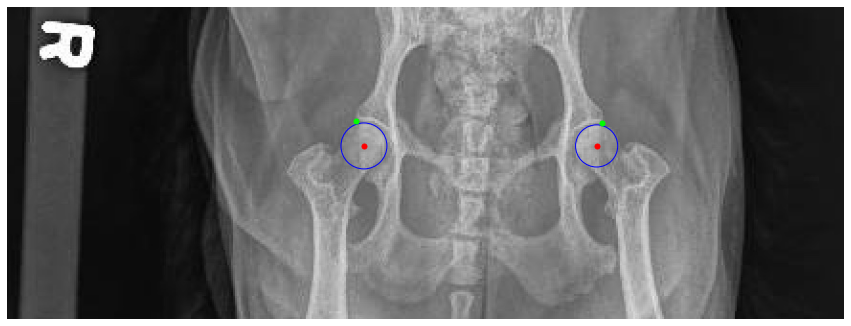

Processing /home/featurize/work/Dataset2/data/Testing/Images/264113.jpeg
center: [[[580 136]]

 [[302 113]]]
head: [[[301  78]]

 [[594 103]]]


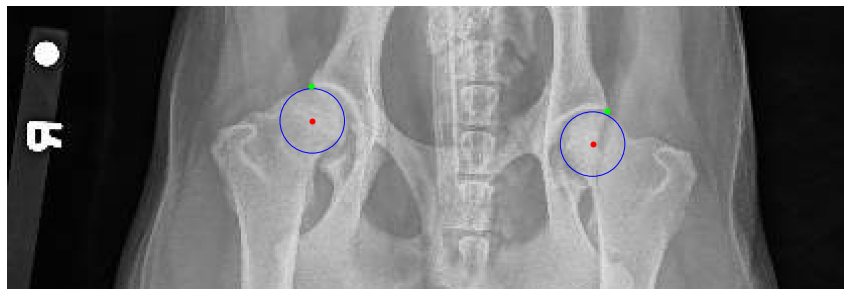

Processing /home/featurize/work/Dataset2/data/Testing/Images/365780.jpeg
center: [[[569 181]]

 [[225 163]]]
head: [[[591 137]]

 [[209 118]]]


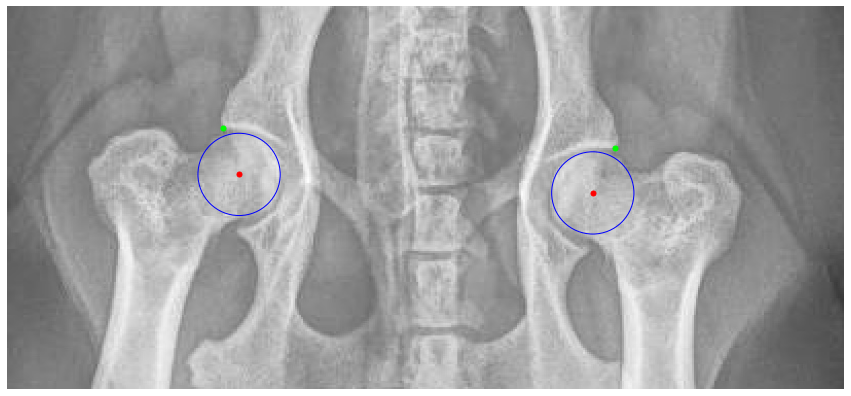

Processing /home/featurize/work/Dataset2/data/Testing/Images/360388.jpeg
center: [[[155  93]]

 [[432 115]]]
head: [[[149  56]]

 [[447  82]]]


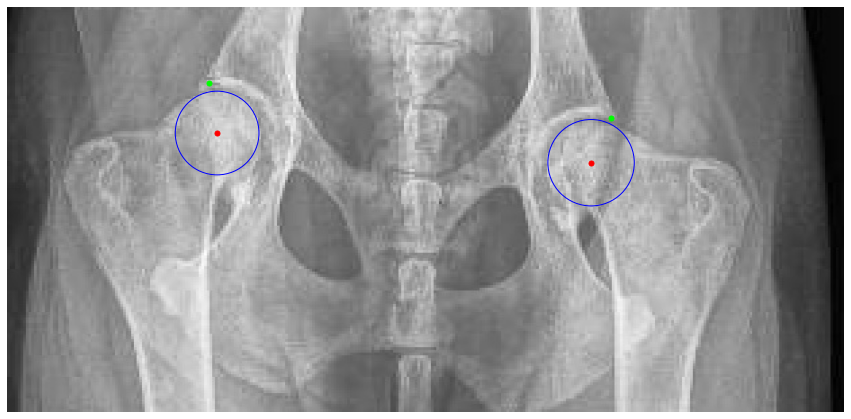

Processing /home/featurize/work/Dataset2/data/Testing/Images/246775.jpeg
center: [[[277  51]]

 [[126  50]]]
head: [[[120  33]]

 [[284  33]]]


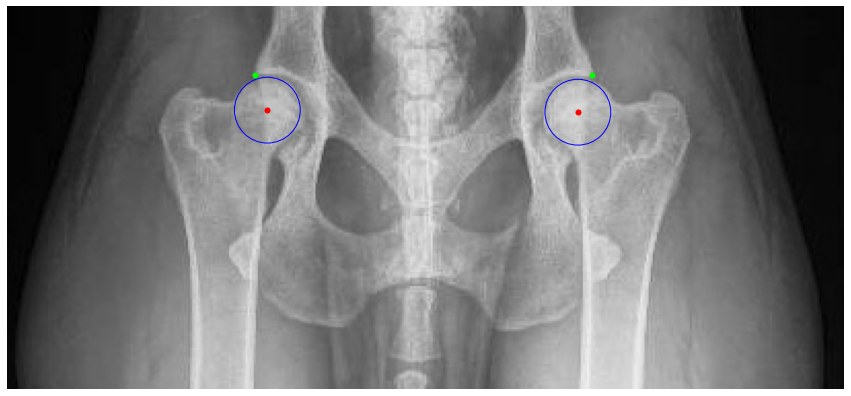

Processing /home/featurize/work/Dataset2/data/Testing/Images/361492.jpeg
center: [[[496 103]]

 [[179 111]]]
head: [[[501  70]]

 [[176  76]]]


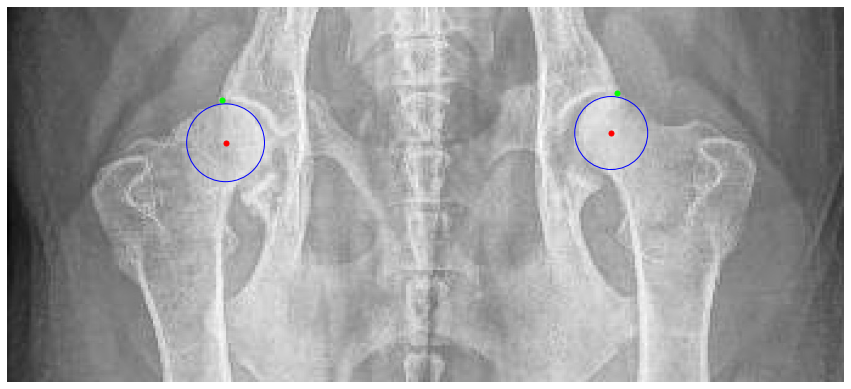

Processing /home/featurize/work/Dataset2/data/Testing/Images/336938.jpeg
center: [[[477 173]]

 [[226 158]]]
head: [[[487 142]]

 [[220 126]]]


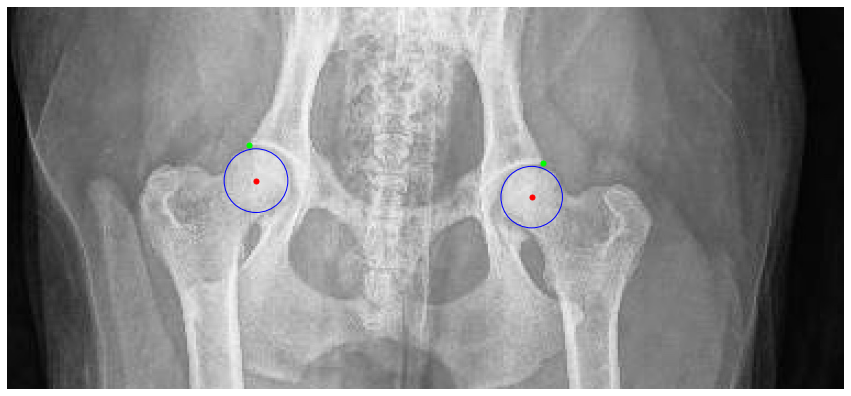

Processing /home/featurize/work/Dataset2/data/Testing/Images/358275.jpeg
center: [[[183 119]]

 [[426 122]]]
head: [[[181  92]]

 [[424  94]]]


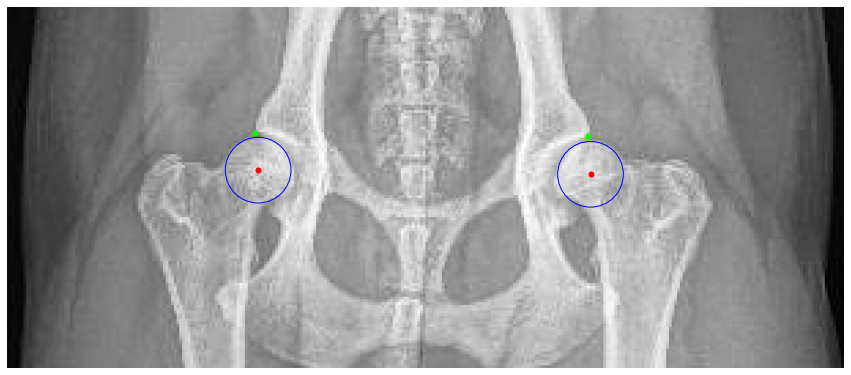

Processing /home/featurize/work/Dataset2/data/Testing/Images/364394.jpeg
center: [[[143  84]]

 [[380  86]]]
head: [[[390  59]]

 [[132  56]]]


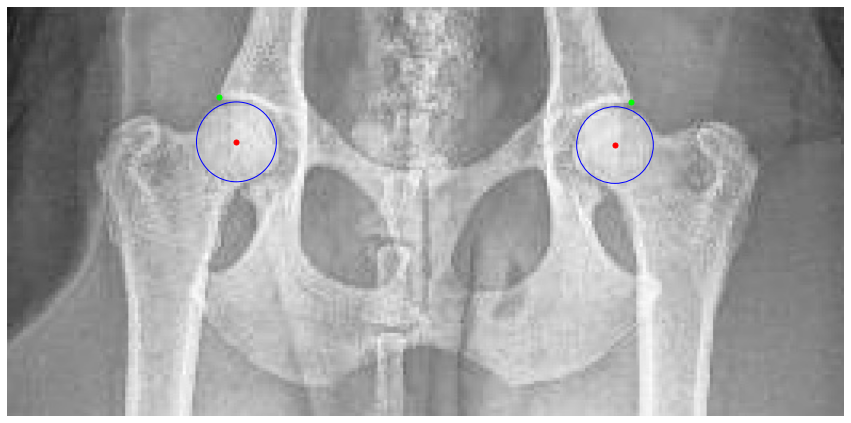

Processing /home/featurize/work/Dataset2/data/Testing/Images/353262.jpg
center: [[[ 483  347]]

 [[1290  211]]]
head: [[[1297  112]]

 [[ 432  256]]]


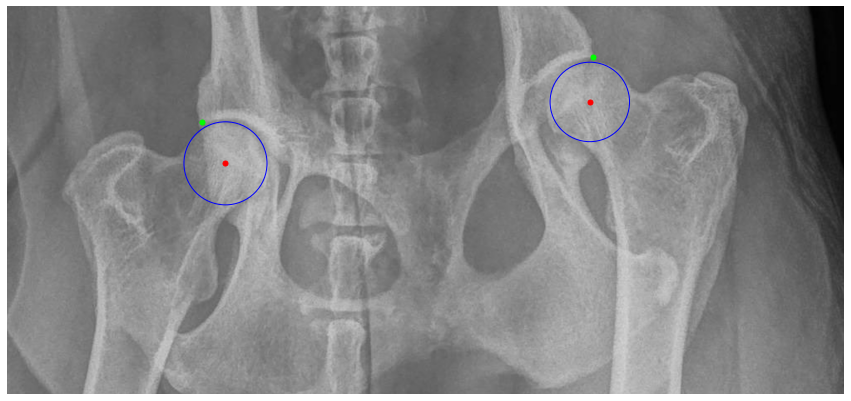

Processing /home/featurize/work/Dataset2/data/Testing/Images/359216.jpeg
center: [[[169 116]]

 [[407 122]]]
head: [[[169  78]]

 [[413  82]]]


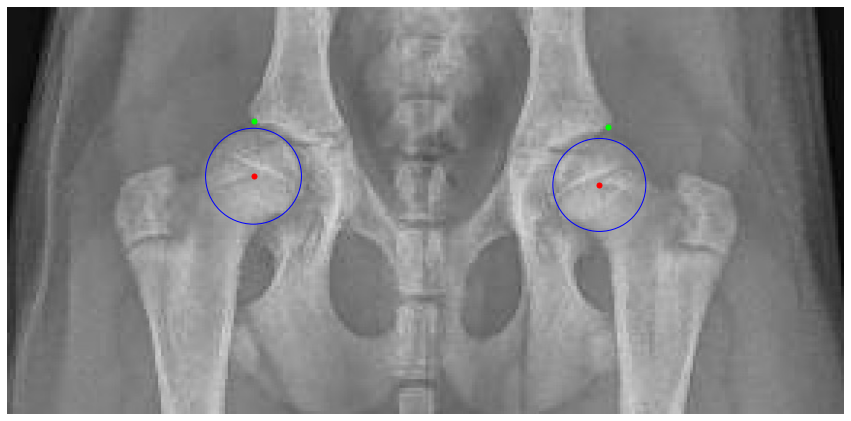

Processing /home/featurize/work/Dataset2/data/Testing/Images/352697.jpeg
center: [[[502 131]]

 [[216 132]]]
head: [[[204 101]]

 [[509 101]]]


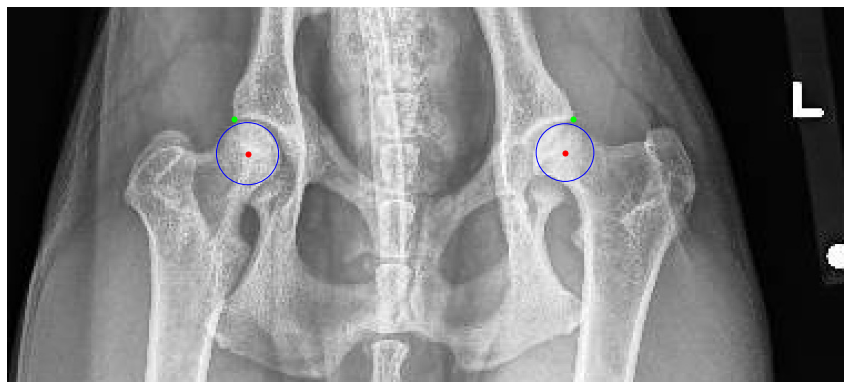

Processing /home/featurize/work/Dataset2/data/Testing/Images/359792.jpeg
center: [[[447 130]]

 [[177 105]]]
head: [[[175  73]]

 [[462 100]]]


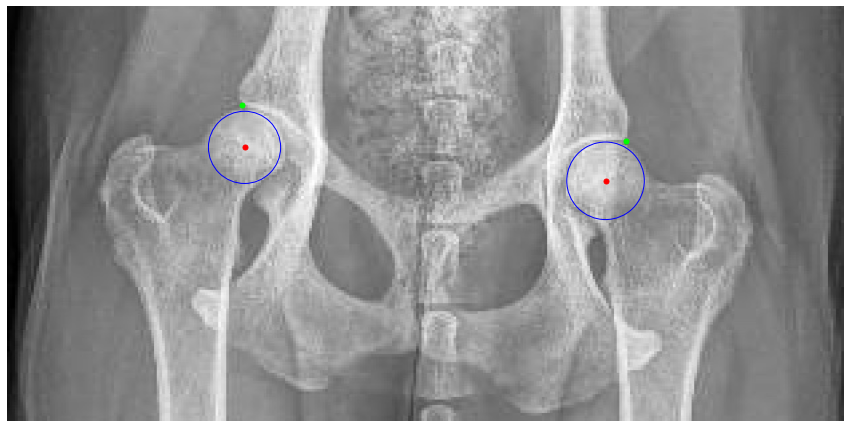

Processing /home/featurize/work/Dataset2/data/Testing/Images/360132.jpeg
center: [[[162  97]]

 [[455 105]]]
head: [[[149  62]]

 [[473  71]]]


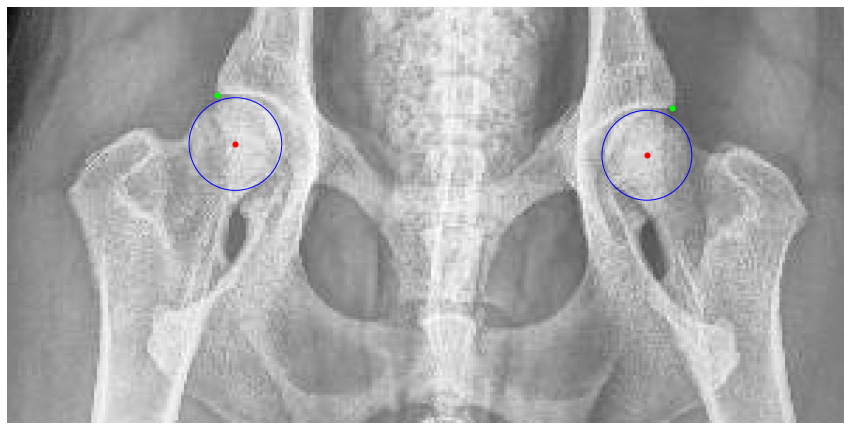

Processing /home/featurize/work/Dataset2/data/Testing/Images/251256.jpg
center: [[[1017  290]]

 [[ 305  205]]]
head: [[[1070  219]]

 [[ 326  119]]]


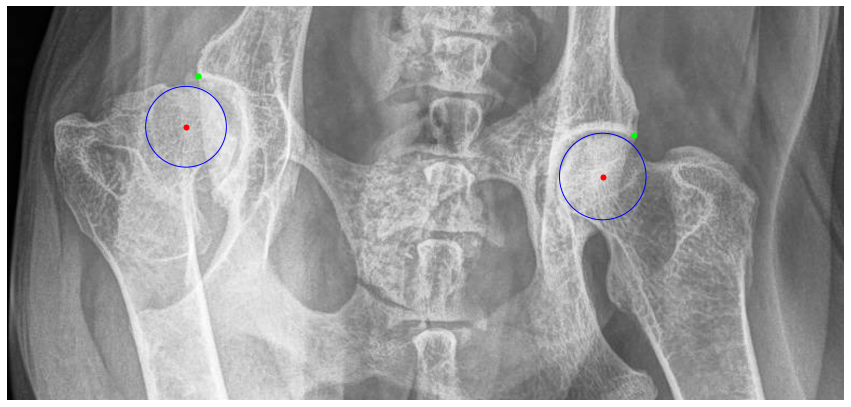

Processing /home/featurize/work/Dataset2/data/Testing/Images/350186.jpeg
center: [[[506 160]]

 [[229 158]]]
head: [[[518 129]]

 [[218 124]]]


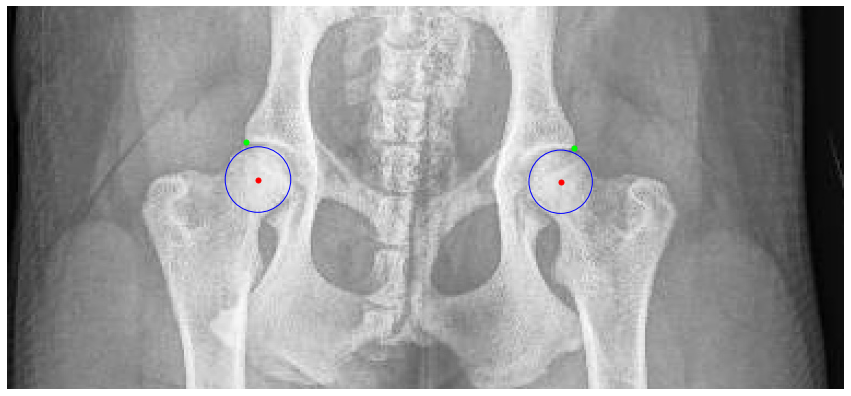

Processing /home/featurize/work/Dataset2/data/Testing/Images/367031.jpg
center: [[[320 224]]

 [[970 214]]]
head: [[[991 135]]

 [[291 147]]]


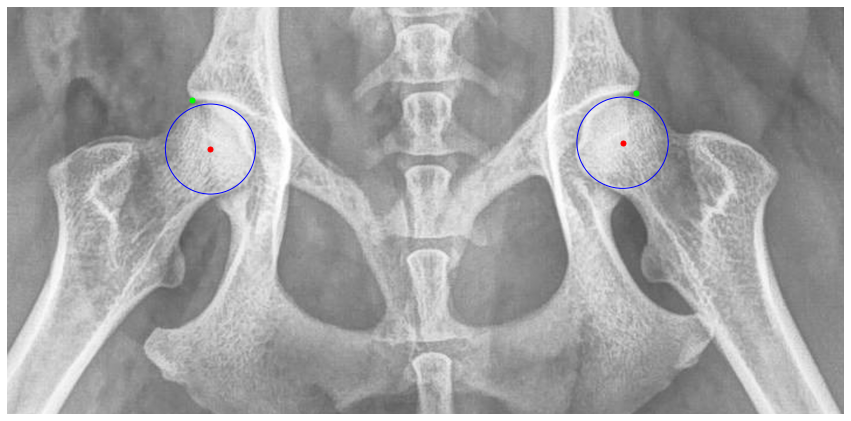

Processing /home/featurize/work/Dataset2/data/Testing/Images/348064.jpeg
center: [[[510 149]]

 [[230 162]]]
head: [[[526 113]]

 [[211 127]]]


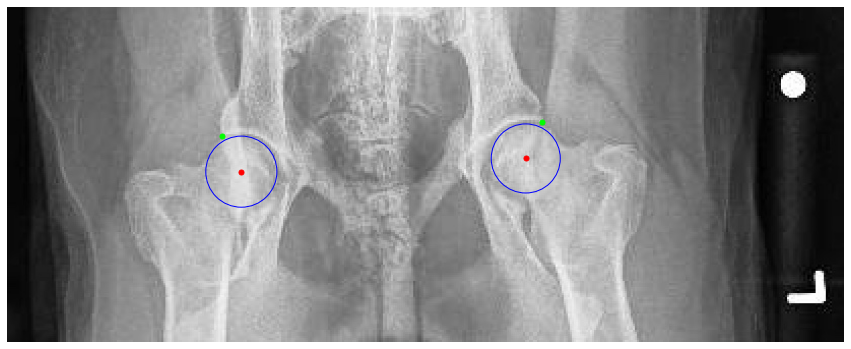

Processing /home/featurize/work/Dataset2/data/Testing/Images/337935.jpeg
center: [[[899 209]]

 [[421 252]]]
head: [[[907 154]]

 [[404 196]]]


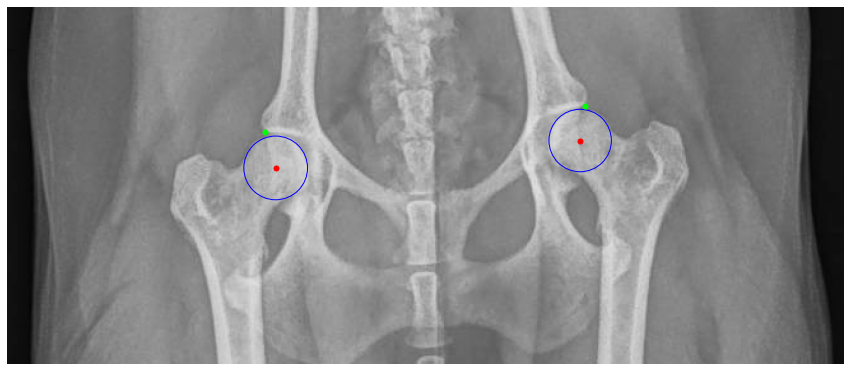

Processing /home/featurize/work/Dataset2/data/Testing/Images/360778.jpeg
center: [[[542 139]]

 [[200 133]]]
head: [[[541 101]]

 [[210  97]]]


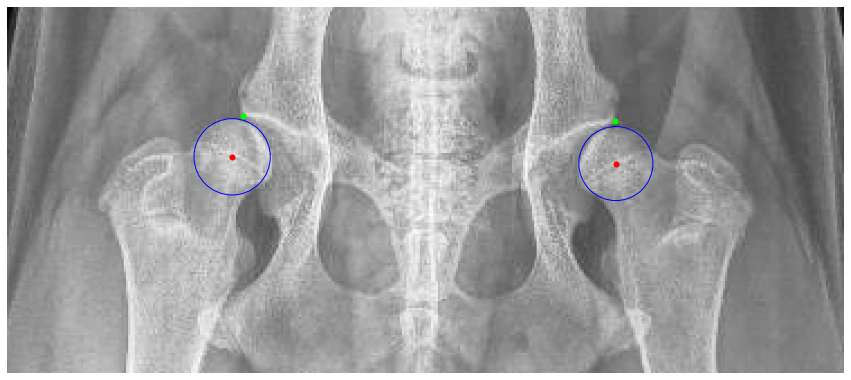

Processing /home/featurize/work/Dataset2/data/Testing/Images/204964.jpg
center: [[[1145  522]]

 [[ 338  340]]]
head: [[[ 326  243]]

 [[1206  432]]]


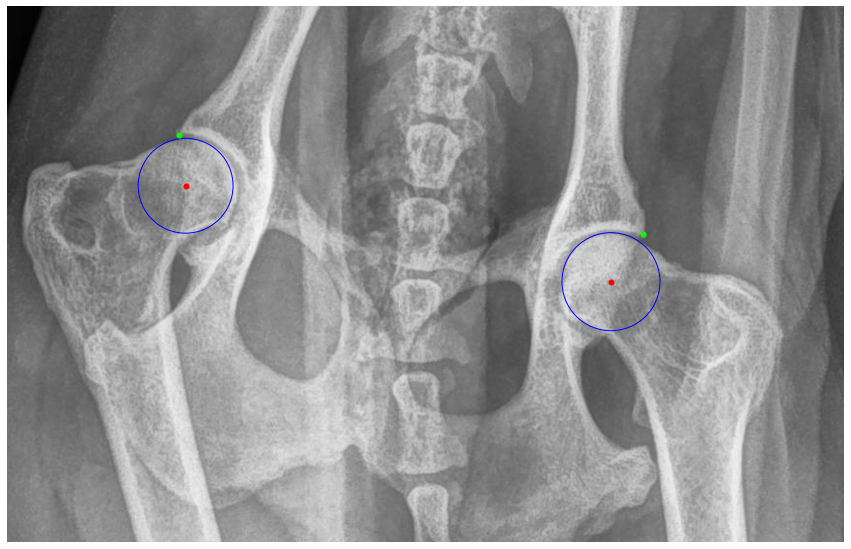

Processing /home/featurize/work/Dataset2/data/Testing/Images/357039.jpeg
center: [[[507 122]]

 [[249 133]]]
head: [[[517  91]]

 [[234 103]]]


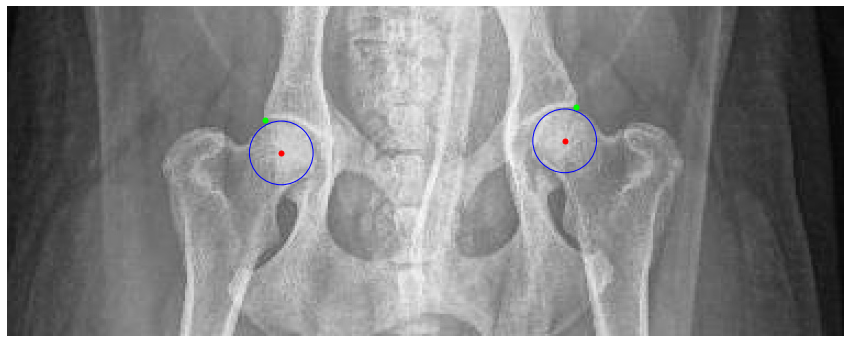

Processing /home/featurize/work/Dataset2/data/Testing/Images/261359.jpeg
center: [[[282  48]]

 [[121  56]]]
head: [[[287  29]]

 [[115  38]]]


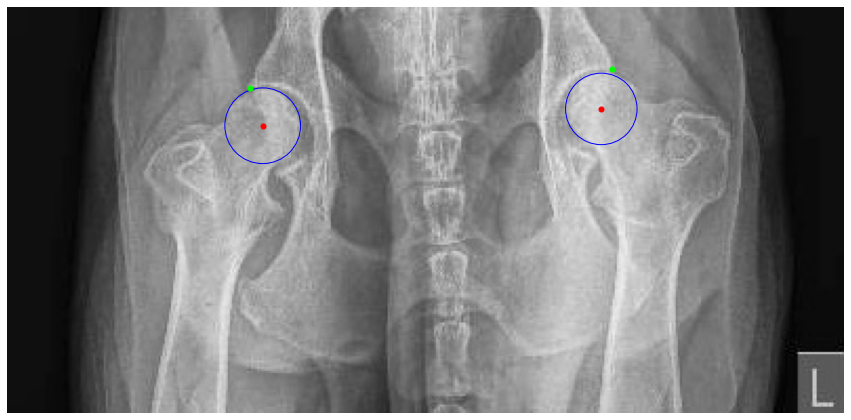

Processing /home/featurize/work/Dataset2/data/Testing/Images/363515.jpeg
center: [[[484 123]]

 [[196 108]]]
head: [[[190  71]]

 [[498  88]]]


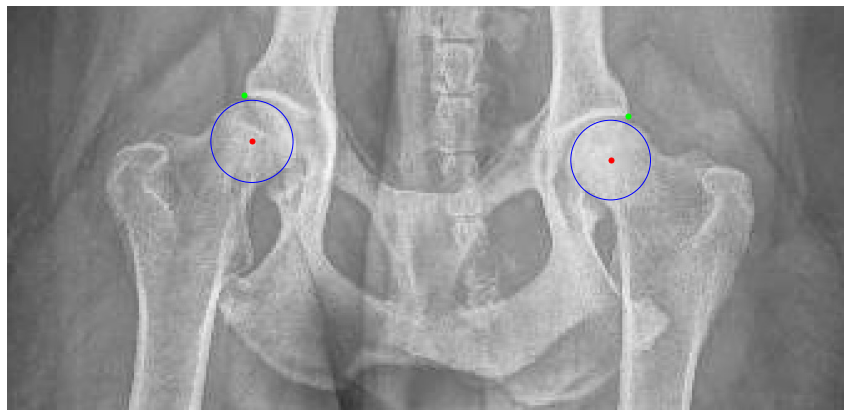

Processing /home/featurize/work/Dataset2/data/Testing/Images/359626.jpeg
center: [[[159 123]]

 [[408 121]]]
head: [[[149  93]]

 [[416  91]]]


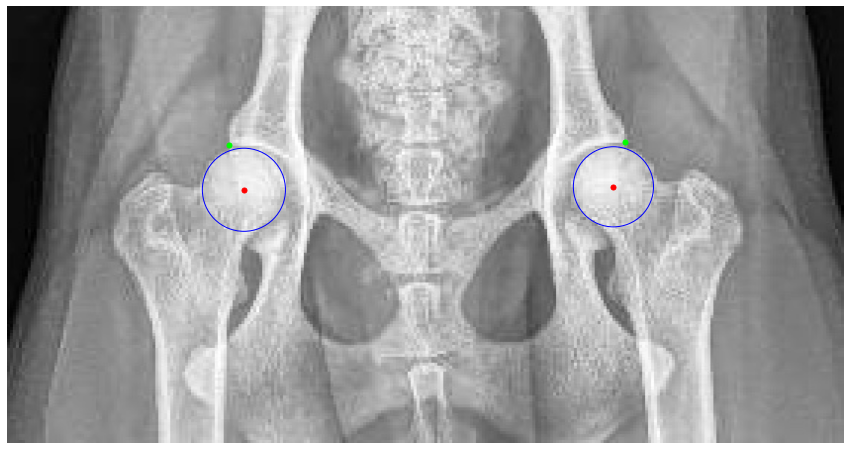

Processing /home/featurize/work/Dataset2/data/Testing/Images/341649.jpeg
center: [[[274 189]]

 [[607 198]]]
head: [[[295 167]]

 [[585 175]]]


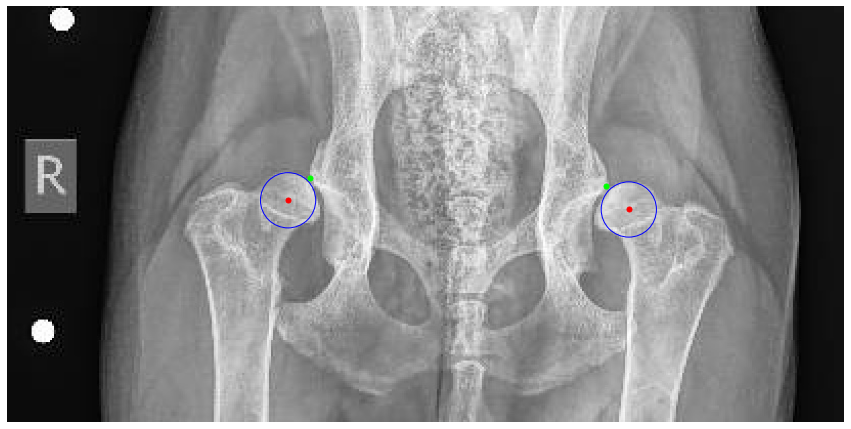

Processing /home/featurize/work/Dataset2/data/Testing/Images/348002.jpeg
center: [[[222 125]]

 [[445  90]]]
head: [[[452  60]]

 [[206  96]]]


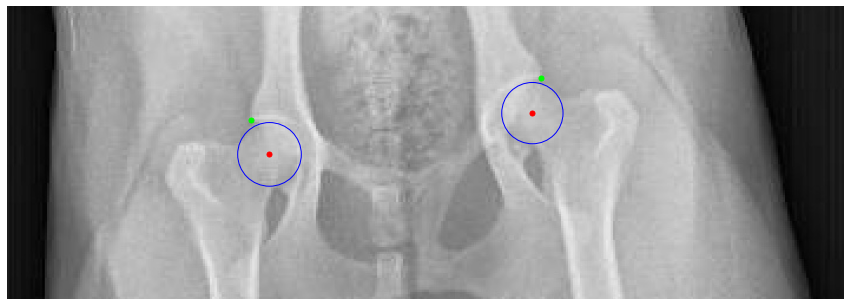

Processing /home/featurize/work/Dataset2/data/Testing/Images/359782.jpeg
center: [[[201 131]]

 [[510 133]]]
head: [[[520  99]]

 [[192  96]]]


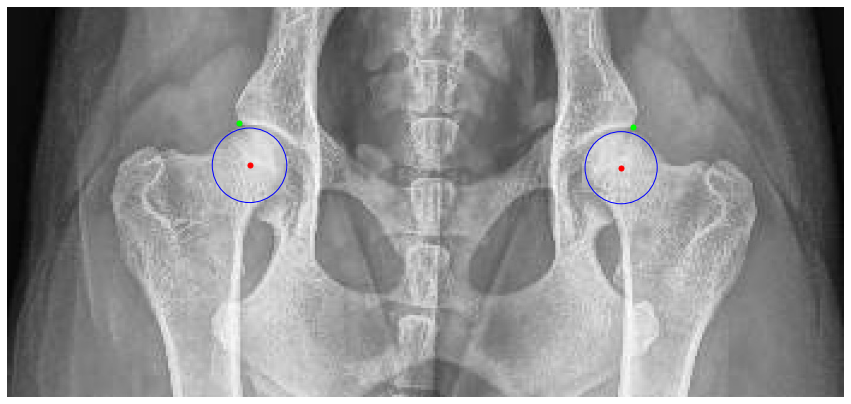

Processing /home/featurize/work/Dataset2/data/Testing/Images/270257.jpeg
center: [[[591 102]]

 [[294 127]]]
head: [[[589  66]]

 [[283  93]]]


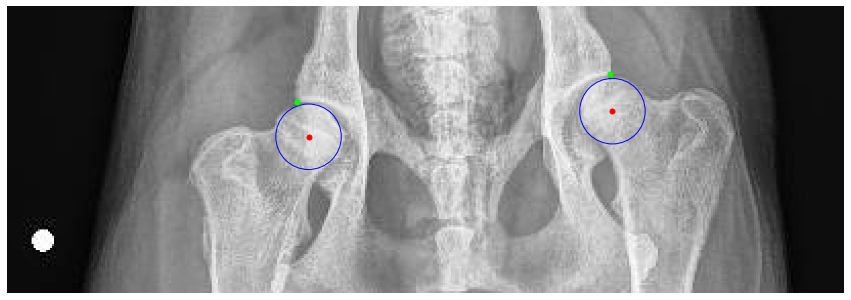

Processing /home/featurize/work/Dataset2/data/Testing/Images/350556.jpeg
center: [[[193 117]]

 [[470  98]]]
head: [[[188  85]]

 [[464  69]]]


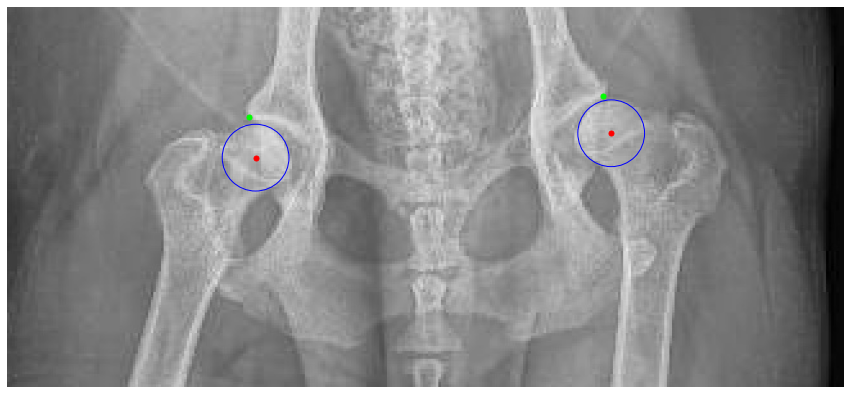

Processing /home/featurize/work/Dataset2/data/Testing/Images/360678.jpg
center: [[[1043  210]]

 [[ 321  215]]]
head: [[[ 288  130]]

 [[1075  124]]]


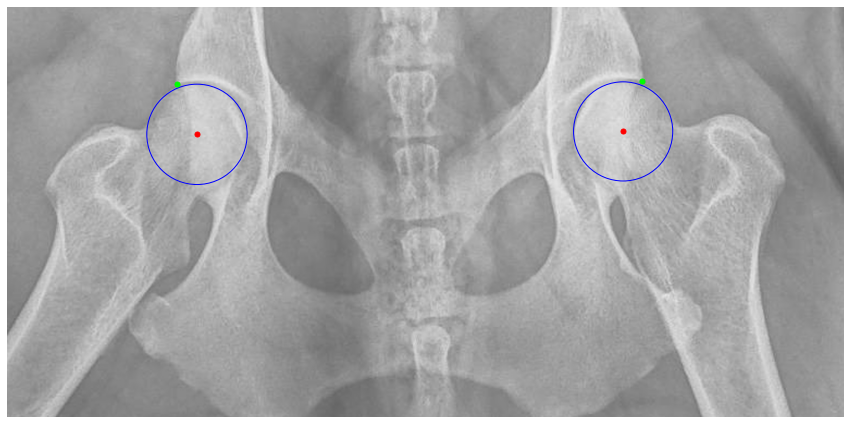

Processing /home/featurize/work/Dataset2/data/Testing/Images/364276.jpeg
center: [[[194 165]]

 [[448 151]]]
head: [[[460 112]]

 [[178 126]]]


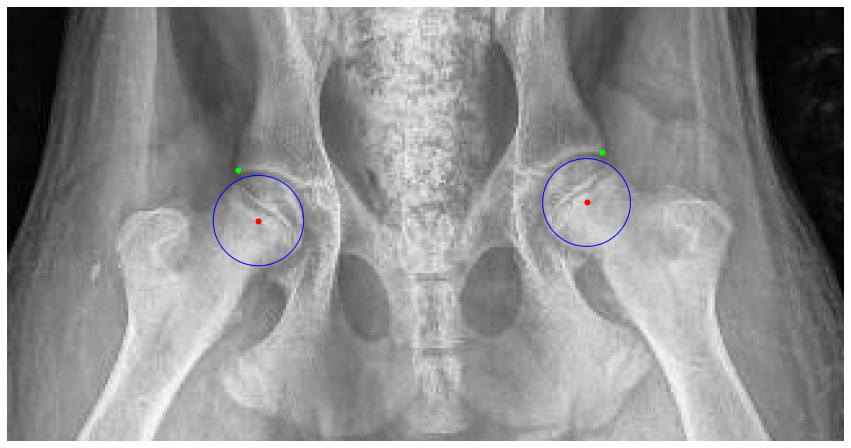

Processing /home/featurize/work/Dataset2/data/Testing/Images/349607.jpeg
center: [[[214 159]]

 [[511 149]]]
head: [[[203 127]]

 [[518 117]]]


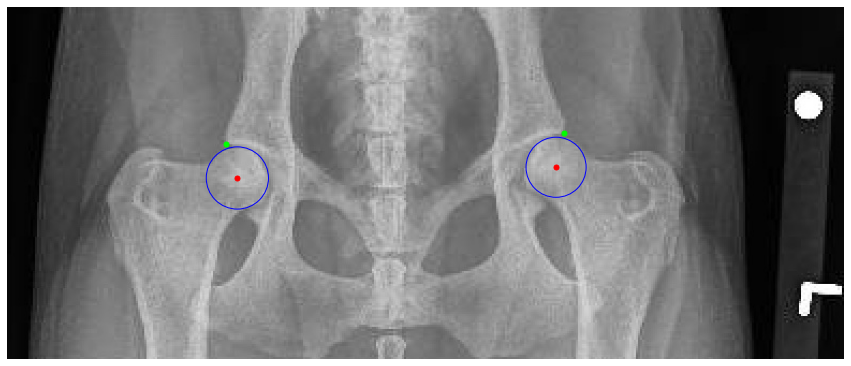

Processing /home/featurize/work/Dataset2/data/Testing/Images/302735.jpeg
center: [[[552 145]]

 [[306 139]]]
head: [[[294 110]]

 [[563 116]]]


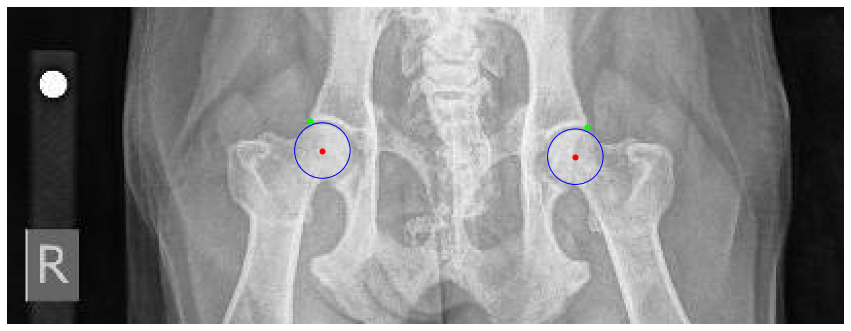

Processing /home/featurize/work/Dataset2/data/Testing/Images/361188.jpeg
center: [[[413  91]]

 [[169 110]]]
head: [[[156  77]]

 [[420  53]]]


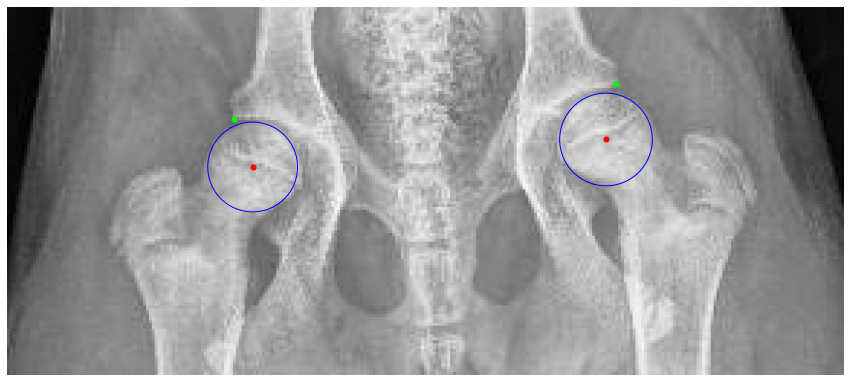

Processing /home/featurize/work/Dataset2/data/Testing/Images/335450.jpeg
center: [[[486 164]]

 [[248 149]]]
head: [[[245 120]]

 [[497 137]]]


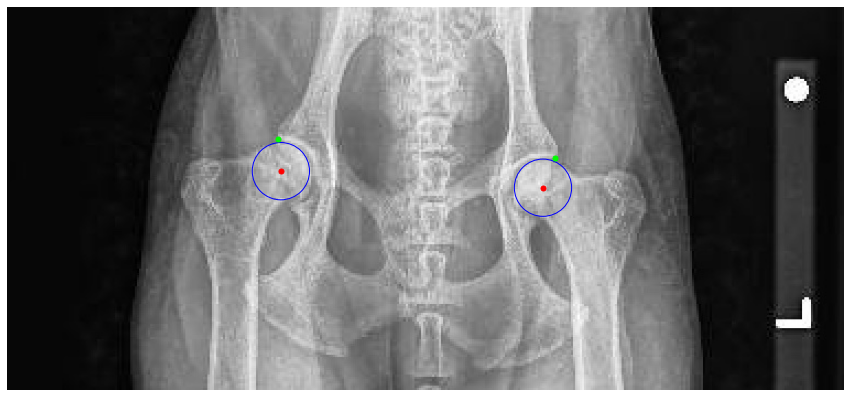

Processing /home/featurize/work/Dataset2/data/Testing/Images/352456.jpeg
center: [[[493 137]]

 [[230 129]]]
head: [[[503 106]]

 [[220  98]]]


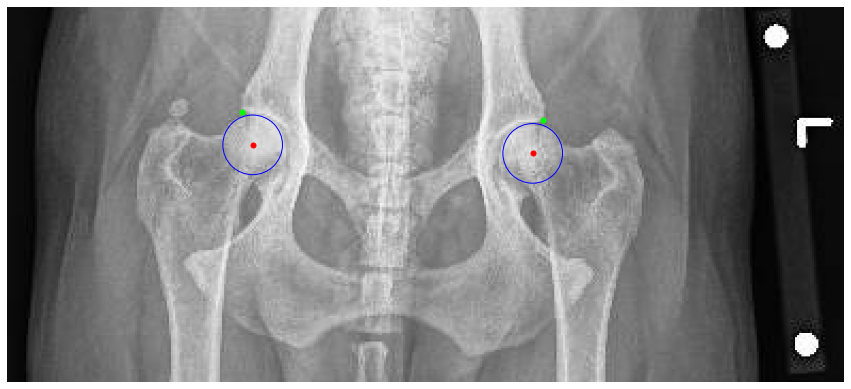

Processing /home/featurize/work/Dataset2/data/Testing/Images/314200.jpeg
center: [[[529 195]]

 [[240 165]]]
head: [[[237 127]]

 [[542 160]]]


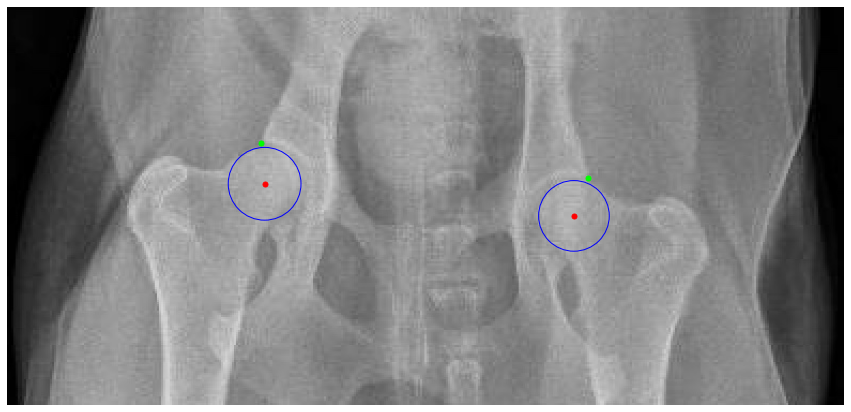

Processing /home/featurize/work/Dataset2/data/Testing/Images/351971.jpg
center: [[[1088  328]]

 [[ 385  318]]]
head: [[[ 359  222]]

 [[1141  237]]]


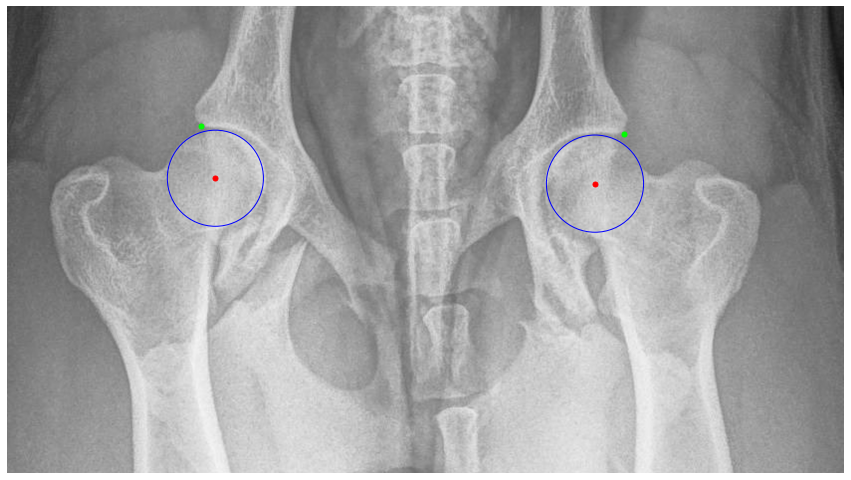

Processing /home/featurize/work/Dataset2/data/Testing/Images/339041.jpeg
center: [[[224 137]]

 [[517 137]]]
head: [[[224 106]]

 [[509 107]]]


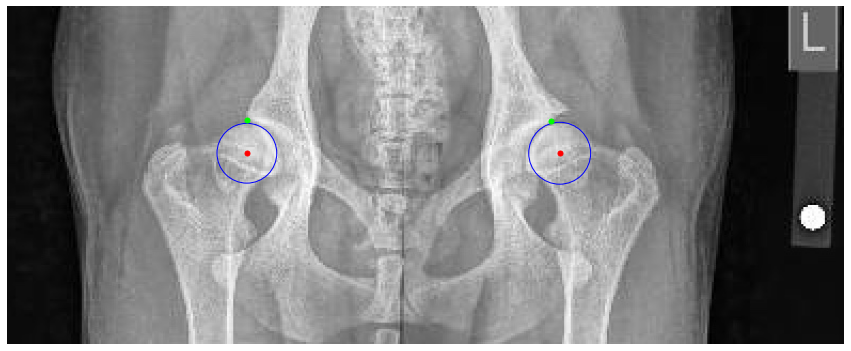

Processing /home/featurize/work/Dataset2/data/Testing/Images/332727.jpeg
center: [[[475 170]]

 [[206 150]]]
head: [[[200 116]]

 [[486 137]]]


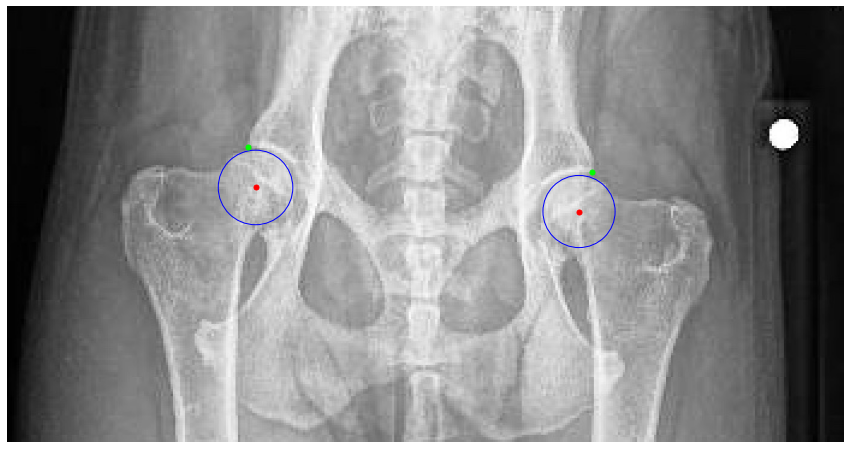

Processing /home/featurize/work/Dataset2/data/Testing/Images/351666.jpg
center: [[[ 376  364]]

 [[1253  361]]]
head: [[[ 352  264]]

 [[1274  268]]]


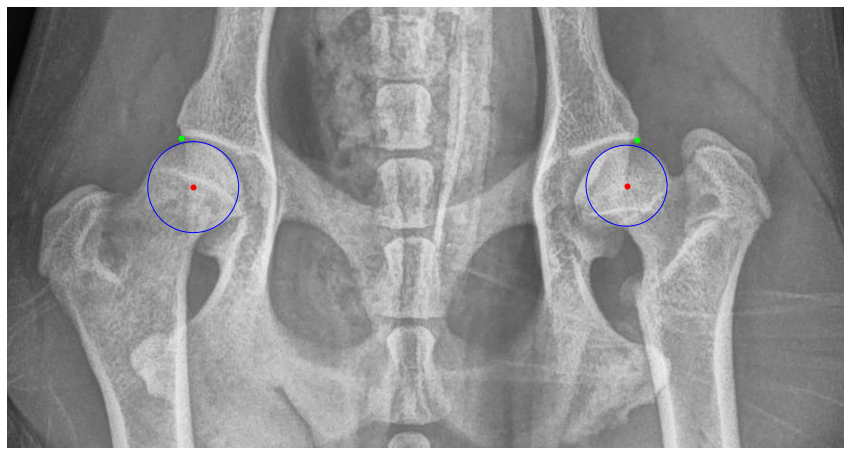

Processing /home/featurize/work/Dataset2/data/Testing/Images/351294.jpeg
center: [[[453 108]]

 [[198 118]]]
head: [[[190  88]]

 [[459  77]]]


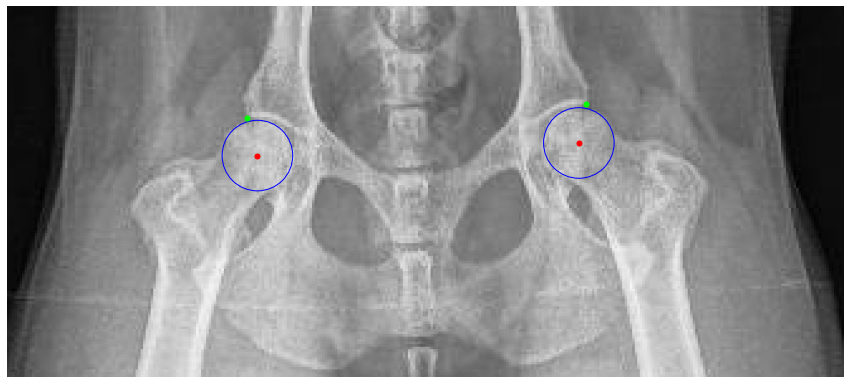

Processing /home/featurize/work/Dataset2/data/Testing/Images/288625.jpeg
center: [[[261 105]]

 [[508 119]]]
head: [[[519  89]]

 [[253  76]]]


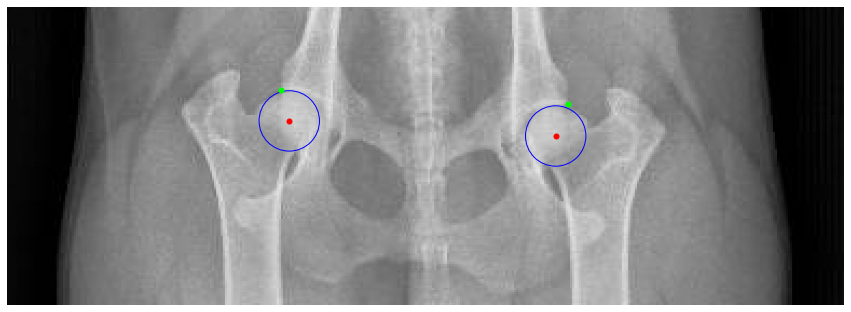

Processing /home/featurize/work/Dataset2/data/Testing/Images/357332.jpeg
center: [[[490 103]]

 [[221  99]]]
head: [[[208  67]]

 [[503  72]]]


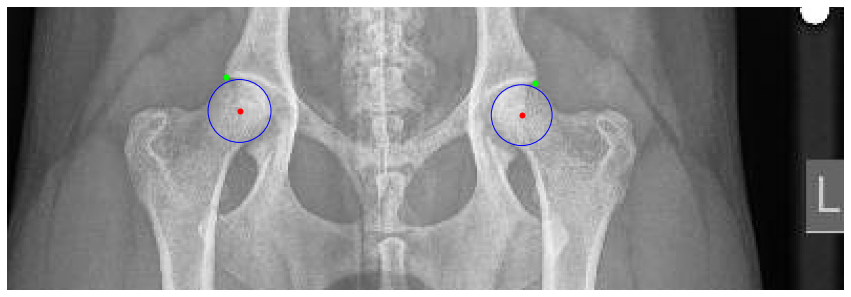

Processing /home/featurize/work/Dataset2/data/Testing/Images/345281.jpeg
center: [[[501 142]]

 [[222 149]]]
head: [[[510 108]]

 [[209 116]]]


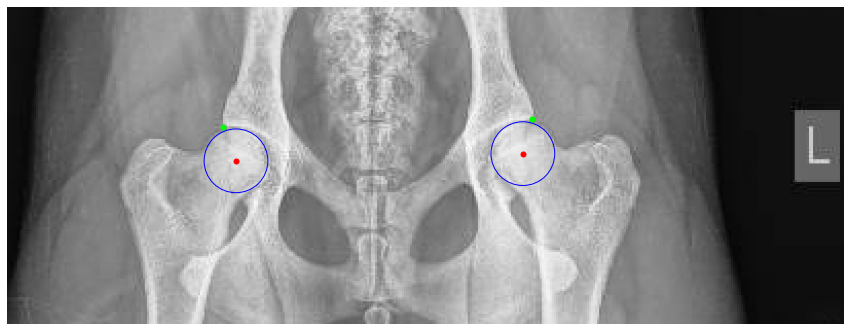

Processing /home/featurize/work/Dataset2/data/Testing/Images/364123.jpeg
center: [[[423  99]]

 [[164 104]]]
head: [[[433  67]]

 [[150  73]]]


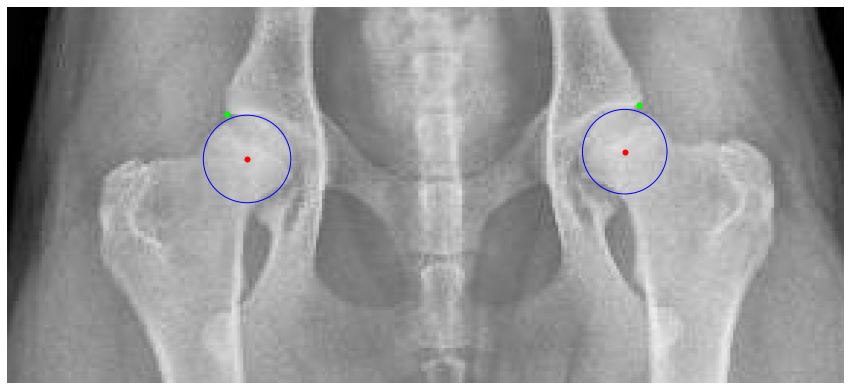

Processing /home/featurize/work/Dataset2/data/Testing/Images/332635.jpeg
center: [[[509 165]]

 [[272 154]]]
head: [[[267 124]]

 [[519 137]]]


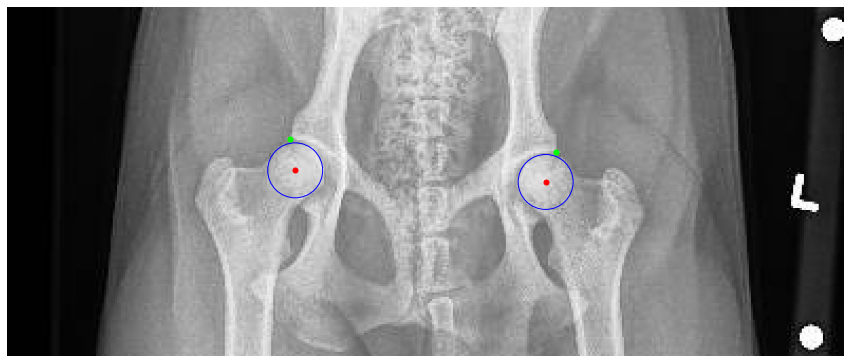

Processing /home/featurize/work/Dataset2/data/Testing/Images/355423.jpeg
center: [[[208 181]]

 [[534 200]]]
head: [[[198 142]]

 [[551 159]]]


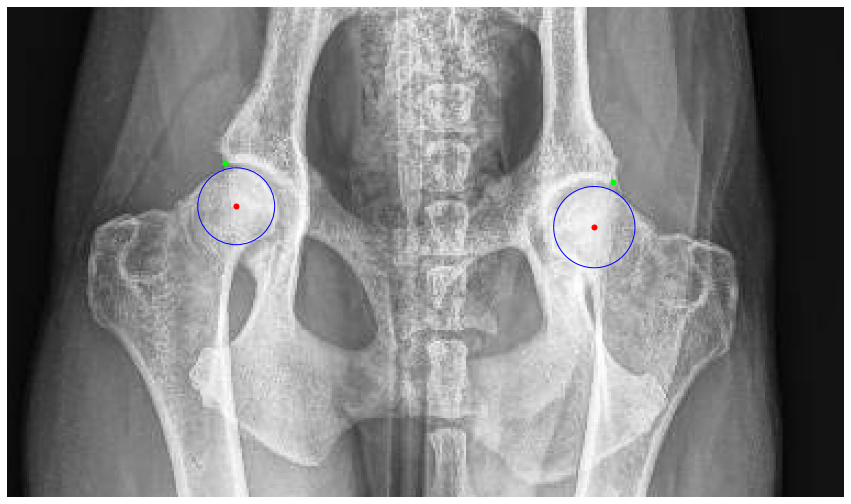

Processing /home/featurize/work/Dataset2/data/Testing/Images/360391.jpeg
center: [[[526 138]]

 [[194 131]]]
head: [[[193  98]]

 [[523 104]]]


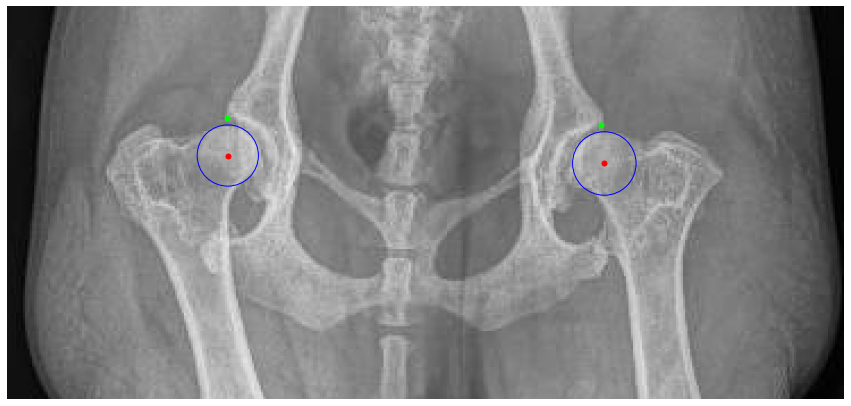

Processing /home/featurize/work/Dataset2/data/Testing/Images/366863.jpeg
center: [[[192  96]]

 [[460  93]]]
head: [[[469  61]]

 [[178  64]]]


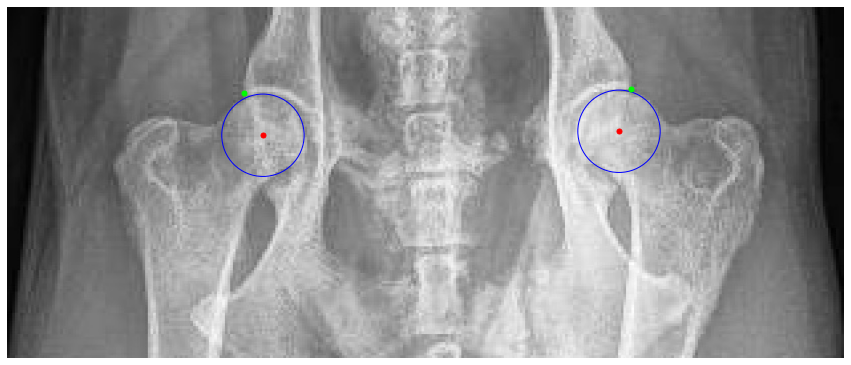

Processing /home/featurize/work/Dataset2/data/Testing/Images/353028.jpeg
center: [[[190 161]]

 [[490 149]]]
head: [[[491 113]]

 [[181 128]]]


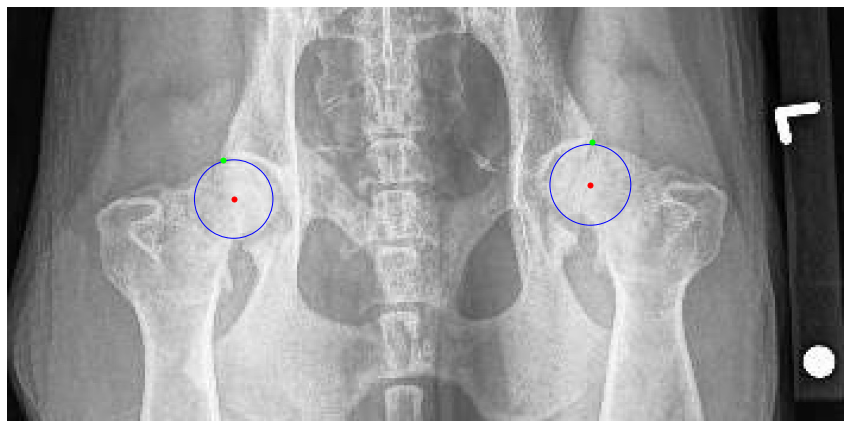

Processing /home/featurize/work/Dataset2/data/Testing/Images/358586.jpeg
center: [[[120  78]]

 [[333  81]]]
head: [[[335  55]]

 [[120  53]]]


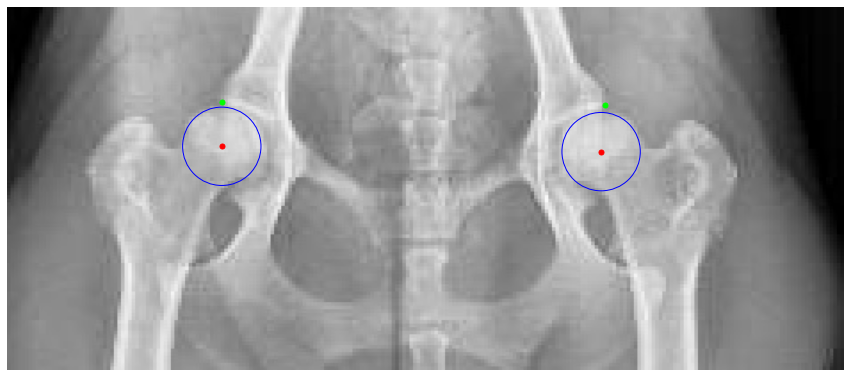

Processing /home/featurize/work/Dataset2/data/Testing/Images/357885.jpeg
center: [[[197 128]]

 [[484 133]]]
head: [[[490  98]]

 [[200  95]]]


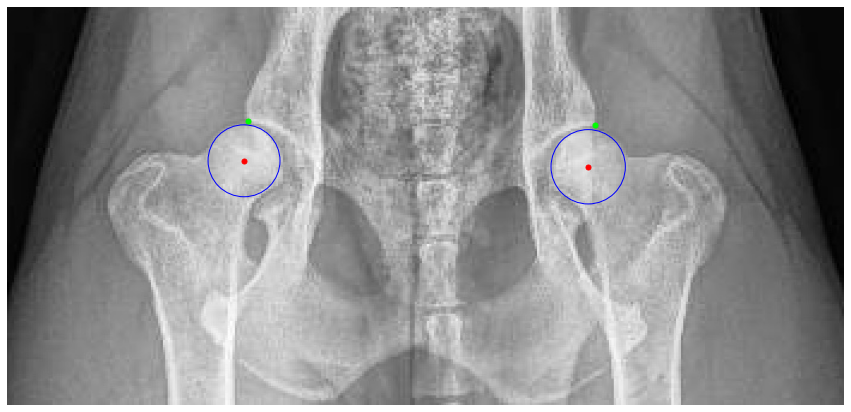

Processing /home/featurize/work/Dataset2/data/Testing/Images/360713.jpeg
center: [[[185 120]]

 [[497 116]]]
head: [[[197  87]]

 [[486  89]]]


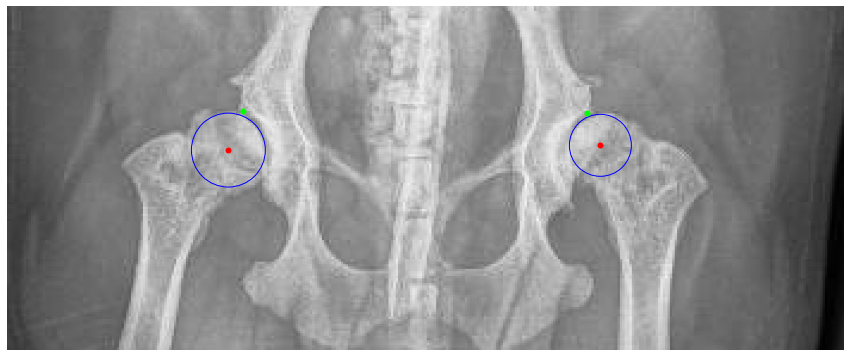

Processing /home/featurize/work/Dataset2/data/Testing/Images/355048.jpeg
center: [[[548 169]]

 [[212 147]]]
head: [[[538 135]]

 [[244 133]]]


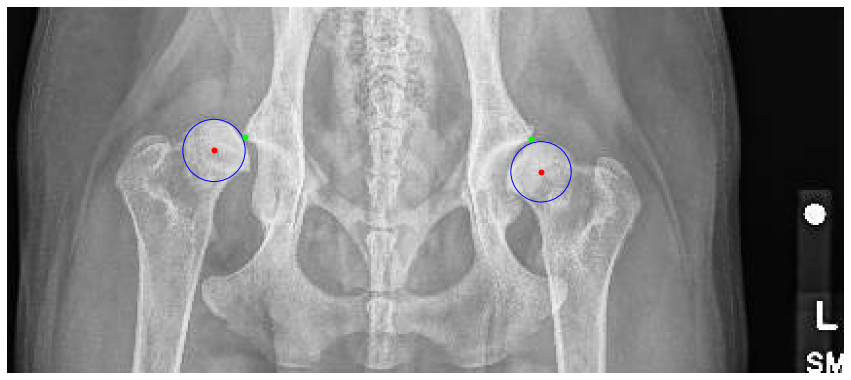

Processing /home/featurize/work/Dataset2/data/Testing/Images/328125.jpeg
center: [[[470 134]]

 [[245 120]]]
head: [[[482 107]]

 [[241  92]]]


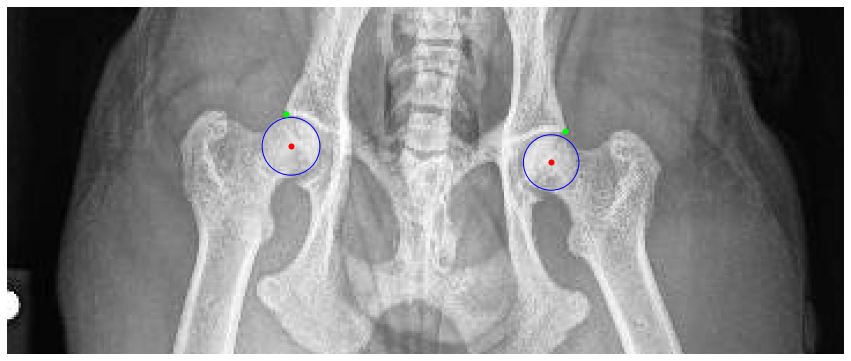

Processing /home/featurize/work/Dataset2/data/Testing/Images/366596.jpeg
center: [[[617 154]]

 [[208 153]]]
head: [[[201  99]]

 [[621 102]]]


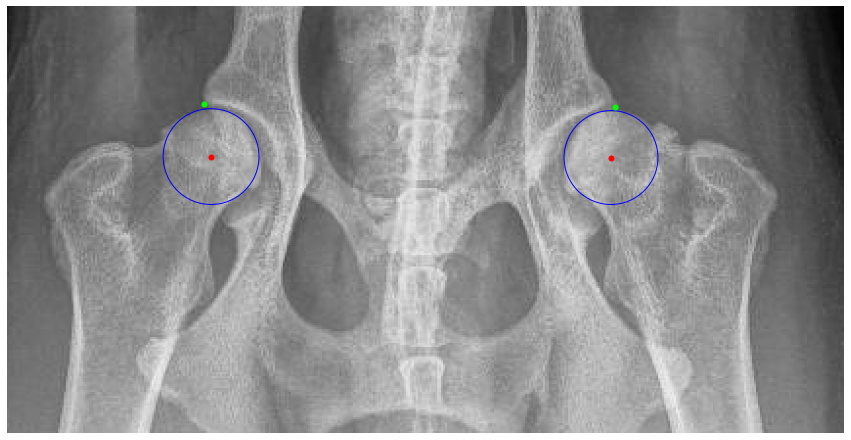

Processing /home/featurize/work/Dataset2/data/Testing/Images/274791.jpeg
center: [[[272 182]]

 [[542 194]]]
head: [[[265 149]]

 [[555 164]]]


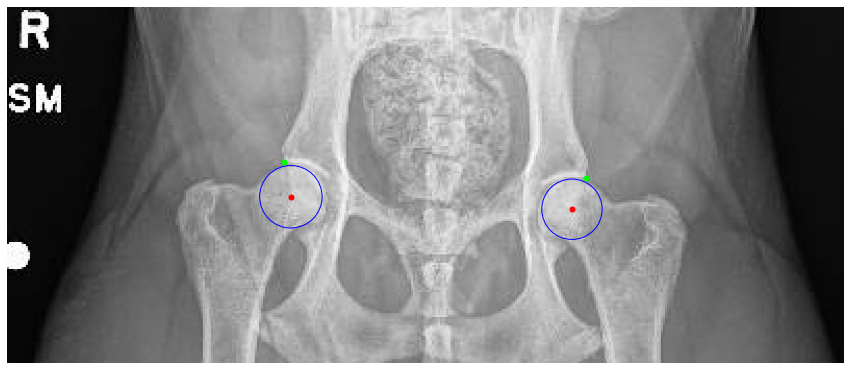

Processing /home/featurize/work/Dataset2/data/Testing/Images/361394.jpeg
center: [[[399  92]]

 [[144  96]]]
head: [[[408  60]]

 [[135  63]]]


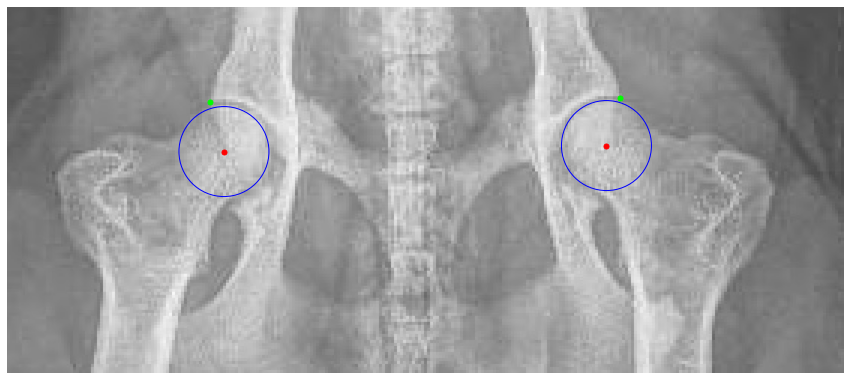

Processing /home/featurize/work/Dataset2/data/Testing/Images/355416.jpeg
center: [[[487  94]]

 [[184 100]]]
head: [[[174  64]]

 [[494  60]]]


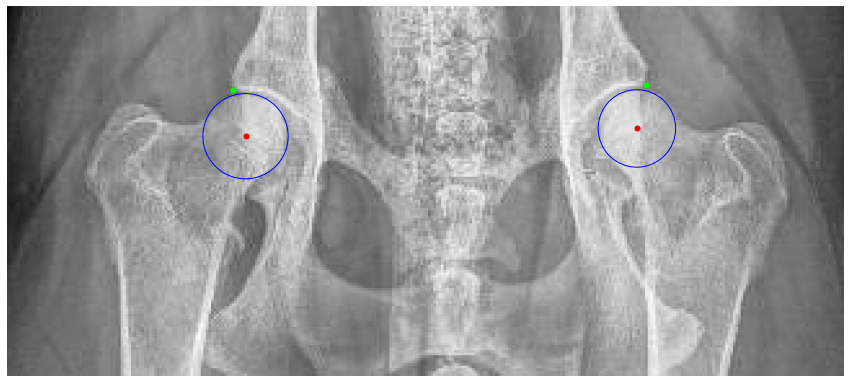

Processing /home/featurize/work/Dataset2/data/Testing/Images/361506.jpeg
center: [[[167 115]]

 [[492 115]]]
head: [[[172  81]]

 [[482  82]]]


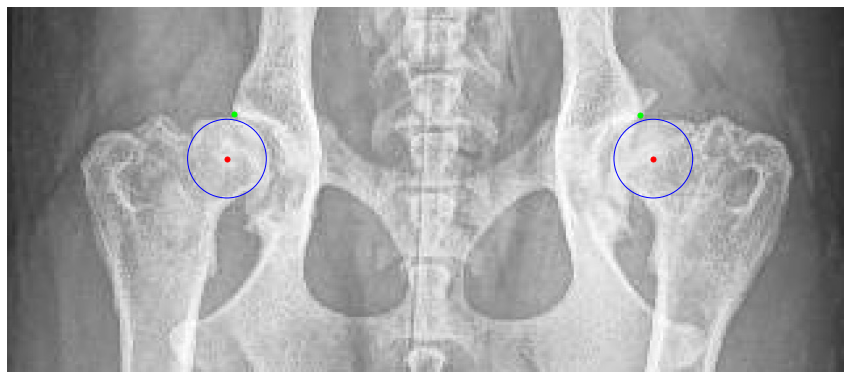

Processing /home/featurize/work/Dataset2/data/Testing/Images/354095.jpeg
center: [[[159 108]]

 [[438  77]]]
head: [[[145  77]]

 [[428  47]]]


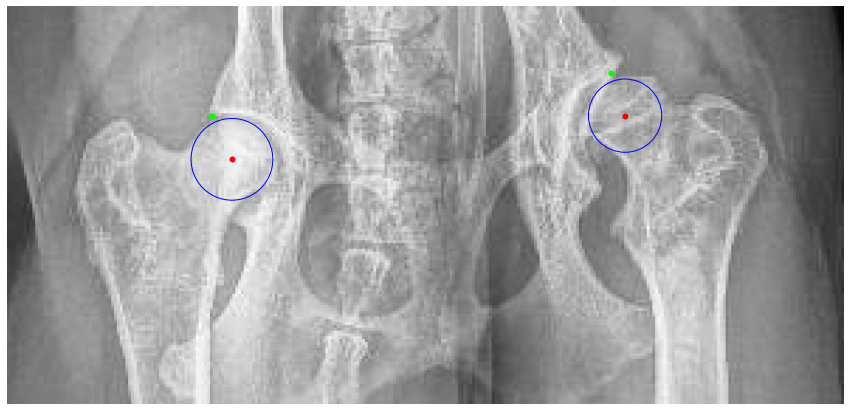

Processing /home/featurize/work/Dataset2/data/Testing/Images/331722.jpeg
center: [[[659 161]]

 [[363 186]]]
head: [[[347 151]]

 [[666 128]]]


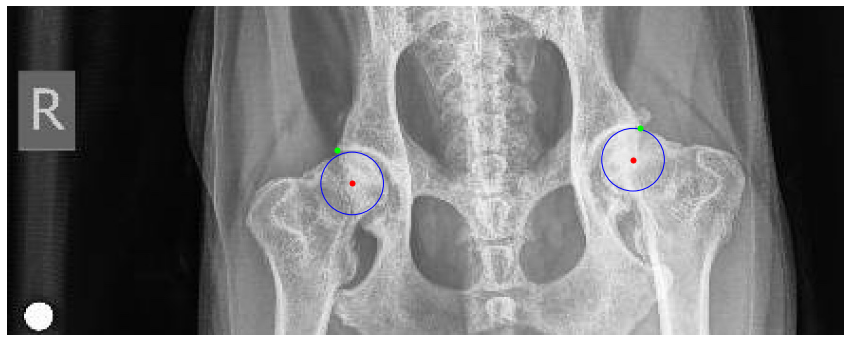

Processing /home/featurize/work/Dataset2/data/Testing/Images/353949.jpg
center: [[[1302  383]]

 [[ 355  301]]]
head: [[[1308  285]]

 [[ 399  218]]]


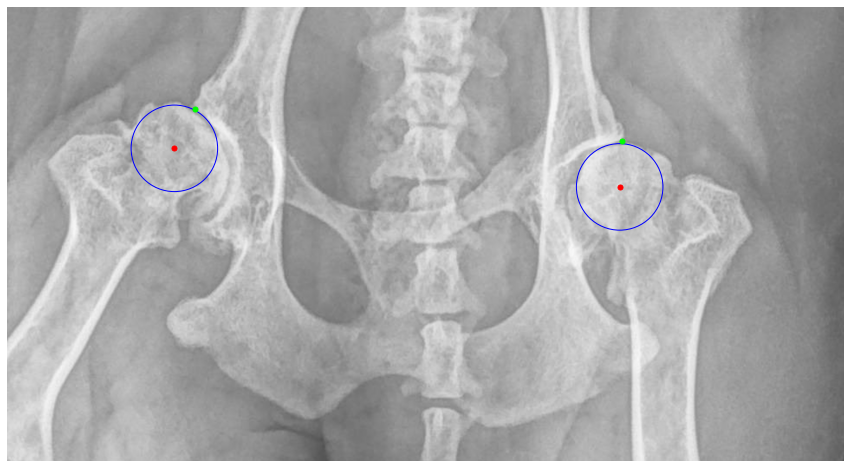

Processing /home/featurize/work/Dataset2/data/Testing/Images/351595.jpeg
center: [[[445 161]]

 [[179 137]]]
head: [[[457 130]]

 [[183 106]]]


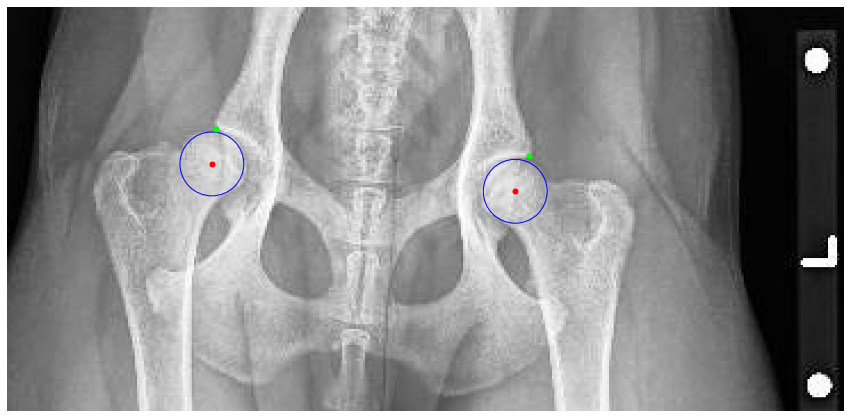

Processing /home/featurize/work/Dataset2/data/Testing/Images/349667.jpeg
center: [[[497 149]]

 [[220 136]]]
head: [[[214 101]]

 [[512 113]]]


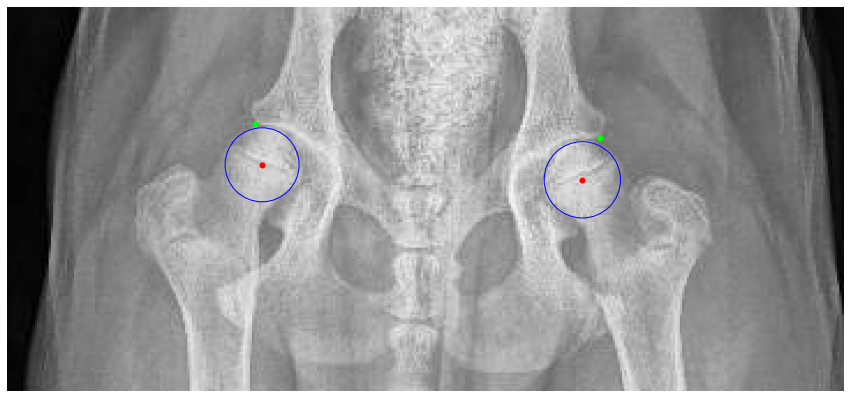

Processing /home/featurize/work/Dataset2/data/Testing/Images/353433.jpeg
center: [[[520 156]]

 [[209 156]]]
head: [[[197 118]]

 [[528 116]]]


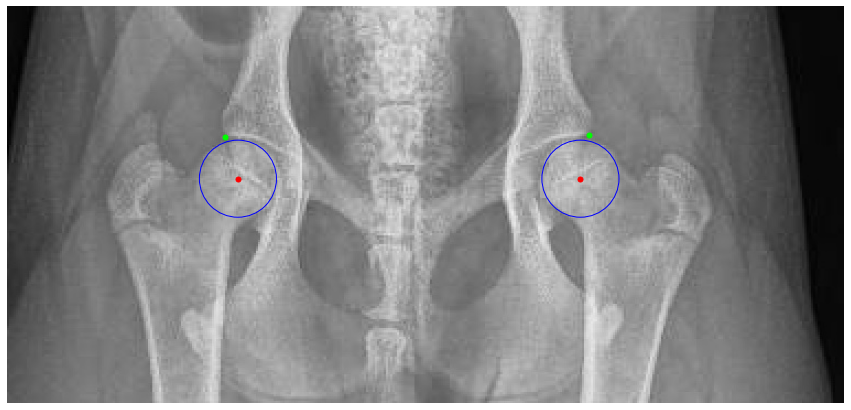

Processing /home/featurize/work/Dataset2/data/Testing/Images/325050.jpg
center: [[[1140  186]]

 [[ 393  233]]]
head: [[[1157   93]]

 [[ 363  139]]]


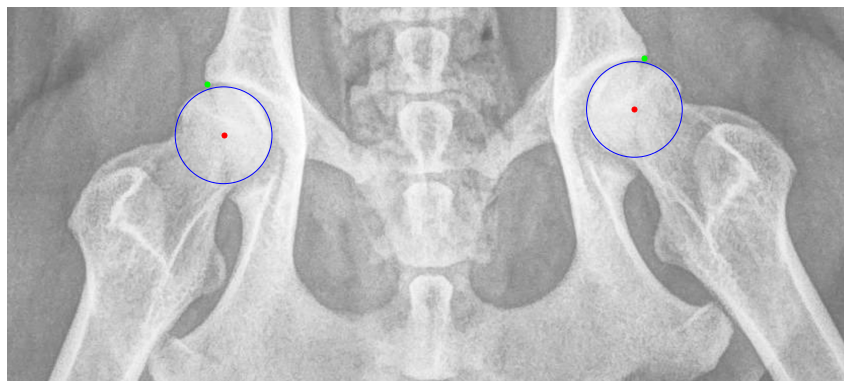

Processing /home/featurize/work/Dataset2/data/Testing/Images/347694.jpeg
center: [[[504 166]]

 [[194 144]]]
head: [[[200 111]]

 [[498 133]]]


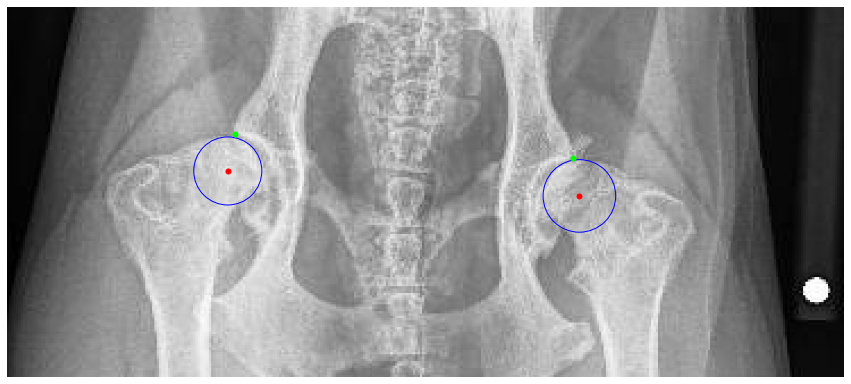

Processing /home/featurize/work/Dataset2/data/Testing/Images/354826.jpg
center: [[[ 419  265]]

 [[1110  213]]]
head: [[[ 394  186]]

 [[1117  131]]]


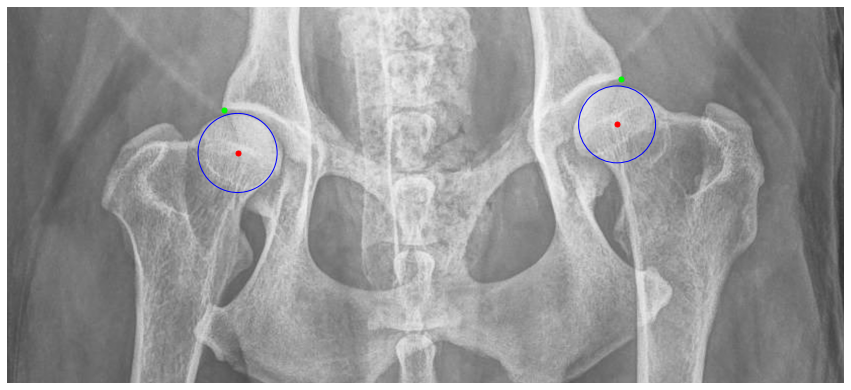

Processing /home/featurize/work/Dataset2/data/Testing/Images/346249.jpg
center: [[[ 345  236]]

 [[1032  298]]]
head: [[[ 314  154]]

 [[1062  215]]]


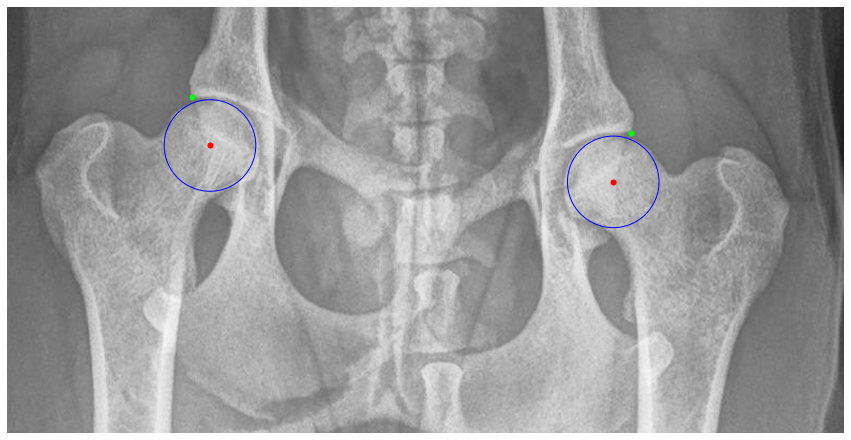

Processing /home/featurize/work/Dataset2/data/Testing/Images/357623.jpg
center: [[[1037  276]]

 [[ 362  300]]]
head: [[[1064  187]]

 [[ 326  212]]]


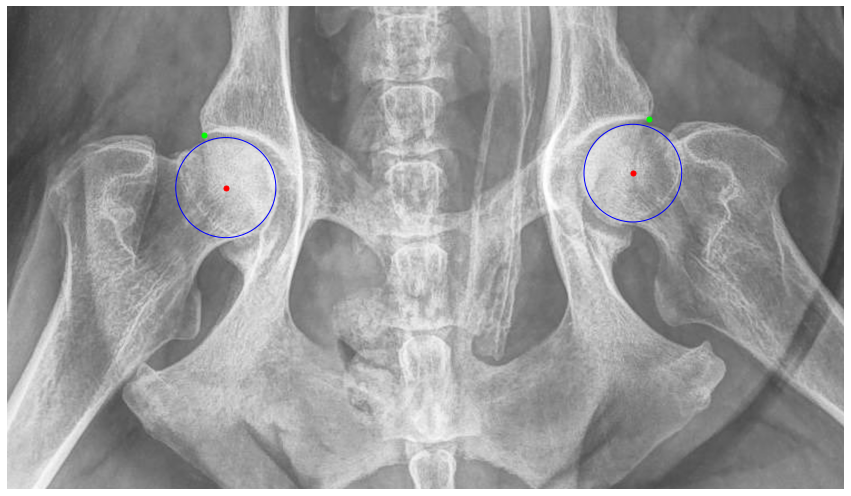

Processing /home/featurize/work/Dataset2/data/Testing/Images/357265.jpeg
center: [[[538 208]]

 [[212 198]]]
head: [[[204 160]]

 [[547 173]]]


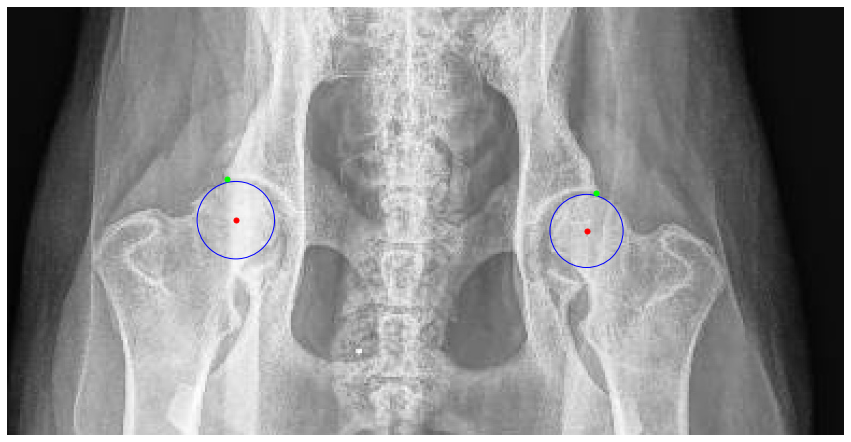

Processing /home/featurize/work/Dataset2/data/Testing/Images/353330.jpeg
center: [[[503 159]]

 [[192 135]]]
head: [[[511 123]]

 [[206 102]]]


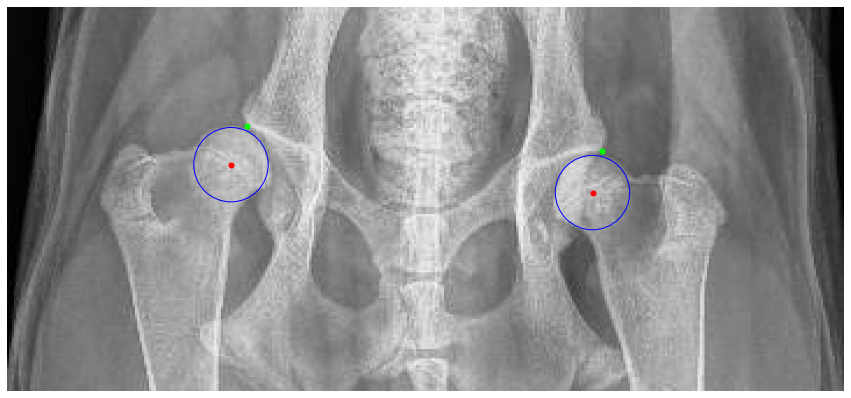

Processing /home/featurize/work/Dataset2/data/Testing/Images/363860.jpeg
center: [[[152 134]]

 [[471 151]]]
head: [[[142  98]]

 [[485 115]]]


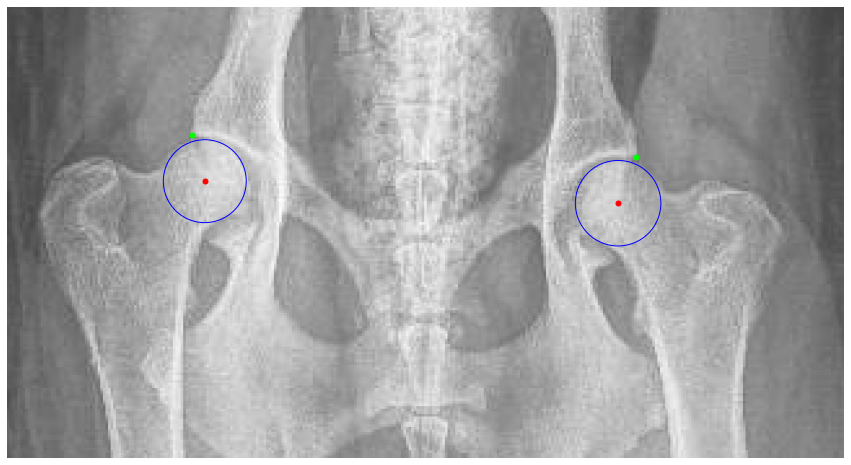

Processing /home/featurize/work/Dataset2/data/Testing/Images/325038.jpeg
center: [[[301 155]]

 [[580 154]]]
head: [[[291 122]]

 [[592 121]]]


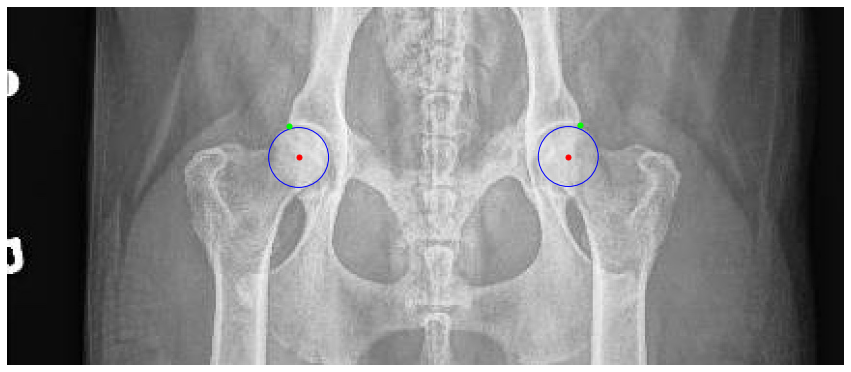

Processing /home/featurize/work/Dataset2/data/Testing/Images/357970.jpeg
center: [[[445 134]]

 [[193 121]]]
head: [[[455 103]]

 [[195  89]]]


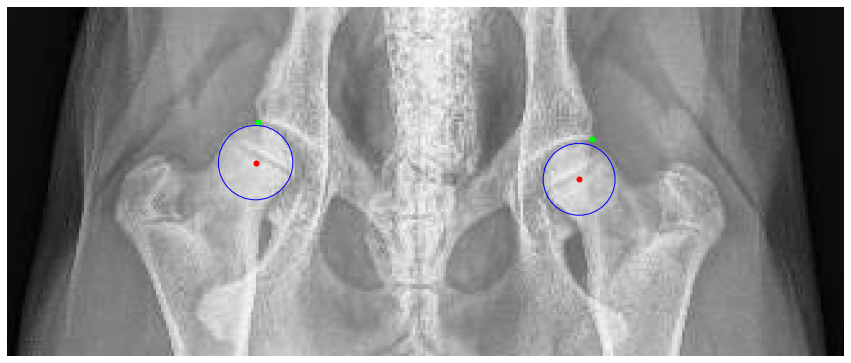

Processing /home/featurize/work/Dataset2/data/Testing/Images/268505.jpeg
center: [[[274  96]]

 [[567 138]]]
head: [[[265  59]]

 [[586 104]]]


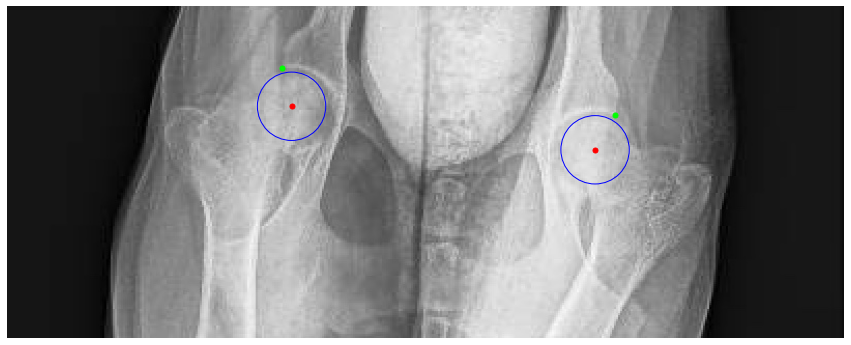

Processing /home/featurize/work/Dataset2/data/Testing/Images/349744.jpeg
center: [[[246 106]]

 [[500 112]]]
head: [[[510  82]]

 [[238  77]]]


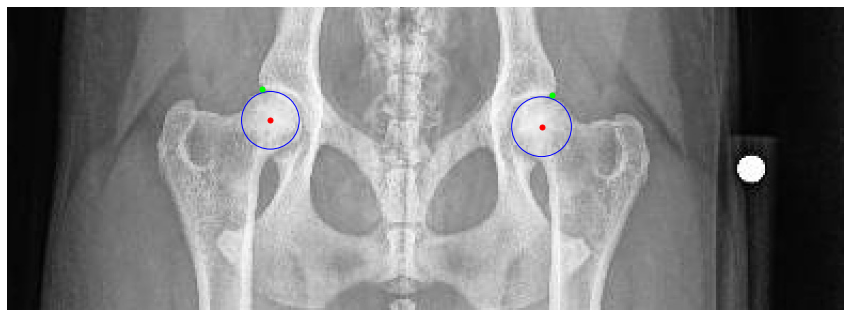

Processing /home/featurize/work/Dataset2/data/Testing/Images/351103.jpeg
center: [[[432 109]]

 [[191 112]]]
head: [[[185  82]]

 [[438  79]]]


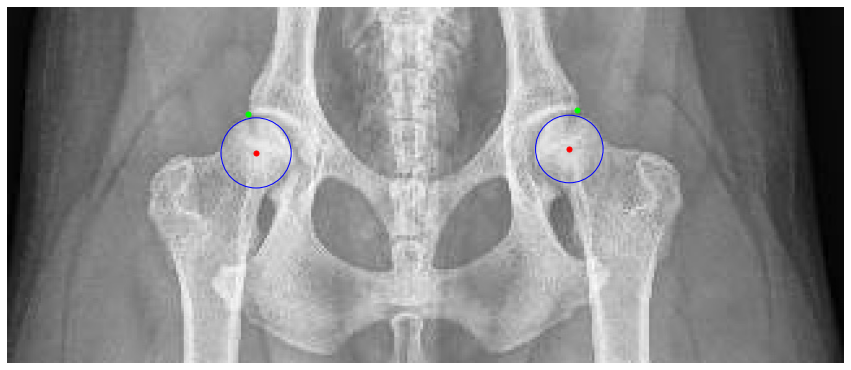

Processing /home/featurize/work/Dataset2/data/Testing/Images/356926.jpeg
center: [[[467 118]]

 [[215 129]]

 [[319 261]]]
head: [[[479  87]]

 [[206  97]]

 [[314 240]]]


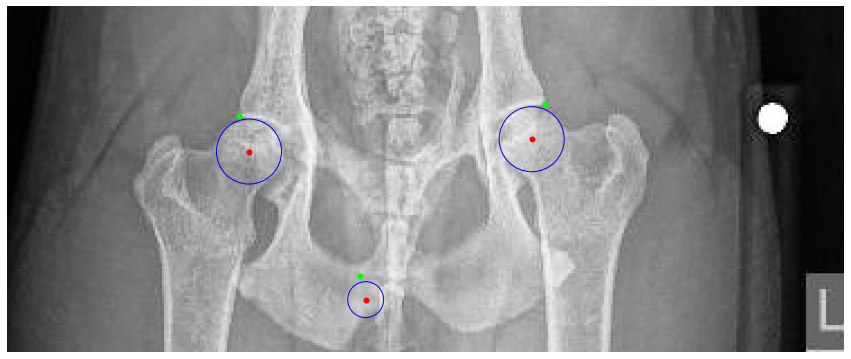

Processing /home/featurize/work/Dataset2/data/Testing/Images/352310.jpeg
center: [[[541 131]]

 [[196 135]]]
head: [[[545  93]]

 [[199  96]]]


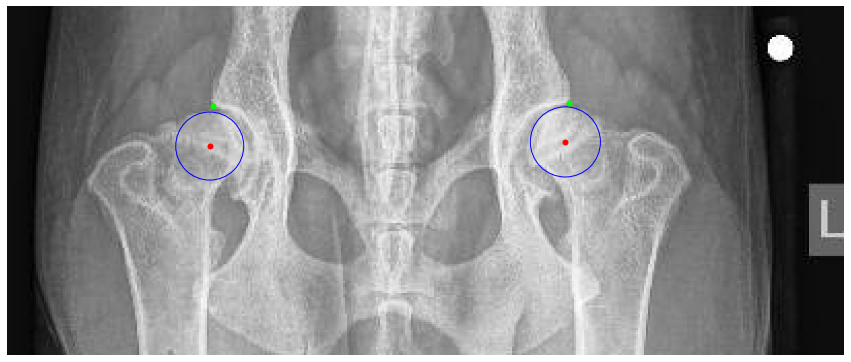

Processing /home/featurize/work/Dataset2/data/Testing/Images/364990.jpeg
center: [[[441 125]]

 [[171 114]]]
head: [[[165  76]]

 [[453  90]]]


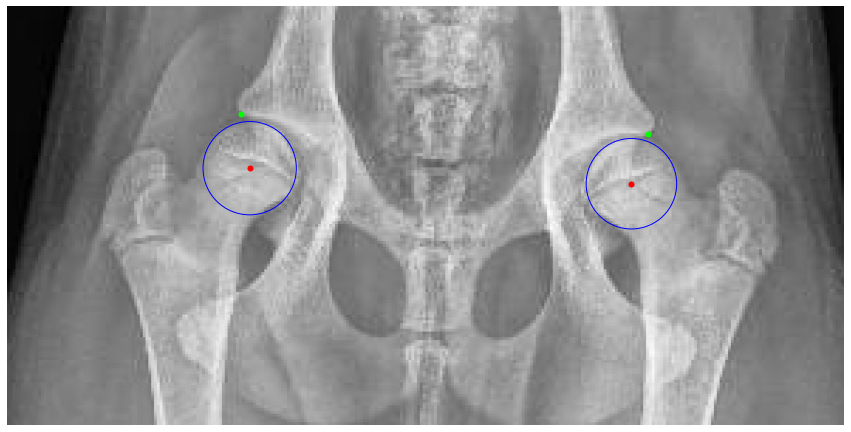

Processing /home/featurize/work/Dataset2/data/Testing/Images/361597.jpeg
center: [[[388 104]]

 [[160 104]]]
head: [[[146  79]]

 [[401  79]]]


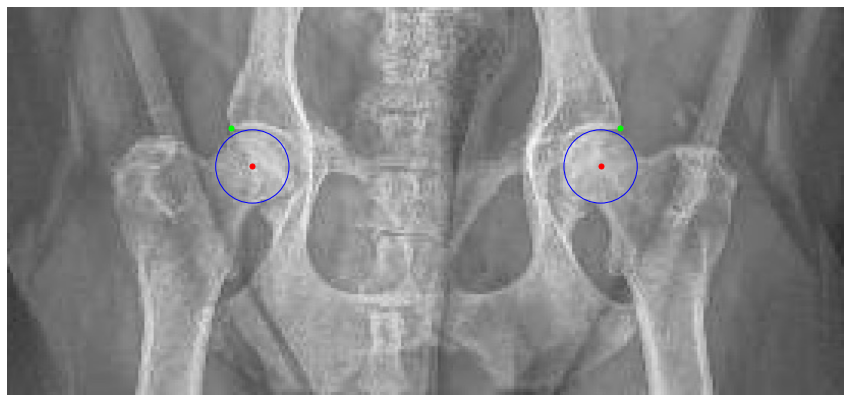

Processing /home/featurize/work/Dataset2/data/Testing/Images/360012.jpeg
center: [[[142 100]]

 [[409 102]]]
head: [[[417  72]]

 [[133  70]]]


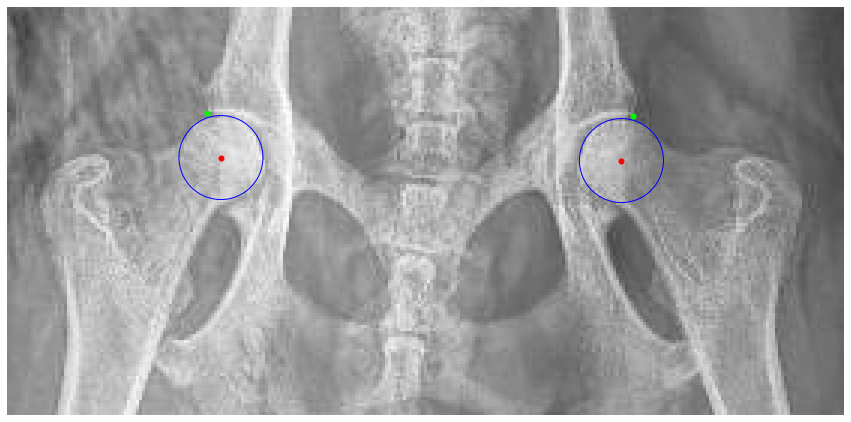

Processing /home/featurize/work/Dataset2/data/Testing/Images/329554.jpeg
center: [[[272 172]]

 [[565 205]]]
head: [[[265 138]]

 [[584 175]]]


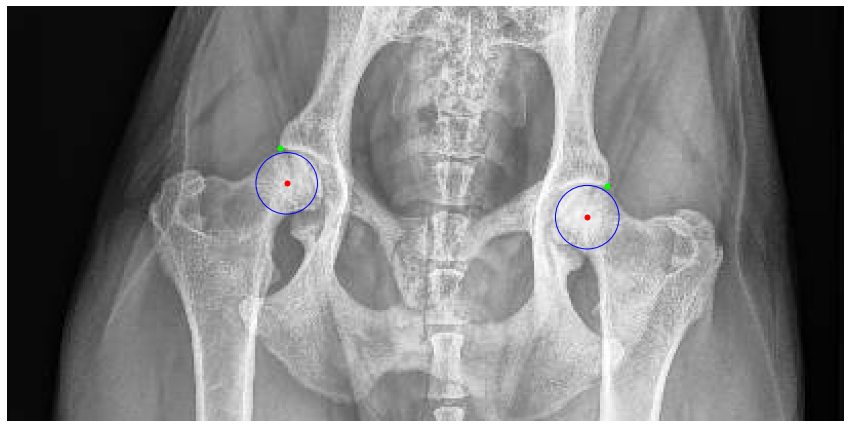

Processing /home/featurize/work/Dataset2/data/Testing/Images/357815.jpeg
center: [[[408 121]]

 [[159 124]]]
head: [[[148  98]]

 [[417  91]]]


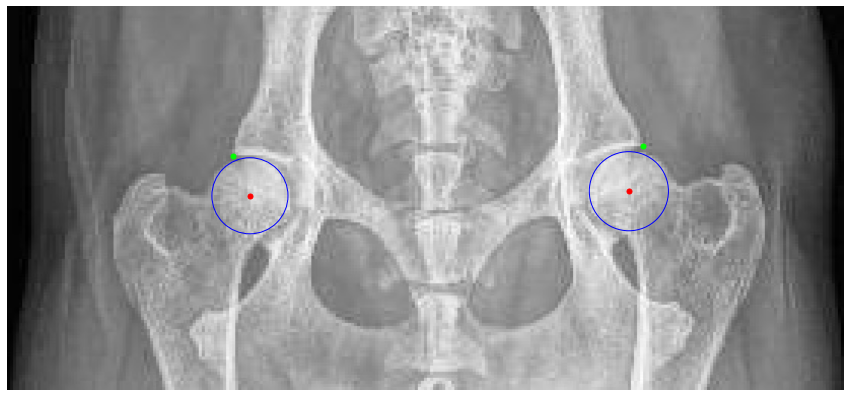

Processing /home/featurize/work/Dataset2/data/Testing/Images/354570.jpeg
center: [[[293 176]]

 [[589 186]]]
head: [[[286 139]]

 [[602 150]]]


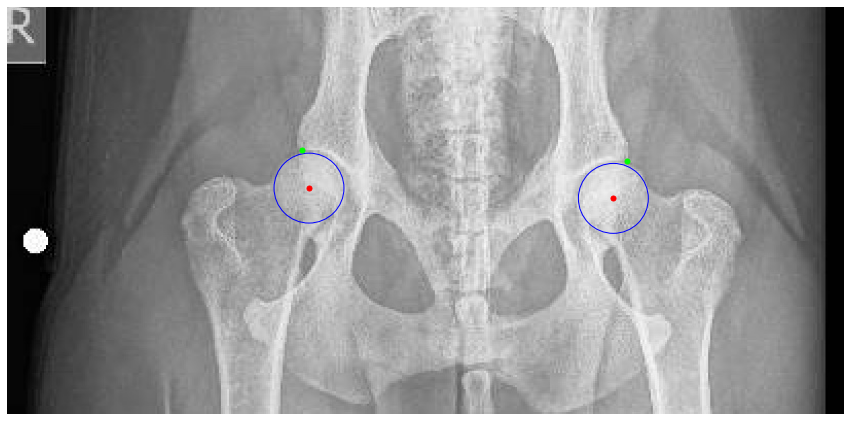

Processing /home/featurize/work/Dataset2/data/Testing/Images/361479.jpeg
center: [[[189 117]]

 [[483 124]]]
head: [[[496  90]]

 [[179  82]]]


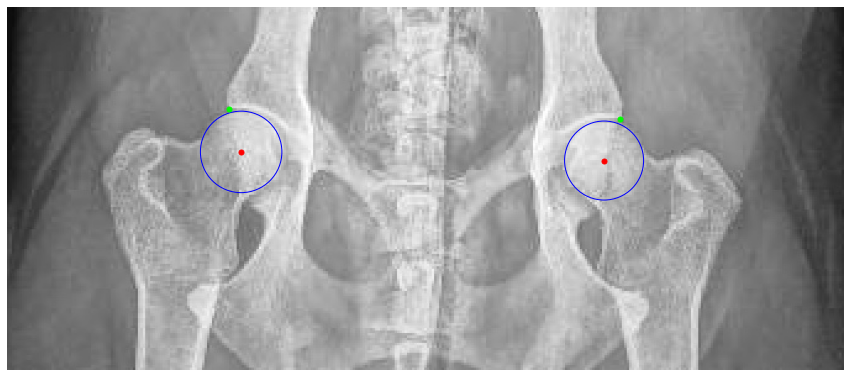

Processing /home/featurize/work/Dataset2/data/Testing/Images/357153.jpeg
center: [[[536 165]]

 [[239 162]]]
head: [[[547 129]]

 [[229 129]]]


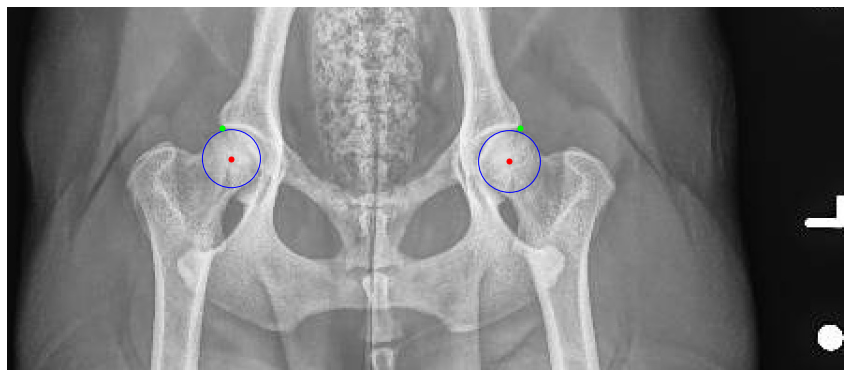

Processing /home/featurize/work/Dataset2/data/Testing/Images/308700.jpg
center: [[[ 345  249]]

 [[1050  307]]]
head: [[[ 336  170]]

 [[1081  227]]]


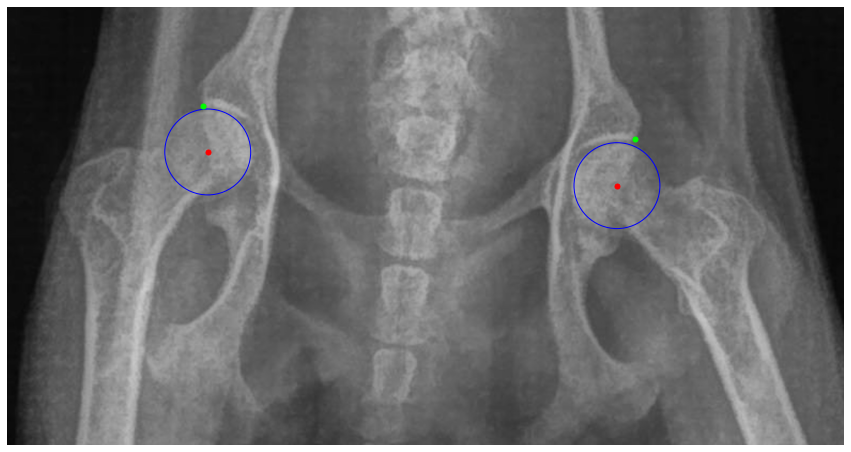

Processing /home/featurize/work/Dataset2/data/Testing/Images/361233.jpeg
center: [[[212 114]]

 [[498 138]]]
head: [[[508 103]]

 [[205  78]]]


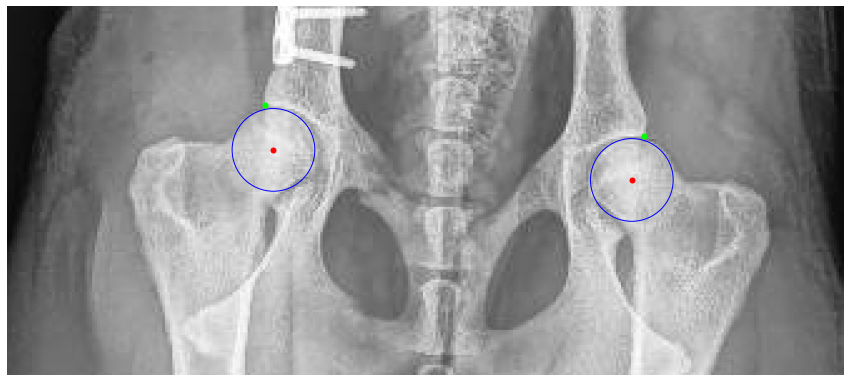

Processing /home/featurize/work/Dataset2/data/Testing/Images/357274.jpeg
center: [[[432 121]]

 [[156 108]]]
head: [[[441  91]]

 [[181  81]]]


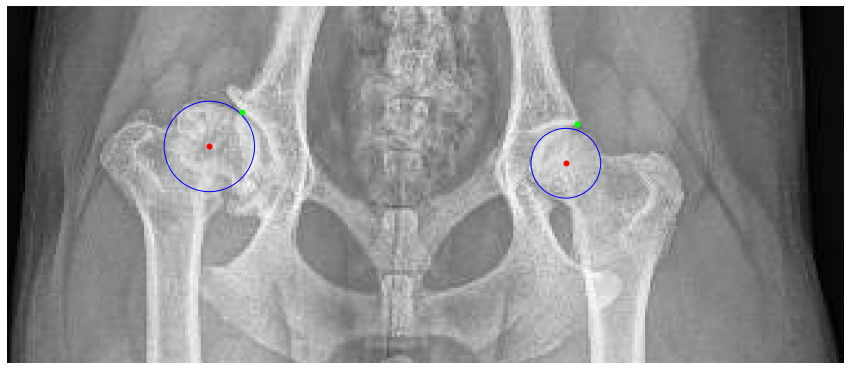

Processing /home/featurize/work/Dataset2/data/Testing/Images/330817.jpeg
center: [[[481 134]]

 [[169 122]]]
head: [[[472  98]]

 [[182  90]]]


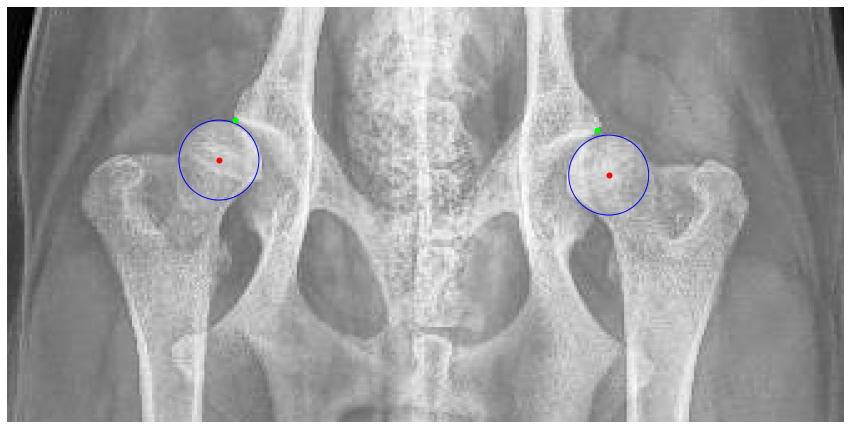

Processing /home/featurize/work/Dataset2/data/Testing/Images/359477.jpeg
center: [[[217  91]]

 [[486 108]]]
head: [[[208  58]]

 [[499  74]]]


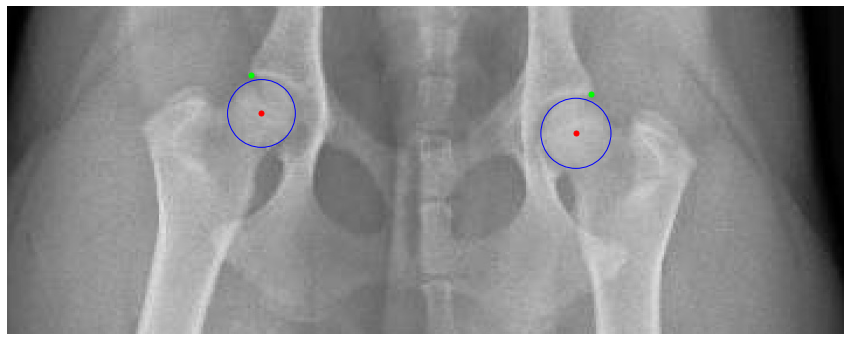

Processing /home/featurize/work/Dataset2/data/Testing/Images/320802.jpeg
center: [[[595 152]]

 [[293 154]]]
head: [[[286 118]]

 [[601 118]]]


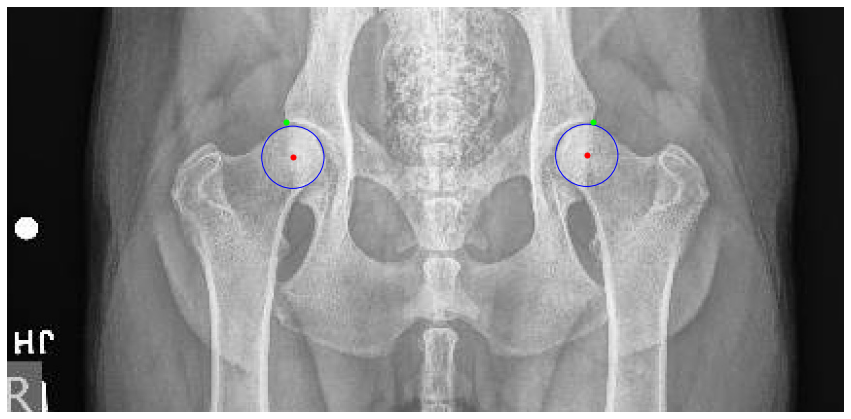

Processing /home/featurize/work/Dataset2/data/Testing/Images/362005.jpeg
center: [[[172 103]]

 [[426  95]]]
head: [[[164  73]]

 [[427  65]]]


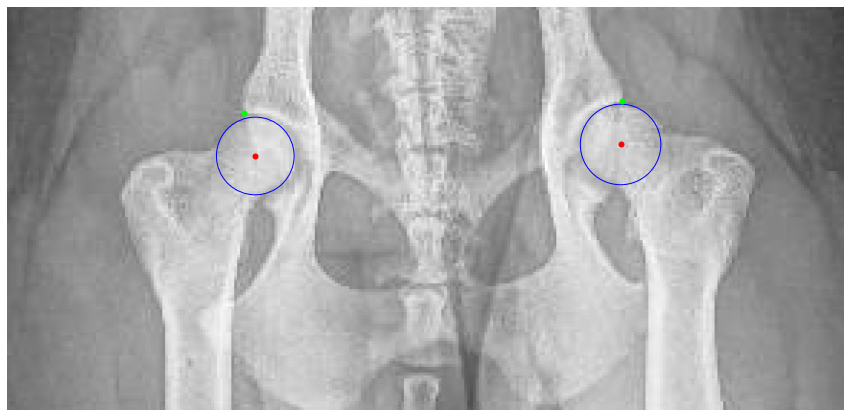

Processing /home/featurize/work/Dataset2/data/Testing/Images/362215.jpeg
center: [[[468 102]]

 [[195 117]]]
head: [[[478  64]]

 [[184  77]]]


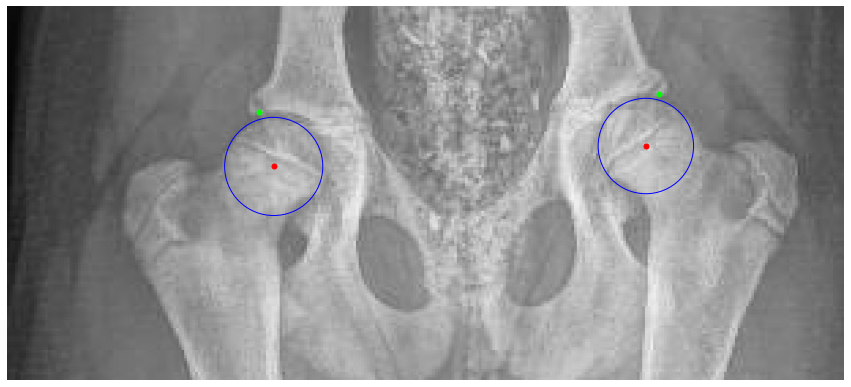

Processing /home/featurize/work/Dataset2/data/Testing/Images/351008.jpeg
center: [[[143 125]]

 [[393 108]]]
head: [[[138  88]]

 [[390  72]]]


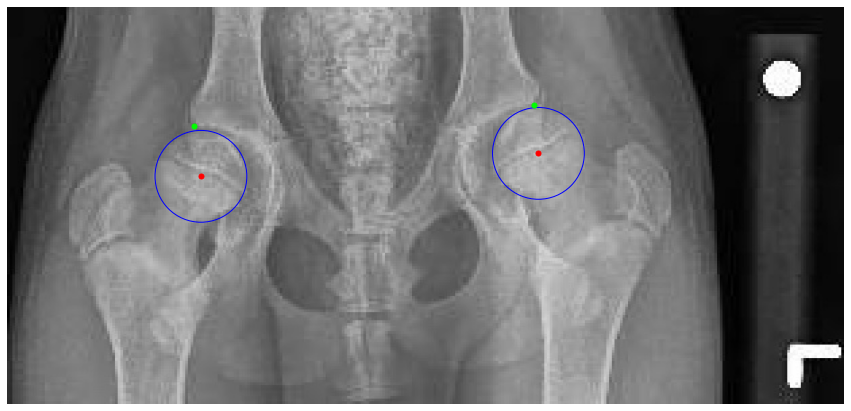

Processing /home/featurize/work/Dataset2/data/Testing/Images/356989.jpeg
center: [[[215 119]]

 [[518 113]]]
head: [[[223  91]]

 [[506  87]]]


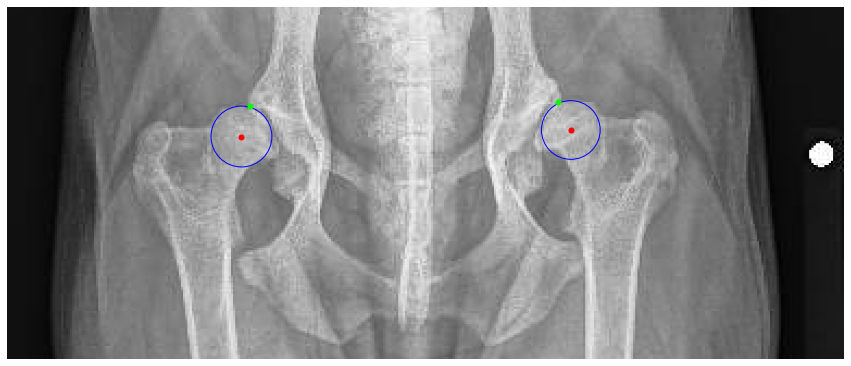

Processing /home/featurize/work/Dataset2/data/Testing/Images/331046.jpeg
center: [[[531 161]]

 [[212 168]]]
head: [[[545 126]]

 [[197 132]]]


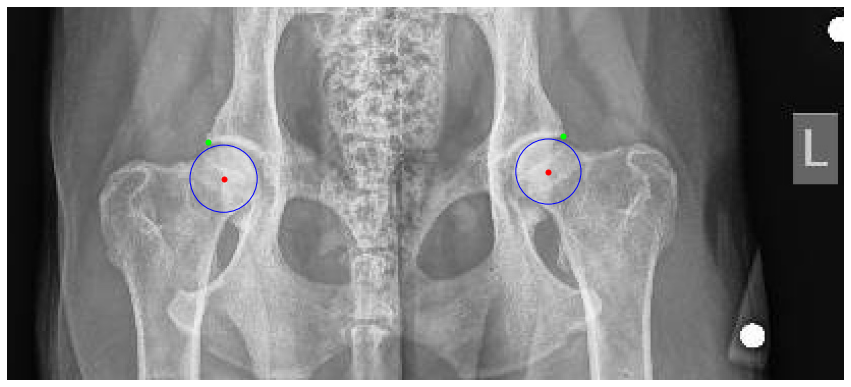

Processing /home/featurize/work/Dataset2/data/Testing/Images/324194.jpeg
center: [[[218 158]]

 [[488 147]]]
head: [[[202 124]]

 [[499 113]]]


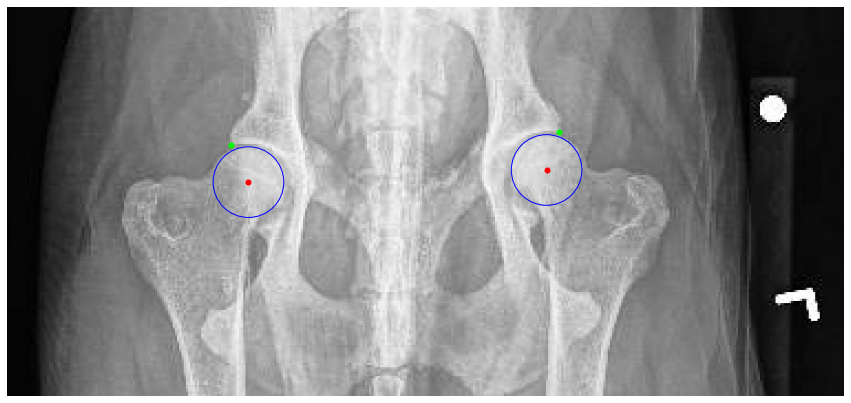

Processing /home/featurize/work/Dataset2/data/Testing/Images/342636.jpeg
center: [[[482 141]]

 [[216 141]]]
head: [[[468 118]]

 [[230 118]]]


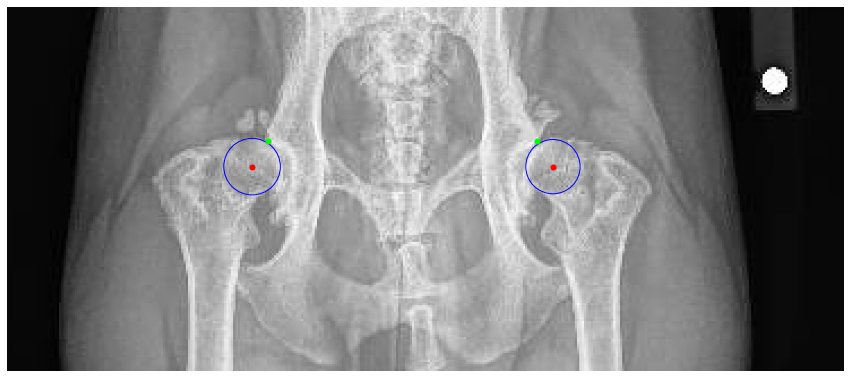

Processing /home/featurize/work/Dataset2/data/Testing/Images/361122.jpg
center: [[[1306  273]]

 [[ 356  159]]]
head: [[[1248  195]]

 [[ 466  139]]]


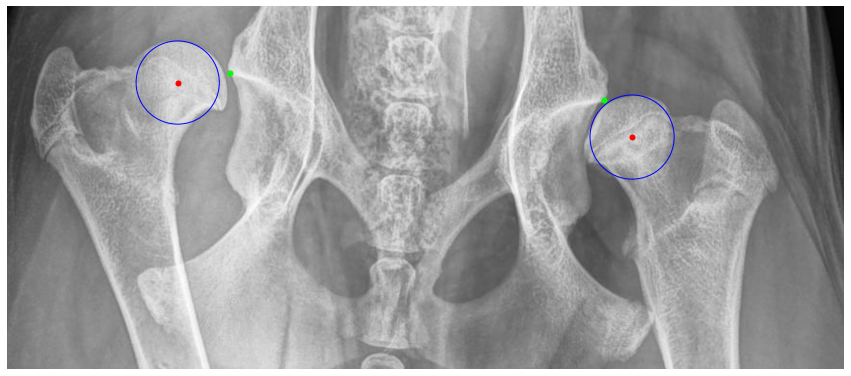

Processing /home/featurize/work/Dataset2/data/Testing/Images/363424.jpeg
center: [[[189 109]]

 [[459 103]]]
head: [[[178  77]]

 [[466  69]]]


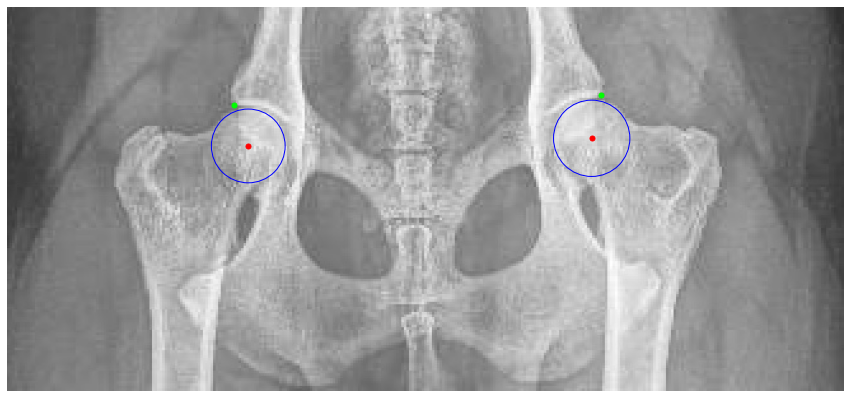

Processing /home/featurize/work/Dataset2/data/Testing/Images/351181.jpeg
center: [[[187 103]]

 [[458  86]]]
head: [[[191  71]]

 [[450  57]]]


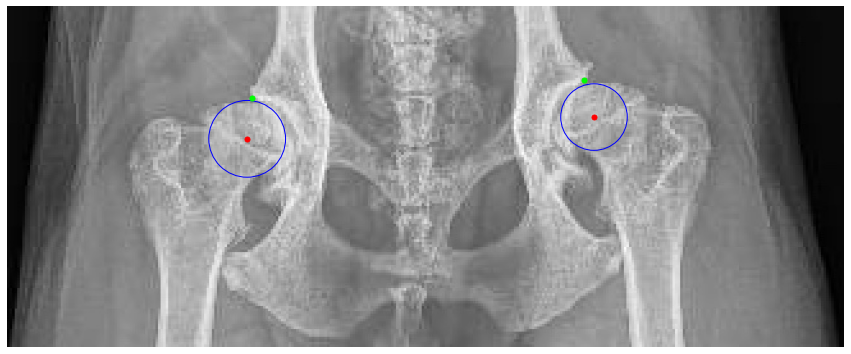

Processing /home/featurize/work/Dataset2/data/Testing/Images/282434.jpeg
center: [[[527 128]]

 [[255 122]]]
head: [[[535  94]]

 [[247  88]]]


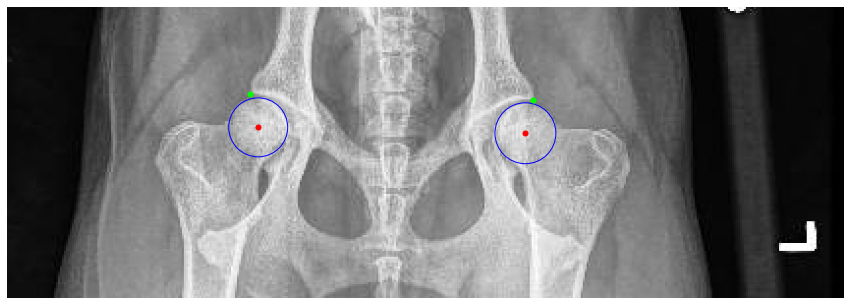

Processing /home/featurize/work/Dataset2/data/Testing/Images/281142.jpeg
center: [[[257 124]]

 [[596 135]]]
head: [[[586 101]]

 [[270  91]]]


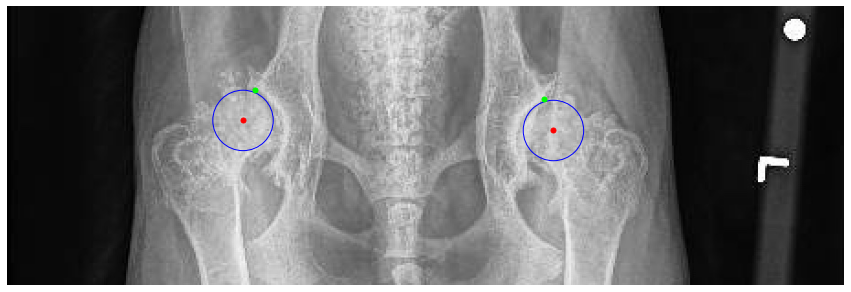

Processing /home/featurize/work/Dataset2/data/Testing/Images/359798.jpeg
center: [[[370 109]]

 [[141  89]]]
head: [[[379  81]]

 [[138  60]]]


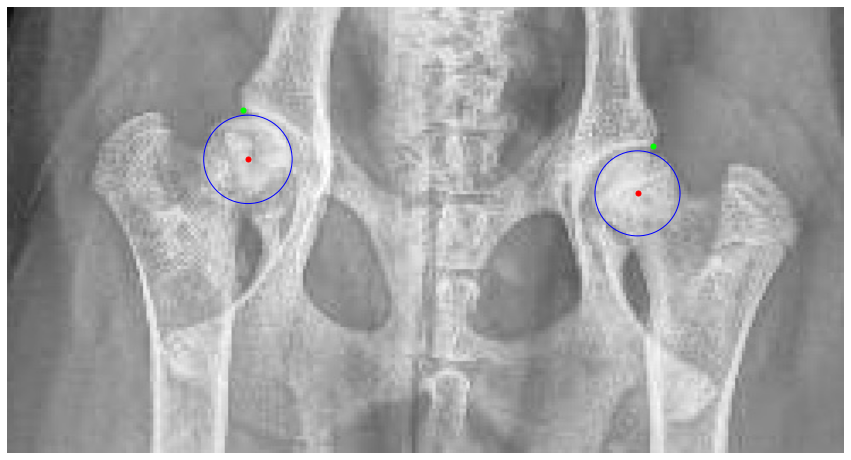

Processing /home/featurize/work/Dataset2/data/Testing/Images/293062.jpeg
center: [[[457 139]]

 [[197 122]]]
head: [[[189  89]]

 [[471 107]]]


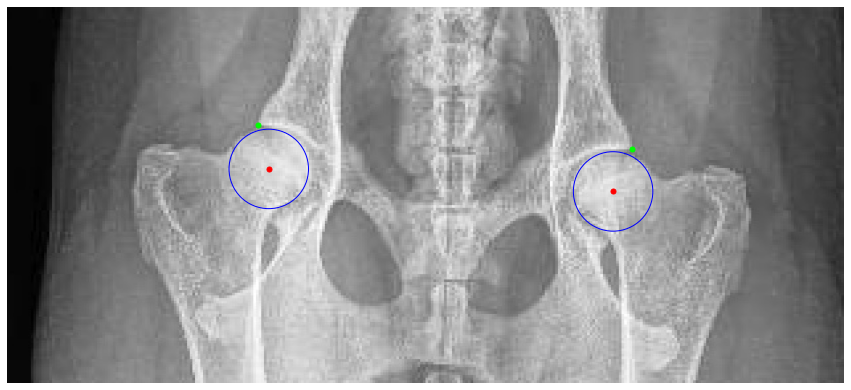

Processing /home/featurize/work/Dataset2/data/Testing/Images/308131.jpeg
center: [[[587 131]]

 [[290 140]]]
head: [[[596  96]]

 [[277 105]]]


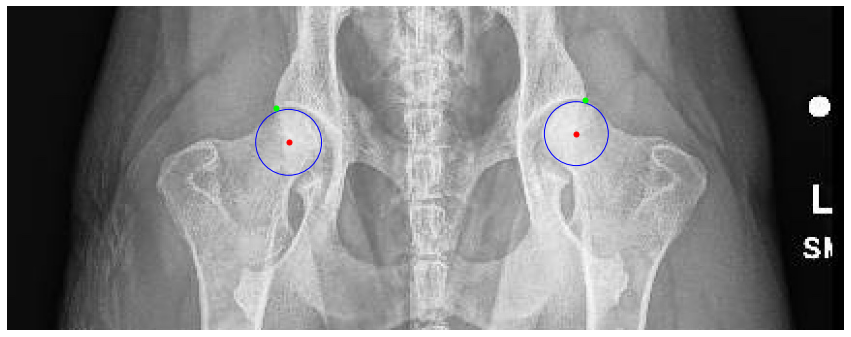

Processing /home/featurize/work/Dataset2/data/Testing/Images/332903.jpeg
center: [[[305 174]]

 [[552 169]]]
head: [[[299 146]]

 [[558 140]]]


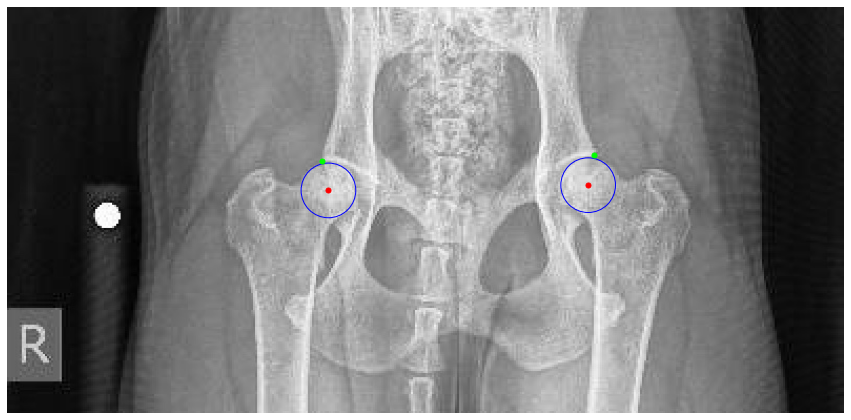

In [39]:
img_dir = '/home/featurize/work/Dataset2/data/Testing/Images'
image_files = [f for f in os.listdir(img_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

colors = [
    (255, 0, 0),    # 红色
    (0, 255, 0),    # 绿色
    (0, 0, 255),    # 蓝色
    (255, 255, 0),  # 黄色
]

for image_file in image_files:
    image_path = os.path.join(img_dir, image_file)
    print(f'Processing {image_path}')
    image = imread(image_path)
    
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    
    ## center
    detect_result_center = inference_detector(detector, image_path)
    
    CONF_THRES = 0.39

    pred_instance_center = detect_result_center.pred_instances.cpu().numpy()
    bboxes_center = np.concatenate((pred_instance_center.bboxes, pred_instance_center.scores[:, None]), axis=1)
    bboxes_center = bboxes_center[np.logical_and(pred_instance_center.labels == 0, pred_instance_center.scores > CONF_THRES)]
    bboxes_center = bboxes_center[nms(bboxes_center, 0.3)][:, :4].astype('int')
    
    if len(bboxes_center) > 0:
        pose_results_center = inference_topdown(pose_estimator, image_path, bboxes_center)
        
        try:
            data_samples_center = merge_data_samples(pose_results_center)
            center = data_samples_center.pred_instances.keypoints.astype('int')
            print(f'center: {center}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')
            continue
                
    ## head   
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    detect_result_head = inference_detector(detector2, image_path)
    
    CONF_THRES = 0.46

    pred_instance_head = detect_result_head.pred_instances.cpu().numpy()
    bboxes_head = np.concatenate((pred_instance_head.bboxes, pred_instance_head.scores[:, None]), axis=1)
    bboxes_head = bboxes_head[np.logical_and(pred_instance_head.labels == 0, pred_instance_head.scores > CONF_THRES)]
    bboxes_head = bboxes_head[nms(bboxes_head, 0.3)][:, :4].astype('int')
    
    if len(bboxes_head) > 0:
        pose_results_head = inference_topdown(pose_estimator2, image_path, bboxes_head)
        
        try:
            data_samples_head = merge_data_samples(pose_results_head)
            head = data_samples_head.pred_instances.keypoints.astype('int')
            print(f'head: {head}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')
            continue
        
    #####plot
    fig, ax = plt.subplots(figsize=(15, 15))  
    ax.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    ax.set_aspect('equal', 'box')

    # 绘制中心关键点和矩形框、圆圈
    if len(bboxes_center) > 0:
        for idx, bbox in enumerate(bboxes_center):
            keypoint = center[idx]
            #rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2] - bbox[0], bbox[3] - bbox[1], linewidth=1, edgecolor='g', facecolor='none')
            #ax.add_patch(rect)
            
            
            # 绘制关键点
            
            for x, y in keypoint:
                center_x = x
                center_y = y
                radius = min(bbox[2] - bbox[0], bbox[3] - bbox[1]) // 2
                circle = plt.Circle((center_x, center_y), radius, color='b', fill=False)
                ax.add_patch(circle)
                ax.plot(x, y, 'o', color=np.array(colors[0])/255.0, markersize=5)

    # 绘制头部关键点
    if len(bboxes_head) > 0:
        for idx, bbox in enumerate(bboxes_head):
            keypoint = head[idx]
            for x, y in keypoint:
                ax.plot(x, y, 'o', color=np.array(colors[1])/255.0, markersize=5)
    
    plt.axis('off')
    plt.show()

In [13]:
## Predict
def predict_and_plot(image_path, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center=0.39, conf_thres_head=0.46):
    print(f'Processing {image_path}')
    image = imread(image_path)

    colors = [
        (255, 0, 0),    # 红色
        (0, 255, 0),    # 绿色
        (0, 0, 255),    # 蓝色
        (255, 255, 0),  # 黄色
    ]

    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))

    ## center
    detect_result_center = inference_detector(detector, image_path)

    pred_instance_center = detect_result_center.pred_instances.cpu().numpy()
    bboxes_center = np.concatenate((pred_instance_center.bboxes, pred_instance_center.scores[:, None]), axis=1)
    bboxes_center = bboxes_center[np.logical_and(pred_instance_center.labels == 0, pred_instance_center.scores > conf_thres_center)]
    bboxes_center = bboxes_center[nms(bboxes_center, 0.3)][:, :4].astype('int')

    if len(bboxes_center) > 0:
        pose_results_center = inference_topdown(pose_estimator, image_path, bboxes_center)

        try:
            data_samples_center = merge_data_samples(pose_results_center)
            center = data_samples_center.pred_instances.keypoints.astype('int')
            #print(f'center: {center}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')

    ## head   
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    detect_result_head = inference_detector(detector2, image_path)

    pred_instance_head = detect_result_head.pred_instances.cpu().numpy()
    bboxes_head = np.concatenate((pred_instance_head.bboxes, pred_instance_head.scores[:, None]), axis=1)
    bboxes_head = bboxes_head[np.logical_and(pred_instance_head.labels == 0, pred_instance_head.scores > conf_thres_head)]
    bboxes_head = bboxes_head[nms(bboxes_head, 0.3)][:, :4].astype('int')

    if len(bboxes_head) > 0:
        pose_results_head = inference_topdown(pose_estimator2, image_path, bboxes_head)

        try:
            data_samples_head = merge_data_samples(pose_results_head)
            head = data_samples_head.pred_instances.keypoints.astype('int')
            #print(f'head: {head}')
        except ValueError as e:
            print(f'Error merging data samples: {e}')

    #####plot
    fig, ax = plt.subplots(figsize=(15, 15))  
    ax.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    ax.set_aspect('equal', 'box')

    # 绘制中心关键点和矩形框、圆圈
    if len(bboxes_center) > 0:
        for idx, bbox in enumerate(bboxes_center):
            keypoint = center[idx]
            for x, y in keypoint:
                center_x = x
                center_y = y
                radius = min(bbox[2] - bbox[0], bbox[3] - bbox[1]) // 2
                circle = plt.Circle((center_x, center_y), radius, color='b', fill=False)
                ax.add_patch(circle)
                ax.plot(x, y, 'o', color=np.array(colors[0])/255.0, markersize=5)

    # 
    if len(bboxes_head) > 0:
        for idx, bbox in enumerate(bboxes_head):
            keypoint = head[idx]
            for x, y in keypoint:
                ax.plot(x, y, 'o', color=np.array(colors[1])/255.0, markersize=5)

    plt.axis('off')
    plt.show()

Processing /home/featurize/work/Dataset2/data/Testing/Images/356926.jpeg


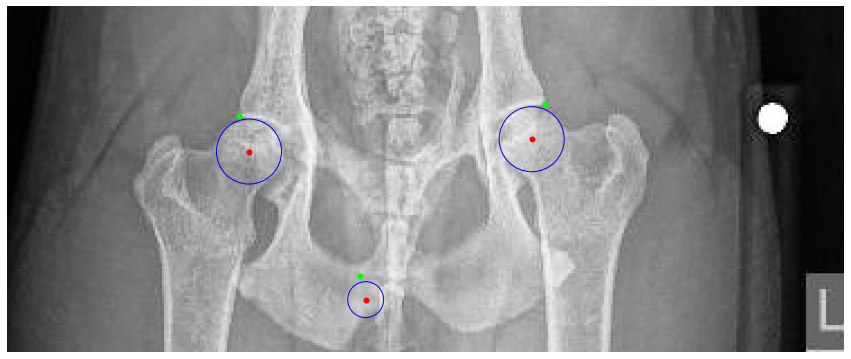

In [14]:
image_path = '/home/featurize/work/Dataset2/data/Testing/Images/356926.jpeg'
predict_and_plot(image_path, detector, detector2, pose_estimator, pose_estimator2, 
                 conf_thres_center=0.32, conf_thres_head=0.46)

Processing /home/featurize/work/Dataset2/data/Testing/Images/356926.jpeg


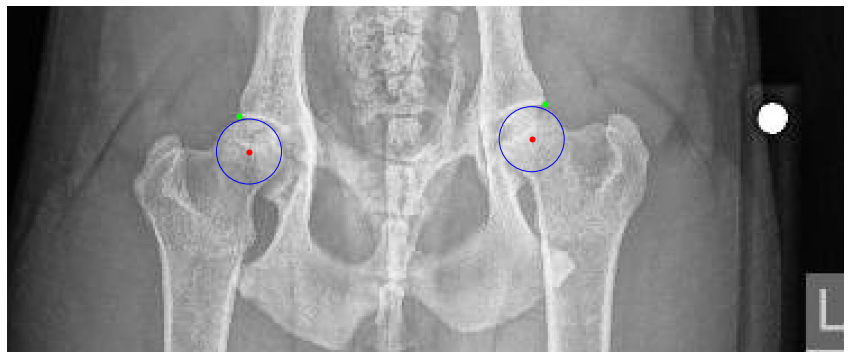

In [15]:
image_path = '/home/featurize/work/Dataset2/data/Testing/Images/356926.jpeg'
predict_and_plot(image_path, detector, detector2, pose_estimator, pose_estimator2, 
                 conf_thres_center=0.5, conf_thres_head=0.6)

In [16]:
def calculate_angle(center, head, opposite_center):
    """
    Calculate the angle formed by the three points: center1, head, and opposite_center.
    
    Parameters:
    - center1: The first center point.
    - head: The head point.
    - opposite_center: The opposite center point.
    
    Returns:
    - angle in degrees.
    """
    center = np.array(center)
    head = np.array(head)
    opposite_center = np.array(opposite_center)
    
    # Vector from center1 to head
    vector1 = head - center
    # Vector from center1 to opposite_center
    vector2 = opposite_center - center
    
    # Calculate the cosine of the angle using dot product and norms
    cos_angle = np.dot(vector1, vector2) / (np.linalg.norm(vector1) * np.linalg.norm(vector2))
    
    # Clamp the cosine value to the range [-1, 1] to avoid numerical issues
    cos_angle = np.clip(cos_angle, -1.0, 1.0)
    
    # Calculate the angle in radians and then convert to degrees
    angle = np.arccos(cos_angle)
    return np.degrees(angle)

def predict_and_save(image_path, mat_file_path, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center=0.32, conf_thres_head=0.5):
    image = imread(image_path)
    mat_data = scipy.io.loadmat(mat_file_path)
    four_points = mat_data['Four_points']

    left_head = four_points[2]
    right_head = four_points[3]
    center1 = four_points[0]
    center2 = four_points[1]
    radius1 = four_points[4][0]
    radius2 = four_points[4][1]
    angles = mat_data['Angles']
    
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))

    # Center detection
    detect_result_center = inference_detector(detector, image_path)
    pred_instance_center = detect_result_center.pred_instances.cpu().numpy()
    bboxes_center = np.concatenate((pred_instance_center.bboxes, pred_instance_center.scores[:, None]), axis=1)
    bboxes_center = bboxes_center[np.logical_and(pred_instance_center.labels == 0, pred_instance_center.scores > conf_thres_center)]
    bboxes_center = bboxes_center[nms(bboxes_center, 0.3)][:, :4].astype('int')

    centers_pred = []
    if len(bboxes_center) > 0:
        pose_results_center = inference_topdown(pose_estimator, image_path, bboxes_center)
        try:
            data_samples_center = merge_data_samples(pose_results_center)
            centers_pred = data_samples_center.pred_instances.keypoints.astype('int')
        except ValueError as e:
            print(f'Error merging data samples: {e}')

    # Head detection
    init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
    detect_result_head = inference_detector(detector2, image_path)
    pred_instance_head = detect_result_head.pred_instances.cpu().numpy()
    bboxes_head = np.concatenate((pred_instance_head.bboxes, pred_instance_head.scores[:, None]), axis=1)
    bboxes_head = bboxes_head[np.logical_and(pred_instance_head.labels == 0, pred_instance_head.scores > conf_thres_head)]
    bboxes_head = bboxes_head[nms(bboxes_head, 0.3)][:, :4].astype('int')

    heads_pred = []
    if len(bboxes_head) > 0:
        pose_results_head = inference_topdown(pose_estimator2, image_path, bboxes_head)
        try:
            data_samples_head = merge_data_samples(pose_results_head)
            heads_pred = data_samples_head.pred_instances.keypoints.astype('int')
        except ValueError as e:
            print(f'Error merging data samples: {e}')

    # Initialize DataFrame with ground truth values
    df = pd.DataFrame({
        'Image Path': [image_path],
        'Left Head X': [left_head[0]],
        'Left Head Y': [left_head[1]],
        'Right Head X': [right_head[0]],
        'Right Head Y': [right_head[1]],
        'Center1 X': [center1[0]],
        'Center1 Y': [center1[1]],
        'Center2 X': [center2[0]],
        'Center2 Y': [center2[1]],
        'Radius1': [radius1],
        'Radius2': [radius2],
        'Angle1': [angles[0][0]],
        'Angle2': [angles[0][1]],
        'Pred Left Head X': [np.nan],
        'Pred Left Head Y': [np.nan],
        'Pred Right Head X': [np.nan],
        'Pred Right Head Y': [np.nan],
        'Pred Center1 X': [np.nan],
        'Pred Center1 Y': [np.nan],
        'Pred Center2 X': [np.nan],
        'Pred Center2 Y': [np.nan],
        'Pred Radius1': [np.nan],
        'Pred Radius2': [np.nan],
        'Pred Angle1': [np.nan],
        'Pred Angle2': [np.nan]
    })

    # Update DataFrame with predicted values if predictions are available
    if len(centers_pred) >= 2 and len(heads_pred) >= 2:
        # 将预测的点按照x坐标进行排序，确保左边的为left，右边的为right
        centers_pred = sorted(centers_pred, key=lambda p: p[0, 0])
        heads_pred = sorted(heads_pred, key=lambda p: p[0, 0])

        predicted_radius1 = min(bboxes_center[0][2] - bboxes_center[0][0], bboxes_center[0][3] - bboxes_center[0][1]) // 2
        predicted_radius2 = min(bboxes_center[1][2] - bboxes_center[1][0], bboxes_center[1][3] - bboxes_center[1][1]) // 2
        predicted_angle1 = calculate_angle(centers_pred[0][0],heads_pred[0][0], centers_pred[1][0])
        predicted_angle2 = calculate_angle(centers_pred[1][0], heads_pred[1][0], centers_pred[0][0])

        pred_left_head = heads_pred[0][0]
        pred_right_head = heads_pred[1][0]
        pred_center1 = centers_pred[0][0]
        pred_center2 = centers_pred[1][0]

        df.loc[0, 'Pred Left Head X'] = pred_left_head[0]
        df.loc[0, 'Pred Left Head Y'] = pred_left_head[1]
        df.loc[0, 'Pred Right Head X'] = pred_right_head[0]
        df.loc[0, 'Pred Right Head Y'] = pred_right_head[1]
        df.loc[0, 'Pred Center1 X'] = pred_center1[0]
        df.loc[0, 'Pred Center1 Y'] = pred_center1[1]
        df.loc[0, 'Pred Center2 X'] = pred_center2[0]
        df.loc[0, 'Pred Center2 Y'] = pred_center2[1]
        df.loc[0, 'Pred Radius1'] = predicted_radius1
        df.loc[0, 'Pred Radius2'] = predicted_radius2
        df.loc[0, 'Pred Angle1'] = predicted_angle1
        df.loc[0, 'Pred Angle2'] = predicted_angle2

    return df

def process_all_images_and_save(image_dir, label_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center=0.32, conf_thres_head=0.5, output_dir='/home/featurize/work/Result'):
    image_files = [f for f in os.listdir(image_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    all_dfs = []

    for image_file in image_files:
        image_path = os.path.join(image_dir, image_file)
        mat_file_path = os.path.join(label_dir, os.path.splitext(image_file)[0] + '.mat')
        if os.path.exists(mat_file_path):
            df = predict_and_save(image_path, mat_file_path, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center, conf_thres_head)
            all_dfs.append(df)
        else:
            print(f'MAT file for image {image_file} not found.')

    # Combine all dataframes and save to CSV
    final_df = pd.concat(all_dfs, ignore_index=True)
    final_df.to_csv(os.path.join(output_dir, 'predictions.csv'), index=False)

# Example usage
#image_dir = '/home/featurize/work/Dataset2/data/Testing/Images'
#label_dir = '/home/featurize/work/Dataset2/data/Testing/Labels'
#process_all_images_and_save(image_dir, label_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center=0.39, conf_thres_head=0.46, output_dir='/home/featurize/work/Result')


In [25]:
## use different confidience threshold to compute best point

def calculate_angle(center, head, opposite_center):
    """
    Calculate the angle formed by the three points: center1, head, and opposite_center.
    
    Parameters:
    - center1: The first center point.
    - head: The head point.
    - opposite_center: The opposite center point.
    
    Returns:
    - angle in degrees.
    """
    center = np.array(center)
    head = np.array(head)
    opposite_center = np.array(opposite_center)
    
    # Vector from center1 to head
    vector1 = head - center
    # Vector from center1 to opposite_center
    vector2 = opposite_center - center
    
    # Calculate the cosine of the angle using dot product and norms
    cos_angle = np.dot(vector1, vector2) / (np.linalg.norm(vector1) * np.linalg.norm(vector2))
    
    # Clamp the cosine value to the range [-1, 1] to avoid numerical issues
    cos_angle = np.clip(cos_angle, -1.0, 1.0)
    
    # Calculate the angle in radians and then convert to degrees
    angle = np.arccos(cos_angle)
    return np.degrees(angle)

def calculate_error(pred_points, true_points):
    return np.mean(np.linalg.norm(pred_points - true_points, axis=1))

def predict_and_save(image_path, mat_file_path, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range):
    image = imread(image_path)
    mat_data = scipy.io.loadmat(mat_file_path)
    four_points = mat_data['Four_points']

    left_head = four_points[2]
    right_head = four_points[3]
    center1 = four_points[0]
    center2 = four_points[1]
    radius1 = four_points[4][0]
    radius2 = four_points[4][1]
    Angles = mat_data['Angles']
    
    best_df = None
    best_error = float('inf')

    for conf_thres_center in conf_thres_center_range:
        for conf_thres_head in conf_thres_head_range:
            init_default_scope(detector.cfg.get('default_scope', 'mmdet'))

            # Center detection
            detect_result_center = inference_detector(detector, image_path)
            pred_instance_center = detect_result_center.pred_instances.cpu().numpy()
            bboxes_center = np.concatenate((pred_instance_center.bboxes, pred_instance_center.scores[:, None]), axis=1)
            bboxes_center = bboxes_center[np.logical_and(pred_instance_center.labels == 0, pred_instance_center.scores > conf_thres_center)]
            bboxes_center = bboxes_center[nms(bboxes_center, 0.3)][:, :4].astype('int')

            centers_pred = []
            if len(bboxes_center) > 0:
                pose_results_center = inference_topdown(pose_estimator, image_path, bboxes_center)
                try:
                    data_samples_center = merge_data_samples(pose_results_center)
                    centers_pred = data_samples_center.pred_instances.keypoints.astype('int')
                except ValueError as e:
                    print(f'Error merging data samples: {e}')

            # Head detection
            init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
            detect_result_head = inference_detector(detector2, image_path)
            pred_instance_head = detect_result_head.pred_instances.cpu().numpy()
            bboxes_head = np.concatenate((pred_instance_head.bboxes, pred_instance_head.scores[:, None]), axis=1)
            bboxes_head = bboxes_head[np.logical_and(pred_instance_head.labels == 0, pred_instance_head.scores > conf_thres_head)]
            bboxes_head = bboxes_head[nms(bboxes_head, 0.3)][:, :4].astype('int')

            heads_pred = []
            if len(bboxes_head) > 0:
                pose_results_head = inference_topdown(pose_estimator2, image_path, bboxes_head)
                try:
                    data_samples_head = merge_data_samples(pose_results_head)
                    heads_pred = data_samples_head.pred_instances.keypoints.astype('int')
                except ValueError as e:
                    print(f'Error merging data samples: {e}')

            # Initialize DataFrame with ground truth values
            df = pd.DataFrame({
                'Image Path': [image_path],
                'Left Head X': [left_head[0]],
                'Left Head Y': [left_head[1]],
                'Right Head X': [right_head[0]],
                'Right Head Y': [right_head[1]],
                'Center1 X': [center1[0]],
                'Center1 Y': [center1[1]],
                'Center2 X': [center2[0]],
                'Center2 Y': [center2[1]],
                'Radius1': [radius1],
                'Radius2': [radius2],
                'Angle1': [Angles[0][0]],
                'Angle2': [Angles[0][1]],
                'Pred Left Head X': [np.nan],
                'Pred Left Head Y': [np.nan],
                'Pred Right Head X': [np.nan],
                'Pred Right Head Y': [np.nan],
                'Pred Center1 X': [np.nan],
                'Pred Center1 Y': [np.nan],
                'Pred Center2 X': [np.nan],
                'Pred Center2 Y': [np.nan],
                'Pred Radius1': [np.nan],
                'Pred Radius2': [np.nan],
                'Pred Angle1': [np.nan],
                'Pred Angle2': [np.nan]
            })

            # Update DataFrame with predicted values if predictions are available
            if len(centers_pred) >= 2 and len(heads_pred) >= 2:
                # 将预测的点按照x坐标进行排序，确保左边的为left，右边的为right
                centers_pred = sorted(centers_pred, key=lambda p: p[0, 0])
                heads_pred = sorted(heads_pred, key=lambda p: p[0, 0])

                predicted_radius1 = min(bboxes_center[0][2] - bboxes_center[0][0], bboxes_center[0][3] - bboxes_center[0][1]) // 2
                predicted_radius2 = min(bboxes_center[1][2] - bboxes_center[1][0], bboxes_center[1][3] - bboxes_center[1][1]) // 2
                predicted_angle1 = calculate_angle(centers_pred[0][0],heads_pred[0][0], centers_pred[1][0])
                predicted_angle2 = calculate_angle(centers_pred[1][0], heads_pred[1][0], centers_pred[0][0])


                pred_left_head = heads_pred[0][0]
                pred_right_head = heads_pred[1][0]
                pred_center1 = centers_pred[0][0]
                pred_center2 = centers_pred[1][0]

                df.loc[0, 'Pred Left Head X'] = pred_left_head[0]
                df.loc[0, 'Pred Left Head Y'] = pred_left_head[1]
                df.loc[0, 'Pred Right Head X'] = pred_right_head[0]
                df.loc[0, 'Pred Right Head Y'] = pred_right_head[1]
                df.loc[0, 'Pred Center1 X'] = pred_center1[0]
                df.loc[0, 'Pred Center1 Y'] = pred_center1[1]
                df.loc[0, 'Pred Center2 X'] = pred_center2[0]
                df.loc[0, 'Pred Center2 Y'] = pred_center2[1]
                df.loc[0, 'Pred Radius1'] = predicted_radius1
                df.loc[0, 'Pred Radius2'] = predicted_radius2
                df.loc[0, 'Pred Angle1'] = predicted_angle1
                df.loc[0, 'Pred Angle2'] = predicted_angle2

                # Calculate prediction error
                pred_points = np.array([pred_left_head, pred_right_head, pred_center1, pred_center2])
                true_points = np.array([left_head, right_head, center1, center2])
                error = calculate_error(pred_points, true_points)

                if error < best_error:
                    best_error = error
                    best_df = df

    return best_df

def process_all_images_and_save(image_dir, label_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range, output_dir):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    all_dfs = []
    for image_file in os.listdir(image_dir):
        image_path = os.path.join(image_dir, image_file)
        mat_file_path = os.path.join(label_dir, os.path.splitext(image_file)[0] + '.mat')
        if os.path.exists(mat_file_path):
            df = predict_and_save(image_path, mat_file_path, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range)
            if df is not None:
                all_dfs.append(df)

    if all_dfs:
        final_df = pd.concat(all_dfs, ignore_index=True)
        output_path = os.path.join(output_dir, 'predictions.csv')
        final_df.to_csv(output_path, index=False)

# Example usage
image_dir = '/home/featurize/work/Dataset2/data/Testing/Images'
label_dir = '/home/featurize/work/Dataset2/data/Testing/Labels'
conf_thres_center_range = np.arange(0.3, 0.5, 0.05)
conf_thres_head_range = np.arange(0.3, 0.5, 0.05)
output_dir = '/home/featurize/work/Result'

#process_all_images_and_save(image_dir, label_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range, output_dir)

In [31]:
df= pd.read_csv('/home/featurize/work/Result/csv/predictions.csv')
df

,Image Path,Left Head X,Left Head Y,Right Head X,Right Head Y,Center1 X,Center1 Y,Center2 X,Center2 Y,Radius1,...,Pred Right Head X,Pred Right Head Y,Pred Center1 X,Pred Center1 Y,Pred Center2 X,Pred Center2 Y,Pred Radius1,Pred Radius2,Pred Angle1,Pred Angle2
0,/home/featurize/work/Dataset2/data/Testing/Ima...,242.723324,105.867347,517.722741,136.778134,225.136152,129.849854,526.249854,166.623032,25.636796,...,517.0,139.0,221.0,130.0,525.0,166.0,27.0,26.0,53.150755,66.742065
1,/home/featurize/work/Dataset2/data/Testing/Ima...,181.967638,103.735569,451.637609,111.196793,167.578134,92.010787,480.949563,104.801458,23.887574,...,458.0,112.0,164.0,92.0,480.0,107.0,26.0,24.0,30.972371,15.521962
2,/home/featurize/work/Dataset2/data/Testing/Ima...,345.048688,138.909913,684.001458,148.502915,316.269679,172.485423,696.259184,192.737318,37.401170,...,683.0,153.0,317.0,171.0,696.0,193.0,38.0,37.0,53.516577,68.673690
3,/home/featurize/work/Dataset2/data/Testing/Ima...,199.021866,111.196793,449.505831,120.789796,204.351312,142.640525,437.248105,152.766472,26.780135,...,448.0,124.0,203.0,143.0,436.0,152.0,26.0,27.0,103.521974,110.986549
4,/home/featurize/work/Dataset2/data/Testing/Ima...,290.688338,110.130904,617.916327,116.526239,297.616618,150.634694,606.191545,159.694752,35.146070,...,616.0,120.0,295.0,150.0,604.0,157.0,34.0,35.0,103.978124,106.671399
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116,/home/featurize/work/Dataset2/data/Testing/Ima...,271.242046,86.877472,587.173259,97.880052,257.881771,129.315993,596.604041,136.389080,32.489087,...,586.0,101.0,257.0,124.0,596.0,135.0,33.0,33.0,70.357069,71.751957
117,/home/featurize/work/Dataset2/data/Testing/Ima...,141.463848,57.902332,381.288921,80.286006,142.529738,88.813120,371.695918,111.196793,24.538612,...,379.0,81.0,141.0,89.0,370.0,109.0,25.0,26.0,100.897474,102.827556
118,/home/featurize/work/Dataset2/data/Testing/Ima...,191.560641,88.813120,471.889504,105.867347,197.955977,120.789796,456.434111,139.975802,30.185561,...,471.0,107.0,197.0,122.0,457.0,139.0,30.0,30.0,107.367932,109.888440
119,/home/featurize/work/Dataset2/data/Testing/Ima...,278.963557,103.735569,597.664431,94.142566,292.287172,141.041691,588.071429,132.514577,34.460546,...,596.0,96.0,290.0,140.0,587.0,131.0,33.0,34.0,108.640731,106.156478


In [36]:
# delta_angle

df['Delta Angle1'] = abs(df['Angle1'] - df['Pred Angle1'])
df['Delta Angle2'] = abs(df['Angle2'] - df['Pred Angle2'])

percentage_less_than_1_degree = (
    ((df['Delta Angle1'] < 1).sum() + (df['Delta Angle2'] < 1).sum()) / (2 * len(df))
) * 100

# 计算误差小于5度的百分比
percentage_less_than_5_degrees = (
    ((df['Delta Angle1'] < 5).sum() + (df['Delta Angle2'] < 5).sum()) / (2 * len(df))
) * 100

# 计算误差小于10度的百分比
percentage_less_than_10_degrees = (
    ((df['Delta Angle1'] < 10).sum() + (df['Delta Angle2'] < 10).sum()) / (2 * len(df))
) * 100

print(f"Percentage of angles with less than 1 degree error: {percentage_less_than_1_degree:.2f}%")
print(f"Percentage of angles with less than 5 degrees error: {percentage_less_than_5_degrees:.2f}%")
print(f"Percentage of angles with less than 10 degrees error: {percentage_less_than_10_degrees:.2f}%")

angle1_under_5 = (df['Delta Angle1'] < 5).sum()
angle2_under_5 = (df['Delta Angle2'] < 5).sum()
total_entries = len(df)

percentage_angle1_under_5 = (angle1_under_5 / total_entries) * 100
percentage_angle2_under_5 = (angle2_under_5 / total_entries) * 100

print(f"Percentage of Delta Angle1 < 5: {percentage_angle1_under_5:.2f}%")
print(f"Percentage of Delta Angle2 < 5: {percentage_angle2_under_5:.2f}%")

angle1_under_10 = (df['Delta Angle1'] < 10).sum()
angle2_under_10 = (df['Delta Angle2'] < 10).sum()

percentage_angle1_under_10 = (angle1_under_10 / total_entries) * 100
percentage_angle2_under_10 = (angle2_under_10 / total_entries) * 100

print(f"Percentage of Delta Angle1 < 10: {percentage_angle1_under_10:.2f}%")
print(f"Percentage of Delta Angle2 < 10: {percentage_angle2_under_10:.2f}%")

Percentage of angles with less than 1 degree error: 17.77%
Percentage of angles with less than 5 degrees error: 82.23%
Percentage of angles with less than 10 degrees error: 98.35%
Percentage of Delta Angle1 < 5: 82.64%
Percentage of Delta Angle2 < 5: 81.82%
Percentage of Delta Angle1 < 10: 97.52%
Percentage of Delta Angle2 < 10: 99.17%


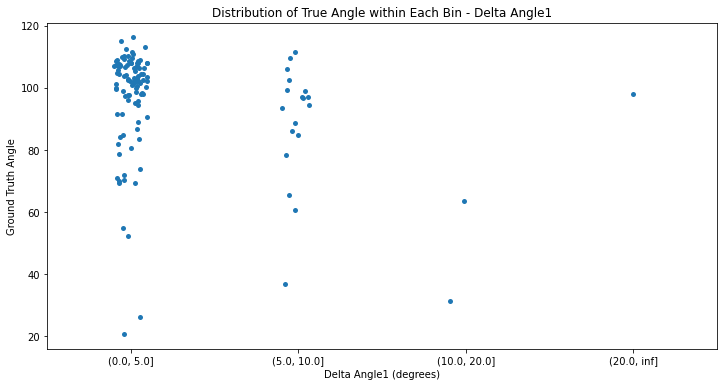

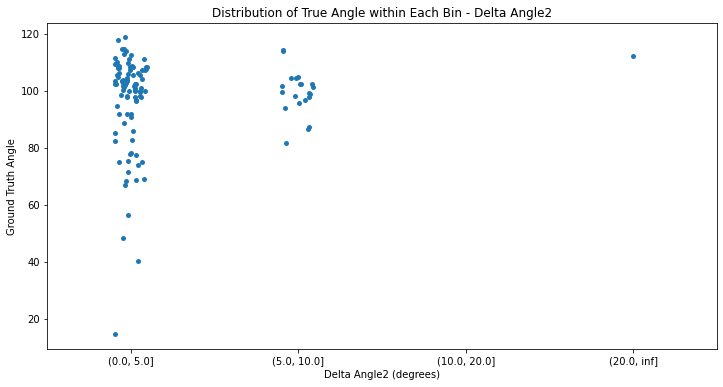

In [33]:
import seaborn as sns
df['Delta Angle1 Bin'] = pd.cut(df['Delta Angle1'], bins=[0, 5, 10, 20, float('inf')])
df['Delta Angle2 Bin'] = pd.cut(df['Delta Angle2'], bins=[0, 5, 10, 20, float('inf')])

# Delta Angle1
plt.figure(figsize=(12, 6))
sns.stripplot(x='Delta Angle1 Bin', y='Angle1', data=df, jitter=True)
plt.xlabel('Delta Angle1 (degrees)')
plt.ylabel('Ground Truth Angle')
plt.title('Distribution of True Angle within Each Bin - Delta Angle1')
plt.show()

# Delta Angle2
plt.figure(figsize=(12, 6))
sns.stripplot(x='Delta Angle2 Bin', y='Angle2', data=df, jitter=True)
plt.xlabel('Delta Angle2 (degrees)')
plt.ylabel('Ground Truth Angle')
plt.title('Distribution of True Angle within Each Bin - Delta Angle2')
plt.show()


In [34]:
from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error, r2_score,mean_absolute_error

# mae
mae_angle1 = mean_absolute_error(df['Angle1'], df['Pred Angle1'])
mae_angle2 = mean_absolute_error(df['Angle2'], df['Pred Angle2'])
combined_angles_true = df[['Angle1', 'Angle2']].values.flatten()
combined_angles_pred = df[['Pred Angle1', 'Pred Angle2']].values.flatten()
mae_combined_angles = mean_absolute_error(combined_angles_true, combined_angles_pred)


print(f"MAE for Angle1: {mae_angle1}")
print(f"MAE for Angle2: {mae_angle2}")
print(f"MAE for all Angles: {mae_combined_angles}")


# mse
mse_point = mean_squared_error(df[['Left Head X', 'Left Head Y', 'Right Head X', 'Right Head Y', 'Center1 X', 'Center1 Y', 'Center2 X', 'Center2 Y']],
                               df[['Pred Left Head X', 'Pred Left Head Y', 'Pred Right Head X', 'Pred Right Head Y', 'Pred Center1 X', 'Pred Center1 Y', 'Pred Center2 X', 'Pred Center2 Y']])

mse_angle = mean_squared_error(df[['Angle1', 'Angle2']],
                               df[['Pred Angle1', 'Pred Angle2']])

mse_radius = mean_squared_error(df[['Radius1', 'Radius2']],
                                df[['Pred Radius1', 'Pred Radius2']])

# MAPE
mape_point = mean_absolute_percentage_error(df[['Left Head X', 'Left Head Y', 'Right Head X', 'Right Head Y', 'Center1 X', 'Center1 Y', 'Center2 X', 'Center2 Y']],
                                            df[['Pred Left Head X', 'Pred Left Head Y', 'Pred Right Head X', 'Pred Right Head Y', 'Pred Center1 X', 'Pred Center1 Y', 'Pred Center2 X','Pred Center2 Y']])

mape_angle = mean_absolute_percentage_error(df[['Angle1', 'Angle2']],
                                            df[['Pred Angle1', 'Pred Angle2']])

mape_radius = mean_absolute_percentage_error(df[['Radius1', 'Radius2']],
                                             df[['Pred Radius1', 'Pred Radius2']])

# R2
r2_head_left = r2_score(df[['Left Head X', 'Left Head Y']],
                        df[['Pred Left Head X', 'Pred Left Head Y']])

r2_head_right = r2_score(df[['Right Head X', 'Right Head Y']],
                         df[['Pred Right Head X', 'Pred Right Head Y']])

r2_center1 = r2_score(df[['Center1 X', 'Center1 Y']],
                      df[['Pred Center1 X', 'Pred Center1 Y']])

r2_center2 = r2_score(df[['Center2 X', 'Center2 Y']],
                      df[['Pred Center2 X', 'Pred Center2 Y']])

r2_angle = r2_score(df[['Angle1', 'Angle2']],
                    df[['Pred Angle1', 'Pred Angle2']])



print(f"MSE Point: {mse_point}")
print(f"MSE Angle: {mse_angle}")
print(f"MSE Radius: {mse_radius}")
print(f"MAPE Point: {mape_point}")
print(f"MAPE Angle: {mape_angle}")
print(f"MAPE Radius: {mape_radius}")
print(f"R2 Head Left: {r2_head_left}")
print(f"R2 Head Right: {r2_head_right}")
print(f"R2 Center1: {r2_center1}")
print(f"R2 Center2: {r2_center2}")
print(f"R2 Angle: {r2_angle}")

MAE for Angle1: 3.809560938449397
MAE for Angle2: 3.787613241041376
MAE for all Angles: 3.7985870897453866
MSE Point: 105.12081577395784
MSE Angle: 62.3164922658606
MSE Radius: 7.119622813066606
MAPE Point: 0.016169012386889448
MAPE Angle: 0.04232546634373981
MAPE Radius: 0.03788413866573452
R2 Head Left: 0.9946577780375185
R2 Head Right: 0.9587374937364361
R2 Center1: 0.9984643828538642
R2 Center2: 0.9784008208772912
R2 Angle: 0.7716349629375603


File: 341649.jpeg


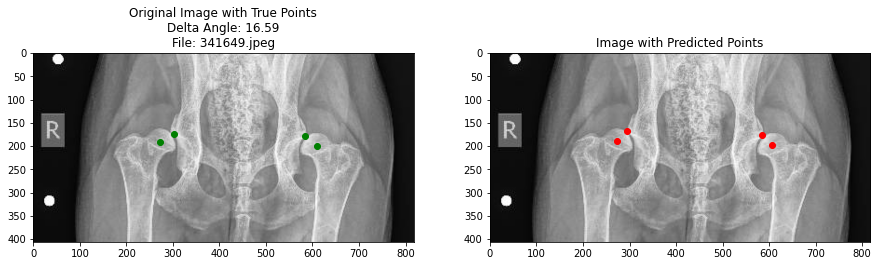

File: 356926.jpeg


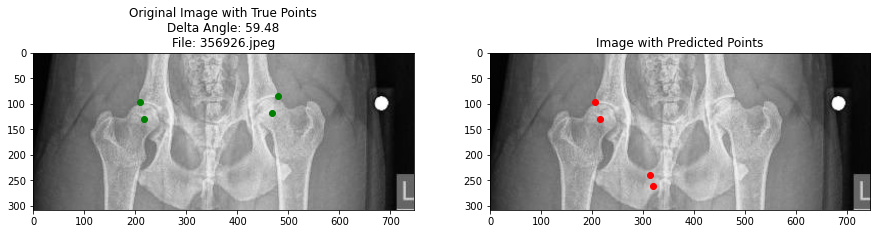

File: 357274.jpeg


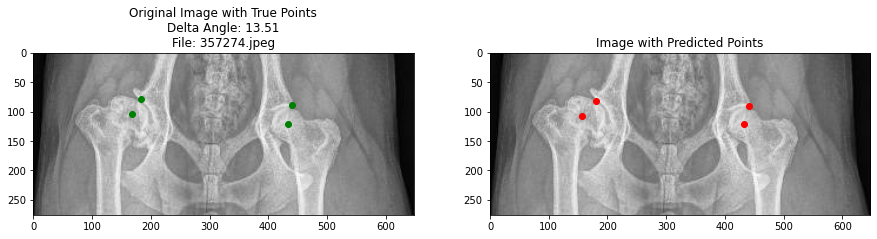

In [28]:
filtered_df = df[(df['Delta Angle1'] > 10)]


for index, row in filtered_df.iterrows():
    image_path = row['Image Path']
    image_name = os.path.basename(image_path)
    image = cv2.imread(image_path)
    print(f'File: {image_name}')

    true_points = np.array([
        [row['Left Head X'], row['Left Head Y']],
        [row['Right Head X'], row['Right Head Y']],
        [row['Center1 X'], row['Center1 Y']],
        [row['Center2 X'], row['Center2 Y']]
    ], dtype=int)
    

    pred_points = np.array([
        [row['Pred Left Head X'], row['Pred Left Head Y']],
        [row['Pred Right Head X'], row['Pred Right Head Y']],
        [row['Pred Center1 X'], row['Pred Center1 Y']],
        [row['Pred Center2 X'], row['Pred Center2 Y']]
    ], dtype=int)
    
    fig, ax = plt.subplots(1, 2, figsize=(15, 7))
    

    ax[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    for point in true_points:
        ax[0].plot(point[0], point[1], 'go')  
    
    ax[0].set_title(f'Original Image with True Points\nDelta Angle: {row["Delta Angle1"]:.2f}\nFile: {image_name}')
    

    ax[1].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    for point in pred_points:
        ax[1].plot(point[0], point[1], 'ro') 
    
    ax[1].set_title('Image with Predicted Points')
    
    plt.show()

In [18]:
def predict_image_only(image_path, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range):
    image = imread(image_path)
    
    best_df = None

    for conf_thres_center in conf_thres_center_range:
        for conf_thres_head in conf_thres_head_range:
            init_default_scope(detector.cfg.get('default_scope', 'mmdet'))

            # Center detection
            detect_result_center = inference_detector(detector, image_path)
            pred_instance_center = detect_result_center.pred_instances.cpu().numpy()
            bboxes_center = np.concatenate((pred_instance_center.bboxes, pred_instance_center.scores[:, None]), axis=1)
            bboxes_center = bboxes_center[np.logical_and(pred_instance_center.labels == 0, pred_instance_center.scores > conf_thres_center)]
            bboxes_center = bboxes_center[nms(bboxes_center, 0.3)][:, :4].astype('int')

            centers_pred = []
            if len(bboxes_center) > 0:
                pose_results_center = inference_topdown(pose_estimator, image_path, bboxes_center)
                try:
                    data_samples_center = merge_data_samples(pose_results_center)
                    centers_pred = data_samples_center.pred_instances.keypoints.astype('int')
                except ValueError as e:
                    print(f'Error merging data samples: {e}')

            # Head detection
            init_default_scope(detector.cfg.get('default_scope', 'mmdet'))
            detect_result_head = inference_detector(detector2, image_path)
            pred_instance_head = detect_result_head.pred_instances.cpu().numpy()
            bboxes_head = np.concatenate((pred_instance_head.bboxes, pred_instance_head.scores[:, None]), axis=1)
            bboxes_head = bboxes_head[np.logical_and(pred_instance_head.labels == 0, pred_instance_head.scores > conf_thres_head)]
            bboxes_head = bboxes_head[nms(bboxes_head, 0.3)][:, :4].astype('int')

            heads_pred = []
            if len(bboxes_head) > 0:
                pose_results_head = inference_topdown(pose_estimator2, image_path, bboxes_head)
                try:
                    data_samples_head = merge_data_samples(pose_results_head)
                    heads_pred = data_samples_head.pred_instances.keypoints.astype('int')
                except ValueError as e:
                    print(f'Error merging data samples: {e}')

            # Initialize DataFrame with predicted values
            df = pd.DataFrame({
                'Image Path': [image_path],
                'Pred Left Head X': [np.nan],
                'Pred Left Head Y': [np.nan],
                'Pred Right Head X': [np.nan],
                'Pred Right Head Y': [np.nan],
                'Pred Center1 X': [np.nan],
                'Pred Center1 Y': [np.nan],
                'Pred Center2 X': [np.nan],
                'Pred Center2 Y': [np.nan],
                'Pred Radius1': [np.nan],
                'Pred Radius2': [np.nan],
                'Pred Angle1': [np.nan],
                'Pred Angle2': [np.nan]
            })

            # Update DataFrame with predicted values if predictions are available
            if len(centers_pred) >= 2 and len(heads_pred) >= 2:
                # 将预测的点按照x坐标进行排序，确保左边的为left，右边的为right
                centers_pred = sorted(centers_pred, key=lambda p: p[0, 0])
                heads_pred = sorted(heads_pred, key=lambda p: p[0, 0])

                predicted_radius1 = min(bboxes_center[0][2] - bboxes_center[0][0], bboxes_center[0][3] - bboxes_center[0][1]) // 2
                predicted_radius2 = min(bboxes_center[1][2] - bboxes_center[1][0], bboxes_center[1][3] - bboxes_center[1][1]) // 2
                predicted_angle1 = calculate_angle(centers_pred[0][0], heads_pred[0][0], centers_pred[1][0])
                predicted_angle2 = calculate_angle(centers_pred[1][0], heads_pred[1][0], centers_pred[0][0])

                pred_left_head = heads_pred[0][0]
                pred_right_head = heads_pred[1][0]
                pred_center1 = centers_pred[0][0]
                pred_center2 = centers_pred[1][0]

                df.loc[0, 'Pred Left Head X'] = pred_left_head[0]
                df.loc[0, 'Pred Left Head Y'] = pred_left_head[1]
                df.loc[0, 'Pred Right Head X'] = pred_right_head[0]
                df.loc[0, 'Pred Right Head Y'] = pred_right_head[1]
                df.loc[0, 'Pred Center1 X'] = pred_center1[0]
                df.loc[0, 'Pred Center1 Y'] = pred_center1[1]
                df.loc[0, 'Pred Center2 X'] = pred_center2[0]
                df.loc[0, 'Pred Center2 Y'] = pred_center2[1]
                df.loc[0, 'Pred Radius1'] = predicted_radius1
                df.loc[0, 'Pred Radius2'] = predicted_radius2
                df.loc[0, 'Pred Angle1'] = predicted_angle1
                df.loc[0, 'Pred Angle2'] = predicted_angle2

                best_df = df
                break  

    return best_df

def process_images_and_save(image_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range, output_dir):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    all_dfs = []
    for image_file in os.listdir(image_dir):
        image_path = os.path.join(image_dir, image_file)
        if image_path.lower().endswith(('.jpg', '.jpeg', '.png')):
            df = predict_image_only(image_path, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range)
            if df is not None:
                all_dfs.append(df)

    if all_dfs:
        final_df = pd.concat(all_dfs, ignore_index=True)
        output_path = os.path.join(output_dir, 'predictions_without_gt.csv')
        final_df.to_csv(output_path, index=False)

In [28]:
# read unlabeled dataset
image_dir = '/home/featurize/work/Dataset2/data/July_2024'
conf_thres_center_range = np.arange(0.3, 0.5, 0.05)
conf_thres_head_range = np.arange(0.3, 0.5, 0.05)
output_dir = '/home/featurize/work/Result'

process_images_and_save(image_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range, output_dir)

In [30]:
df = pd.read_csv('/home/featurize/work/Result/predictions_without_gt.csv')
output_dir = '/home/featurize/work/Result/Predict'
save_predictions_to_mat(df, output_dir)

Saved predictions to /home/featurize/work/Result/Predict/151568.mat
Saved predictions to /home/featurize/work/Result/Predict/8L71C4RR.mat
Saved predictions to /home/featurize/work/Result/Predict/2415733.mat
Saved predictions to /home/featurize/work/Result/Predict/FKMMUW55.mat
Saved predictions to /home/featurize/work/Result/Predict/41408.mat
Saved predictions to /home/featurize/work/Result/Predict/41698.mat
Saved predictions to /home/featurize/work/Result/Predict/144104.mat
Saved predictions to /home/featurize/work/Result/Predict/165874.mat
Saved predictions to /home/featurize/work/Result/Predict/155512.mat
Saved predictions to /home/featurize/work/Result/Predict/152268.mat
Saved predictions to /home/featurize/work/Result/Predict/146361.mat
Saved predictions to /home/featurize/work/Result/Predict/CIKG01XX.mat
Saved predictions to /home/featurize/work/Result/Predict/166731.mat
Saved predictions to /home/featurize/work/Result/Predict/IS1.mat
Saved predictions to /home/featurize/work/Resu

In [17]:
def save_predictions_to_mat(df, output_dir):
    for index, row in df.iterrows():
        
        image_file_name = os.path.splitext(os.path.basename(row['Image Path']))[0]
        
        
        four_points = np.array([
           
            [row['Pred Center1 X'], row['Pred Center1 Y']],
            [row['Pred Center2 X'], row['Pred Center2 Y']],
            [row['Pred Left Head X'], row['Pred Left Head Y']],
            [row['Pred Right Head X'], row['Pred Right Head Y']],
            [row['Pred Radius1'], row['Pred Radius2']]
        ])
        
        
        angles = np.array([[row['Pred Angle1'], row['Pred Angle2']]])
        
        
        mat_content = {
            '__header__': b'MATLAB 5.0 MAT-file, Platform: MACI64, Created on: ' + bytes(pd.Timestamp.now().strftime('%Y-%m-%d %H:%M:%S'), 'utf-8'),
            '__version__': '1.0',
            '__globals__': [],
            'Four_points': four_points,
            'Angles': angles
        }
        
        
        file_name = f"{image_file_name}.mat"
        file_path = os.path.join(output_dir, file_name)
        
        
        scipy.io.savemat(file_path, mat_content)
        print(f"Saved predictions to {file_path}")


#output_dir = '/home/featurize/work/Result/Predict'
#save_predictions_to_mat(df, output_dir)

In [14]:
image_dir = '/home/featurize/work/Dataset2/data/Testing/Images'
label_dir = '/home/featurize/work/Dataset2/data/Testing/Labels'
conf_thres_center_range = np.arange(0.3, 0.8, 0.05)
conf_thres_head_range = np.arange(0.3, 0.8, 0.05)
output_dir = '/home/featurize/work/Result'

process_all_images_and_save(image_dir, label_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range, output_dir)

Percentage of angles with less than 1 degree error: 17.77%
Percentage of angles with less than 5 degrees error: 82.64%
Percentage of angles with less than 10 degrees error: 99.17%
Percentage of Delta Angle1 < 5: 82.64%
Percentage of Delta Angle2 < 5: 82.64%
Percentage of Delta Angle1 < 10: 98.35%
Percentage of Delta Angle2 < 10: 100.00%


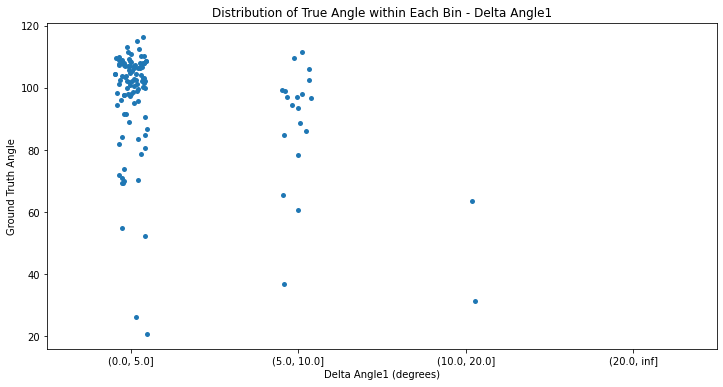

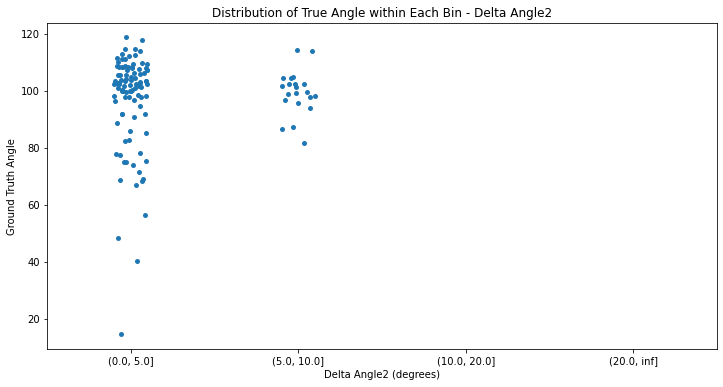

MAE for Angle1: 3.3610849515149033
MAE for Angle2: 3.075623155254256
MAE for all Angles: 3.21835405338458
MSE Point: 8.50563012472762
MSE Angle: 16.190181395476465
MSE Radius: 7.119622813066606
MAPE Point: 0.012406800098306116
MAPE Angle: 0.0368679054311373
MAPE Radius: 0.03788413866573452
R2 Head Left: 0.9946577780375185
R2 Head Right: 0.9977659750924113
R2 Center1: 0.9984643828538642
R2 Center2: 0.9986313605621515
R2 Angle: 0.9434301561779259


In [22]:
df= pd.read_csv('/home/featurize/work/Result/predictions.csv')
# delta_angle

df['Delta Angle1'] = abs(df['Angle1'] - df['Pred Angle1'])
df['Delta Angle2'] = abs(df['Angle2'] - df['Pred Angle2'])

percentage_less_than_1_degree = (
    ((df['Delta Angle1'] < 1).sum() + (df['Delta Angle2'] < 1).sum()) / (2 * len(df))
) * 100

# 计算误差小于5度的百分比
percentage_less_than_5_degrees = (
    ((df['Delta Angle1'] < 5).sum() + (df['Delta Angle2'] < 5).sum()) / (2 * len(df))
) * 100

# 计算误差小于10度的百分比
percentage_less_than_10_degrees = (
    ((df['Delta Angle1'] < 10).sum() + (df['Delta Angle2'] < 10).sum()) / (2 * len(df))
) * 100

print(f"Percentage of angles with less than 1 degree error: {percentage_less_than_1_degree:.2f}%")
print(f"Percentage of angles with less than 5 degrees error: {percentage_less_than_5_degrees:.2f}%")
print(f"Percentage of angles with less than 10 degrees error: {percentage_less_than_10_degrees:.2f}%")

angle1_under_5 = (df['Delta Angle1'] < 5).sum()
angle2_under_5 = (df['Delta Angle2'] < 5).sum()
total_entries = len(df)

percentage_angle1_under_5 = (angle1_under_5 / total_entries) * 100
percentage_angle2_under_5 = (angle2_under_5 / total_entries) * 100

print(f"Percentage of Delta Angle1 < 5: {percentage_angle1_under_5:.2f}%")
print(f"Percentage of Delta Angle2 < 5: {percentage_angle2_under_5:.2f}%")

angle1_under_10 = (df['Delta Angle1'] < 10).sum()
angle2_under_10 = (df['Delta Angle2'] < 10).sum()

percentage_angle1_under_10 = (angle1_under_10 / total_entries) * 100
percentage_angle2_under_10 = (angle2_under_10 / total_entries) * 100

print(f"Percentage of Delta Angle1 < 10: {percentage_angle1_under_10:.2f}%")
print(f"Percentage of Delta Angle2 < 10: {percentage_angle2_under_10:.2f}%")

import seaborn as sns
df['Delta Angle1 Bin'] = pd.cut(df['Delta Angle1'], bins=[0, 5, 10, 20, float('inf')])
df['Delta Angle2 Bin'] = pd.cut(df['Delta Angle2'], bins=[0, 5, 10, 20, float('inf')])

# Delta Angle1
plt.figure(figsize=(12, 6))
sns.stripplot(x='Delta Angle1 Bin', y='Angle1', data=df, jitter=True)
plt.xlabel('Delta Angle1 (degrees)')
plt.ylabel('Ground Truth Angle')
plt.title('Distribution of True Angle within Each Bin - Delta Angle1')
plt.show()

# Delta Angle2
plt.figure(figsize=(12, 6))
sns.stripplot(x='Delta Angle2 Bin', y='Angle2', data=df, jitter=True)
plt.xlabel('Delta Angle2 (degrees)')
plt.ylabel('Ground Truth Angle')
plt.title('Distribution of True Angle within Each Bin - Delta Angle2')
plt.show()

from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error, r2_score,mean_absolute_error

# mae
mae_angle1 = mean_absolute_error(df['Angle1'], df['Pred Angle1'])
mae_angle2 = mean_absolute_error(df['Angle2'], df['Pred Angle2'])
combined_angles_true = df[['Angle1', 'Angle2']].values.flatten()
combined_angles_pred = df[['Pred Angle1', 'Pred Angle2']].values.flatten()
mae_combined_angles = mean_absolute_error(combined_angles_true, combined_angles_pred)




# mse
mse_point = mean_squared_error(df[['Left Head X', 'Left Head Y', 'Right Head X', 'Right Head Y', 'Center1 X', 'Center1 Y', 'Center2 X', 'Center2 Y']],
                               df[['Pred Left Head X', 'Pred Left Head Y', 'Pred Right Head X', 'Pred Right Head Y', 'Pred Center1 X', 'Pred Center1 Y', 'Pred Center2 X', 'Pred Center2 Y']])

mse_angle = mean_squared_error(df[['Angle1', 'Angle2']],
                               df[['Pred Angle1', 'Pred Angle2']])

mse_radius = mean_squared_error(df[['Radius1', 'Radius2']],
                                df[['Pred Radius1', 'Pred Radius2']])

# MAPE
mape_point = mean_absolute_percentage_error(df[['Left Head X', 'Left Head Y', 'Right Head X', 'Right Head Y', 'Center1 X', 'Center1 Y', 'Center2 X', 'Center2 Y']],
                                            df[['Pred Left Head X', 'Pred Left Head Y', 'Pred Right Head X', 'Pred Right Head Y', 'Pred Center1 X', 'Pred Center1 Y', 'Pred Center2 X','Pred Center2 Y']])

mape_angle = mean_absolute_percentage_error(df[['Angle1', 'Angle2']],
                                            df[['Pred Angle1', 'Pred Angle2']])

mape_radius = mean_absolute_percentage_error(df[['Radius1', 'Radius2']],
                                             df[['Pred Radius1', 'Pred Radius2']])

# R2
r2_head_left = r2_score(df[['Left Head X', 'Left Head Y']],
                        df[['Pred Left Head X', 'Pred Left Head Y']])

r2_head_right = r2_score(df[['Right Head X', 'Right Head Y']],
                         df[['Pred Right Head X', 'Pred Right Head Y']])

r2_center1 = r2_score(df[['Center1 X', 'Center1 Y']],
                      df[['Pred Center1 X', 'Pred Center1 Y']])

r2_center2 = r2_score(df[['Center2 X', 'Center2 Y']],
                      df[['Pred Center2 X', 'Pred Center2 Y']])

r2_angle = r2_score(df[['Angle1', 'Angle2']],
                    df[['Pred Angle1', 'Pred Angle2']])

print(f"MAE for Angle1: {mae_angle1}")
print(f"MAE for Angle2: {mae_angle2}")
print(f"MAE for all Angles: {mae_combined_angles}")

print(f"MSE Point: {mse_point}")
print(f"MSE Angle: {mse_angle}")
print(f"MSE Radius: {mse_radius}")
print(f"MAPE Point: {mape_point}")
print(f"MAPE Angle: {mape_angle}")
print(f"MAPE Radius: {mape_radius}")
print(f"R2 Head Left: {r2_head_left}")
print(f"R2 Head Right: {r2_head_right}")
print(f"R2 Center1: {r2_center1}")
print(f"R2 Center2: {r2_center2}")
print(f"R2 Angle: {r2_angle}")

In [26]:
def classify_na(angle):
    if angle >= 105:
        return 'Excellent'
    elif 100 <= angle < 105:
        return 'Good'
    elif 95 <= angle < 100:
        return 'Fair'
    elif 90 <= angle < 95:
        return 'Borderline'
    elif 85 <= angle < 90:
        return 'Mild'
    elif 80 <= angle < 85:
        return 'Moderate'
    elif angle < 80:
        return 'Severe'
    else:
        return 'Unknown'


In [27]:
df['Angle1 Classification'] = df['Angle1'].apply(classify_na)
df['Angle2 Classification'] = df['Angle2'].apply(classify_na)

df['Pred Angle1 Classification'] = df['Pred Angle1'].apply(classify_na)
df['Pred Angle2 Classification'] = df['Pred Angle2'].apply(classify_na)

In [28]:
total_count = len(df)
same_classification_count1 = (df['Angle1 Classification'] == df['Pred Angle1 Classification']).sum()
percentage_same_classification1 = (same_classification_count1 / total_count) * 100

print(f"Percentage of same classification angle1: {percentage_same_classification1:.2f}%")

same_classification_count2 = (df['Angle2 Classification'] == df['Pred Angle2 Classification']).sum()
percentage_same_classification2 = (same_classification_count2 / total_count) * 100

print(f"Percentage of same classification angle2: {percentage_same_classification2:.2f}%")

Percentage of same classification angle1: 62.81%
Percentage of same classification angle2: 58.68%


In [29]:
df1 = df[['Angle1', 'Pred Angle1', 'Angle1 Classification', 'Pred Angle1 Classification']]
df1.to_csv('/home/featurize/work/mmpose/data/predictions_classified.csv', index=False)

In [18]:
output_dir = '/home/featurize/work/Result/Predict'
save_predictions_to_mat(df, output_dir)

Saved predictions to /home/featurize/work/Result/Predict/340563.mat
Saved predictions to /home/featurize/work/Result/Predict/359971.mat
Saved predictions to /home/featurize/work/Result/Predict/328949.mat
Saved predictions to /home/featurize/work/Result/Predict/348742.mat
Saved predictions to /home/featurize/work/Result/Predict/355767.mat
Saved predictions to /home/featurize/work/Result/Predict/353517.mat
Saved predictions to /home/featurize/work/Result/Predict/355524.mat
Saved predictions to /home/featurize/work/Result/Predict/358587.mat
Saved predictions to /home/featurize/work/Result/Predict/355223.mat
Saved predictions to /home/featurize/work/Result/Predict/264113.mat
Saved predictions to /home/featurize/work/Result/Predict/365780.mat
Saved predictions to /home/featurize/work/Result/Predict/360388.mat
Saved predictions to /home/featurize/work/Result/Predict/246775.mat
Saved predictions to /home/featurize/work/Result/Predict/361492.mat
Saved predictions to /home/featurize/work/Result

In [19]:
# read unlabeled dataset
image_dir = '/home/featurize/work/Dataset2/data/July_2024'
conf_thres_center_range = np.arange(0.3, 0.7, 0.05)
conf_thres_head_range = np.arange(0.3, 0.7, 0.05)
output_dir = '/home/featurize/work/Result/July2024'

process_images_and_save(image_dir, detector, detector2, pose_estimator, pose_estimator2, conf_thres_center_range, conf_thres_head_range, output_dir)

In [ ]:
df= pd.read_csv('/home/featurize/work/Result/July2024/predictions_without_gt.csv')
output_dir = '/home/featurize/work/Result/Predict'
save_predictions_to_mat(df, output_dir)

Saved predictions to /home/featurize/work/Result/Predict/151568.mat
Saved predictions to /home/featurize/work/Result/Predict/8L71C4RR.mat
Saved predictions to /home/featurize/work/Result/Predict/2415733.mat
Saved predictions to /home/featurize/work/Result/Predict/FKMMUW55.mat
Saved predictions to /home/featurize/work/Result/Predict/41408.mat
Saved predictions to /home/featurize/work/Result/Predict/41698.mat
Saved predictions to /home/featurize/work/Result/Predict/144104.mat
Saved predictions to /home/featurize/work/Result/Predict/165874.mat
Saved predictions to /home/featurize/work/Result/Predict/155512.mat
Saved predictions to /home/featurize/work/Result/Predict/152268.mat
Saved predictions to /home/featurize/work/Result/Predict/146361.mat
Saved predictions to /home/featurize/work/Result/Predict/CIKG01XX.mat
Saved predictions to /home/featurize/work/Result/Predict/166731.mat
Saved predictions to /home/featurize/work/Result/Predict/IS1.mat
Saved predictions to /home/featurize/work/Resu